![IDAL](https://i.imgur.com/tIKXIG1.jpg)  

#**Máster en Inteligencia Artificial Avanzada y Aplicada:  IA^3**
---

# Construye una GAN con PyTorch

### Objetivo
En este cuaderno, vas a crear tu primera red generativa adversarial (GAN). Específicamente, construirás y entrenarás una GAN que pueda generar imágenes manuscritas de dígitos (0-9). Lo vas hacer con PyTorch por lo que recuerda consultar y teener a mano la [documentación de PyTorch](https://pytorch.org/docs/stable/index.html). Las pistas también incluirán a menudo enlaces a documentación relevante.

### Objetivos de aprendizaje
1.   Construir los componentes generador y discriminador de un GAN desde cero.
2.   Crear las funciones de pérdida del generador y del discriminador.
3.   Entrenar la GAN y visualizar las imágenes generadas.

## Importaciones
Paquetes necesarios, así com una fucnión auxiliar para visualizar las imágenes


In [1]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST # Training dataset
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28)):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in a uniform grid.
    '''
    image_unflat = image_tensor.detach().cpu().view(-1, *size)
    image_grid = make_grid(image_unflat[:num_images], nrow=5)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.show()

/home/vic_263/anaconda3/envs/ia/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


#### MNIST Dataset
Vamos a usar el dataset [MNIST](http://yann.lecun.com/exdb/mnist/). Recuerda que contiene 60,000 imagenes de digitos escritos a mano, del 0 al 9

![MNIST Digits](MnistExamples.png)

Las imágenes están bastante pixeladas, ¡porque todas tienen sólo 28 x 28! El pequeño tamaño de sus imágenes hace que MNIST sea ideal para un entrenamiento sencillo. Además, estas imágenes también están en blanco y negro, por lo que sólo se necesita una dimensión, o **"canal de color"**, para representarlas.

#### Tensores
Como sabes, los datos se representaran usando [tensores](https://pytorch.org/docs/stable/tensors.html) con la librería [PyTorch](https://pytorch.org/).

#### Batches
Como sabemos, podríamos entrenar el modelo después de generar una imagen, pero esto es extremadamente ineficaz y conduce a un entrenamiento menos estable. En los GAN, y en el aprendizaje automático en general, se procesan varias imágenes por paso de entrenamiento. Se denominan lotes (batches).

El generador generará un lote entero de imágenes y recibirá la retroalimentación del discriminador sobre cada lote antes de actualizar el modelo. Lo mismo ocurre con el discriminador, que calculará su pérdida en todo el lote de imágenes generadas, así como en las reales, antes de actualizar el modelo.

## Generador
El primer paso es construir el componente **generador**.

Empezarás creando una función para hacer una sola capa/bloque para la red neuronal del generador. Cada bloque debe incluir una [transformación lineal](https://pytorch.org/docs/stable/generated/torch.nn.Linear.html) para mapear a otra forma, una [batch normalization](https://pytorch.org/docs/stable/generated/torch.nn.BatchNorm1d.html) para estabilización, y finalmente una función de activación no lineal (usas una [ReLU aquí](https://pytorch.org/docs/master/generated/torch.nn.ReLU.html)) para que la salida pueda ser transformada en formas complejas.

In [4]:
# C1: Completa el código donde corresponde:
def get_generator_block(input_dim, output_dim):
    '''
    Function for returning a block of the generator's neural network
    given input and output dimensions.
    Parameters:
        input_dim: the dimension of the input vector, a scalar
        output_dim: the dimension of the output vector, a scalar
    Returns:
        a generator neural network layer, with a linear transformation
          followed by a batch normalization and then a relu activation
    '''
    return nn.Sequential(
        # Hint: Replace all of the "None" with the appropriate dimensions.
        # The documentation may be useful if you're less familiar with PyTorch:
        # https://pytorch.org/docs/stable/nn.html.
        #### START CODE HERE ####
        nn.Linear(input_dim, output_dim),
        nn.BatchNorm1d(output_dim),
        #### END CODE HERE ####
        nn.ReLU(inplace=True),
    )

In [5]:
# Comprobación (NO TOCAR nada, Solo ejecutar)
def test_gen_block(in_features, out_features, num_test=1000):
    block = get_generator_block(in_features, out_features)

    # Check the three parts
    assert len(block) == 3
    assert type(block[0]) == nn.Linear
    assert type(block[1]) == nn.BatchNorm1d
    assert type(block[2]) == nn.ReLU

    # Check the output shape
    test_input = torch.randn(num_test, in_features)
    test_output = block(test_input)
    assert tuple(test_output.shape) == (num_test, out_features)
    assert test_output.std() > 0.55
    assert test_output.std() < 0.65

test_gen_block(25, 12)
test_gen_block(15, 28)
print("Success!")

Success!


Ahora debes construir la clase generador. Tomará 3 valores:

* La dimensión del vector de ruido
* La dimensión de la imagen
* La dimensión oculta inicial

Usando estos valores, el generador construirá una red neuronal con 5 capas/bloques. Comenzando con el vector de ruido, el generador aplicará transformaciones no lineales a través de la función de bloque hasta que el tensor se corresponda con el tamaño de la imagen a mostrar (el mismo tamaño que las imágenes reales de MNIST). Tienes que completar el código de la capa final, ya que es diferente de las demás. La capa final no necesita una función de normalización o activación, pero necesita ser escalada con una [función sigmoide](https://pytorch.org/docs/master/generated/torch.nn.Sigmoid.html).

Por último, se define la función de "forward": paso hacia adelante que toma en un vector de ruido y genera una imagen de la dimensión de salida utilizando su red neuronal.


<details>

<summary>
<font size="3" color="green">
<b>Pistas para el<code><font size="4">Generador</font></code></b>
</font>
</summary>

1. El tamaño de salida de la transformación lineal final debería ser im_dim, pero recuerda que **además** necesitas escalar las salidas entre 0 y 1 usando la función sigmoidea.
2. [nn.Linear](https://pytorch.org/docs/master/generated/torch.nn.Linear.html) and [nn.Sigmoid](https://pytorch.org/docs/master/generated/torch.nn.Sigmoid.html) serán útiles.
</details>


In [6]:
# C2: Completa el código donde corresponde:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        z_dim: the dimension of the noise vector, a scalar
        im_dim: the dimension of the images, fitted for the dataset used, a scalar
          (MNIST images are 28 x 28 = 784 so that is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, z_dim=10, im_dim=784, hidden_dim=128):
        super(Generator, self).__init__()
        # Build the neural network
        self.gen = nn.Sequential(
            get_generator_block(z_dim, hidden_dim),
            get_generator_block(hidden_dim, hidden_dim * 2),
            get_generator_block(hidden_dim * 2, hidden_dim * 4),
            get_generator_block(hidden_dim * 4, hidden_dim * 8),
            # There is a dropdown with hints if you need them!
            #### START CODE HERE ####
            nn.Linear(hidden_dim*8, im_dim),
            nn.Sigmoid()
            #### END CODE HERE ####
        )
    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor,
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, z_dim)
        '''
        return self.gen(noise)

    # Needed for grading
    def get_gen(self):
        '''
        Returns:
            the sequential model
        '''
        return self.gen

In [7]:
# Comprobación (NO TOCAR nada, Solo ejecutar)
def test_generator(z_dim, im_dim, hidden_dim, num_test=10000):
    gen = Generator(z_dim, im_dim, hidden_dim).get_gen()

    # Check there are six modules in the sequential part
    assert len(gen) == 6
    assert str(gen.__getitem__(4)).replace(' ', '') == f'Linear(in_features={hidden_dim * 8},out_features={im_dim},bias=True)'
    assert str(gen.__getitem__(5)).replace(' ', '') == 'Sigmoid()'
    test_input = torch.randn(num_test, z_dim)
    test_output = gen(test_input)

    # Check that the output shape is correct
    assert tuple(test_output.shape) == (num_test, im_dim)
    assert test_output.max() < 1, "Make sure to use a sigmoid"
    assert test_output.min() > 0, "Make sure to use a sigmoid"
    assert test_output.std() > 0.05, "Don't use batchnorm here"
    assert test_output.std() < 0.15, "Don't use batchnorm here"

test_generator(5, 10, 20)
test_generator(20, 8, 24)
print("Success!")

Success!


## Ruido
Para poder utilizar su generador, necesitas poder crear **vectores de ruido**. El vector de ruido z tiene el importante papel de asegurar que las imágenes generadas a partir de la misma clase no tengan todas el mismo aspecto -- piensa en él como una semilla aleatoria. Lo generaremos aleatoriamente usando PyTorch muestreando números aleatorios de la distribución normal. Como se procesarán múltiples imágenes por pasada, generarás todos los vectores de ruido a la vez.

Ten en cuenta que siempre que creas un nuevo tensor usando torch.ones, torch.zeros, o torch.randn, necesitarás crearlo en el dispositivo de destino, por ejemplo `torch.ones(3, 3, device=dispositivo)`, o moverlo al dispositivo de destino usando `torch.ones(3, 3).to(dispositivo)`. No es necesario que hagas esto si estás creando un tensor manipulando otro tensor o utilizando una variación que asigna por defecto el dispositivo a la entrada, como `torch.ones_like`. En general, **utiliza** `torch.ones_like` y `torch.zeros_like` en lugar de `torch.ones` o `torch.zeros` siempre que sea posible.
<details>

<summary>
<font size="3" color="green">
<b>Pista opcional para<code><font size="4">get_noise</font></code></b>
</font>
</summary>

1.
Puede que encuentres [torch.randn](https://pytorch.org/docs/master/generated/torch.randn.html) útil para esta función.
</details>

In [8]:
# C3: Completa el código donde corresponde:
def get_noise(n_samples, z_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, z_dim),
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
        n_samples: the number of samples to generate, a scalar
        z_dim: the dimension of the noise vector, a scalar
        device: the device type
    '''
    # NOTE: To use this on GPU with device='cuda', make sure to pass the device
    # argument to the function you use to generate the noise.
    #### START CODE HERE ####
    return torch.randn(n_samples, z_dim, device=device)
    #### END CODE HERE ####

In [12]:
# Comprobación (NO TOCAR nada, Solo ejecutar)
def test_get_noise(n_samples, z_dim, device='cpu'):
    noise = get_noise(n_samples, z_dim, device)

    # Make sure a normal distribution was used
    assert tuple(noise.shape) == (n_samples, z_dim)
    assert torch.abs(noise.std() - torch.tensor(1.0)) < 0.01
    assert str(noise.device).startswith(device)

test_get_noise(1000, 100, 'cpu')
if torch.cuda.is_available():
    test_get_noise(1000, 32, 'cuda')
print("Success!")

Success!


## Discriminador
El segundo componente que hay que construir es el **discriminador**. Al igual que con el componente generador, empezarás creando una función que construya un bloque de red neuronal para el discriminador.

*Nota: Se utilizan Leaky ReLUs para evitar el problema del "dying ReLU", que se refiere al fenómeno en el que los parámetros dejan de cambiar debido a los valores negativos pasados a un ReLU, lo que resulta en un gradiente cero.



In [10]:
# C4: Completa el código donde corresponde:
def get_discriminator_block(input_dim, output_dim):
    '''
    Discriminator Block
    Function for returning a neural network of the discriminator given input and output dimensions.
    Parameters:
        input_dim: the dimension of the input vector, a scalar
        output_dim: the dimension of the output vector, a scalar
    Returns:
        a discriminator neural network layer, with a linear transformation
          followed by an nn.LeakyReLU activation with negative slope of 0.2
          (https://pytorch.org/docs/master/generated/torch.nn.LeakyReLU.html)
    '''
    return nn.Sequential(
        #### START CODE HERE ####
        nn.Linear(input_dim, output_dim),
        nn.LeakyReLU(0.2, inplace=True)
        #### END CODE HERE ####
    )

In [11]:
# Comprobación (NO TOCAR nada, Solo ejecutar)
def test_disc_block(in_features, out_features, num_test=10000):
    block = get_discriminator_block(in_features, out_features)

    # Check there are two parts
    assert len(block) == 2
    test_input = torch.randn(num_test, in_features)
    test_output = block(test_input)

    # Check that the shape is right
    assert tuple(test_output.shape) == (num_test, out_features)

    # Check that the LeakyReLU slope is about 0.2
    assert -test_output.min() / test_output.max() > 0.1
    assert -test_output.min() / test_output.max() < 0.3
    assert test_output.std() > 0.3
    assert test_output.std() < 0.5

    assert str(block.__getitem__(0)).replace(' ', '') == f'Linear(in_features={in_features},out_features={out_features},bias=True)'
    assert str(block.__getitem__(1)).replace(' ', '').replace(',inplace=True', '') == 'LeakyReLU(negative_slope=0.2)'


test_disc_block(25, 12)
test_disc_block(15, 28)
print("Success!")

Success!


Ahora puedes utilizar estos bloques para crear un discriminador completo. La clase discriminador contiene 2 valores:

* La dimensión de la imagen
* La dimensión oculta

El discriminador construirá una red neuronal con 4 capas. Comenzará con el tensor de la imagen y lo transformará hasta que devuelva un único número (tensor de 1 dimensión) de salida. Esta salida clasifica si una imagen es falsa o real. Ten en cuenta que **no necesita** un sigmoide después de la capa de salida, ya que está incluido en la función de pérdida. Por último, para utilizar la red neuronal de su discriminador se define la función de paso hacia adelante (forward) que toma en un tensor de imagen para ser clasificado.

In [13]:
# C5: Completa el código donde corresponde:
class Discriminator(nn.Module):
    '''
    Discriminator Class
    Values:
        im_dim: the dimension of the images, fitted for the dataset used, a scalar
            (MNIST images are 28x28 = 784 so that is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_dim=784, hidden_dim=128):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            get_discriminator_block(im_dim, hidden_dim * 4),
            get_discriminator_block(hidden_dim * 4, hidden_dim * 2),
            get_discriminator_block(hidden_dim * 2, hidden_dim),
            # Hint: You want to transform the final output into a single value,
            #       so add one more linear map.
            #### START CODE HERE ####
            nn.Linear(hidden_dim, 1)
            #### END CODE HERE ####
        )

    def forward(self, image):
        '''
        Function for completing a forward pass of the discriminator: Given an image tensor,
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_dim)
        '''
        return self.disc(image)

    # Needed for grading
    def get_disc(self):
        '''
        Returns:
            the sequential model
        '''
        return self.disc

In [14]:
# Comprobación (NO TOCAR nada, Solo ejecutar)
def test_discriminator(z_dim, hidden_dim, num_test=100):

    disc = Discriminator(z_dim, hidden_dim).get_disc()

    # Check there are three parts
    assert len(disc) == 4
    assert type(disc.__getitem__(3)) == nn.Linear

    # Check the linear layer is correct
    test_input = torch.randn(num_test, z_dim)
    test_output = disc(test_input)
    assert tuple(test_output.shape) == (num_test, 1)

test_discriminator(5, 10)
test_discriminator(20, 8)
print("Success!")

Success!


## Entrenamiento
¡Ahora ya puedes montarlo todo!
Configuración de parámetros:
  * Criterio: la función de pérdida
  * n_epochs: el número de veces que se itera a través de todo el conjunto de datos durante el entrenamiento
  * z_dim: la dimensión del vector de ruido
  * display_step: frecuencia de visualización de las imágenes
  * batch_size: número de imágenes por pasada hacia delante/hacia atrás
  * lr: la tasa de aprendizaje
  * device: el tipo de dispositivo, aquí se utiliza una GPU (que ejecuta CUDA), no una CPU.

A continuación, cargaremos el conjunto de datos MNIST como tensores utilizando un cargador de datos (dataloader).



In [15]:
# Set your parameters
criterion = nn.BCEWithLogitsLoss()
n_epochs = 200
z_dim = 64
display_step = 500
batch_size = 128
lr = 0.00001
device = 'cuda'
# Load MNIST dataset as tensors
dataloader = DataLoader(
    MNIST('.', download=True, transform=transforms.ToTensor()),
    batch_size=batch_size,
    shuffle=True)

Failed to download (trying next):
HTTP Error 403: Forbidden



100%|██████████| 9912422/9912422 [00:21<00:00, 465468.44it/s] 


Extracting ./MNIST/raw/train-images-idx3-ubyte.gz to ./MNIST/raw

Failed to download (trying next):
HTTP Error 403: Forbidden



100%|██████████| 28881/28881 [00:00<00:00, 160768.93it/s]


Extracting ./MNIST/raw/train-labels-idx1-ubyte.gz to ./MNIST/raw

Failed to download (trying next):
HTTP Error 403: Forbidden



100%|██████████| 1648877/1648877 [00:01<00:00, 1098395.87it/s]


Extracting ./MNIST/raw/t10k-images-idx3-ubyte.gz to ./MNIST/raw

Failed to download (trying next):
HTTP Error 403: Forbidden



100%|██████████| 4542/4542 [00:00<00:00, 2860010.32it/s]

Extracting ./MNIST/raw/t10k-labels-idx1-ubyte.gz to ./MNIST/raw



Ahora, hay que inicializar su generador, discriminador y optimizadores. Ten en cuenta que cada optimizador sólo toma los parámetros de un modelo en particular, ya que queremos que cada optimizador optimice sólo uno de los modelos.

In [16]:
gen = Generator(z_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator().to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

Antes de entrenar la GAN, vamos a crear funciones para calcular la pérdida del discriminador y la pérdida del generador. Así es como el discriminador y el generador sabrán cómo lo están haciendo y se mejorarán a sí mismos. Dado que el generador es necesario para calcular la pérdida del discriminador, tendrá que llamar a **.detach()** en el resultado del generador para asegurarse de que sólo se actualiza el discriminador.

(Recuerde que ya has definido una función de pérdida anteriormente (`criterio`) y se invita a utilizar `torch.ones_like` y `torch.zeros_like` en lugar de `torch.ones` o `torch.zeros`. Si usas `torch.ones` o `torch.zeros`, tendrás que pasarles `device=device`.)

In [17]:
# C6: Completa el código donde corresponde:
def get_disc_loss(gen, disc, criterion, real, num_images, z_dim, device):
    '''
    Return the loss of the discriminator given inputs.
    Parameters:
        gen: the generator model, which returns an image given z-dimensional noise
        disc: the discriminator model, which returns a single-dimensional prediction of real/fake
        criterion: the loss function, which should be used to compare
               the discriminator's predictions to the ground truth reality of the images
               (e.g. fake = 0, real = 1)
        real: a batch of real images
        num_images: the number of images the generator should produce,
                which is also the length of the real images
        z_dim: the dimension of the noise vector, a scalar
        device: the device type
    Returns:
        disc_loss: a torch scalar loss value for the current batch
    '''
    #     These are the steps you will need to complete:
    #       1) Create noise vectors and generate a batch (num_images) of fake images.
    #            Make sure to pass the device argument to the noise.
    #       2) Get the discriminator's prediction of the fake image
    #            and calculate the loss. Don't forget to detach the generator!
    #            (Remember the loss function you set earlier -- criterion. You need a
    #            'ground truth' tensor in order to calculate the loss.
    #            For example, a ground truth tensor for a fake image is all zeros.)
    #       3) Get the discriminator's prediction of the real image and calculate the loss.
    #       4) Calculate the discriminator's loss by averaging the real and fake loss
    #            and set it to disc_loss.
    #     *Important*: You should NOT write your own loss function here - use criterion(pred, true)!
    #### START CODE HERE ####
    fake_noise = get_noise(num_images, z_dim, device=device)
    fake = gen(fake_noise)
    disc_fake_pred = disc(fake.detach())
    disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
    disc_real_pred = disc(real)
    disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
    disc_loss = (disc_fake_loss + disc_real_loss) / 2
    #### END CODE HERE ####
    return disc_loss

In [18]:
# Verificación (NO TOCAR nada, Solo ejecutar)
def test_disc_reasonable(num_images=10):
    z_dim = 64
    gen = torch.zeros_like
    disc = nn.Identity()
    criterion = torch.mul # Multiply
    real = torch.ones(num_images, 1)
    disc_loss = get_disc_loss(gen, disc, criterion, real, num_images, z_dim, 'cpu')
    assert tuple(disc_loss.shape) == (num_images, z_dim)
    assert torch.all(torch.abs(disc_loss - 0.5) < 1e-5)

    gen = torch.ones_like
    disc = nn.Identity()
    criterion = torch.mul # Multiply
    real = torch.zeros(num_images, 1)
    assert torch.all(torch.abs(get_disc_loss(gen, disc, criterion, real, num_images, z_dim, 'cpu')) < 1e-5)

def test_disc_loss(max_tests = 10):
    z_dim = 64
    gen = Generator(z_dim).to(device)
    gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
    disc = Discriminator().to(device)
    disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)
    num_steps = 0
    for real, _ in dataloader:
        cur_batch_size = len(real)
        real = real.view(cur_batch_size, -1).to(device)

        ### Update discriminator ###
        # Zero out the gradient before backpropagation
        disc_opt.zero_grad()

        # Calculate discriminator loss
        disc_loss = get_disc_loss(gen, disc, criterion, real, cur_batch_size, z_dim, device)
        assert (disc_loss - 0.68).abs() < 0.05

        # Update gradients
        disc_loss.backward(retain_graph=True)

        # Check that they detached correctly
        assert gen.gen[0][0].weight.grad is None

        # Update optimizer
        old_weight = disc.disc[0][0].weight.data.clone()
        disc_opt.step()
        new_weight = disc.disc[0][0].weight.data

        # Check that some discriminator weights changed
        assert not torch.all(torch.eq(old_weight, new_weight))
        num_steps += 1
        if num_steps >= max_tests:
            break

test_disc_reasonable()
test_disc_loss()
print("Success!")

Success!


In [19]:
# C7: Completa el código donde corresponde:
def get_gen_loss(gen, disc, criterion, num_images, z_dim, device):
    '''
    Return the loss of the generator given inputs.
    Parameters:
        gen: the generator model, which returns an image given z-dimensional noise
        disc: the discriminator model, which returns a single-dimensional prediction of real/fake
        criterion: the loss function, which should be used to compare
               the discriminator's predictions to the ground truth reality of the images
               (e.g. fake = 0, real = 1)
        num_images: the number of images the generator should produce,
                which is also the length of the real images
        z_dim: the dimension of the noise vector, a scalar
        device: the device type
    Returns:
        gen_loss: a torch scalar loss value for the current batch
    '''
    #     These are the steps you will need to complete:
    #       1) Create noise vectors and generate a batch of fake images.
    #           Remember to pass the device argument to the get_noise function.
    #       2) Get the discriminator's prediction of the fake image.
    #       3) Calculate the generator's loss. Remember the generator wants
    #          the discriminator to think that its fake images are real
    #     *Important*: You should NOT write your own loss function here - use criterion(pred, true)!

    #### START CODE HERE ####
    fake_noise = get_noise(num_images, z_dim, device=device)
    fake = gen(fake_noise)
    disc_fake_pred = disc(fake)
    gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
    #### END CODE HERE ####
    return gen_loss

In [20]:
# Verificación (NO TOCAR nada, Solo ejecutar)
def test_gen_reasonable(num_images=10):
    z_dim = 64
    gen = torch.zeros_like
    disc = nn.Identity()
    criterion = torch.mul # Multiply
    gen_loss_tensor = get_gen_loss(gen, disc, criterion, num_images, z_dim, 'cpu')
    assert torch.all(torch.abs(gen_loss_tensor) < 1e-5)
    #Verify shape. Related to gen_noise parametrization
    assert tuple(gen_loss_tensor.shape) == (num_images, z_dim)

    gen = torch.ones_like
    disc = nn.Identity()
    criterion = torch.mul # Multiply
    real = torch.zeros(num_images, 1)
    gen_loss_tensor = get_gen_loss(gen, disc, criterion, num_images, z_dim, 'cpu')
    assert torch.all(torch.abs(gen_loss_tensor - 1) < 1e-5)
    #Verify shape. Related to gen_noise parametrization
    assert tuple(gen_loss_tensor.shape) == (num_images, z_dim)


def test_gen_loss(num_images):
    z_dim = 64
    gen = Generator(z_dim).to(device)
    gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
    disc = Discriminator().to(device)
    disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

    gen_loss = get_gen_loss(gen, disc, criterion, num_images, z_dim, device)

    # Check that the loss is reasonable
    assert (gen_loss - 0.7).abs() < 0.1
    gen_loss.backward()
    old_weight = gen.gen[0][0].weight.clone()
    gen_opt.step()
    new_weight = gen.gen[0][0].weight
    assert not torch.all(torch.eq(old_weight, new_weight))


test_gen_reasonable(10)
test_gen_loss(18)
print("Success!")

Success!


Por último, ¡puedes juntarlo todo! Como ya sabemos:
+ para cada época, procesará el conjunto de datos por lotes.
+ para cada lote, tendrá que actualizar el discriminador y el generador utilizando sus pérdidas. Recuerda que los lotes son conjuntos de imágenes que se predecirán antes de calcular las funciones de pérdida (en lugar de calcular la función de pérdida después de cada imagen).
+ puedes ver que la pérdida es mayor que 1, esto está bien ya que la pérdida de entropía cruzada binaria puede ser cualquier número positivo para una predicción errónea suficientemente segura.

También es frecuente que el discriminador supere al generador, especialmente al principio, porque su trabajo es más fácil. Es importante que **ninguno de los dos sea demasiado bueno** (es decir, que tenga una precisión casi perfecta), lo que provocaría que todo el modelo dejara de aprender. Equilibrar los dos modelos es en realidad muy difícil de hacer en un GAN estándar y algo que verás más en las clases y tareas posteriores.

Mo esperes nada espectacular: ésta es sólo una primera red sencilla. Los resultados pueden mejorar con arquitecturas más avanzadas y técnicas que ayuden a mantener el generador y discriminador en niveles similares.


(A paesar de la sencillez, puede que tengas que estperar para ver la progresión. En una GPU, esto debería tomar alrededor de 15 segundos por 500 pasos, en promedio, mientras que en la CPU se tardará aproximadamente 1,5 minutos)

  6%|▋         | 30/469 [00:00<00:10, 42.86it/s]

Step 500: Generator loss: 1.548281034588813, discriminator loss: 0.40265837675333044


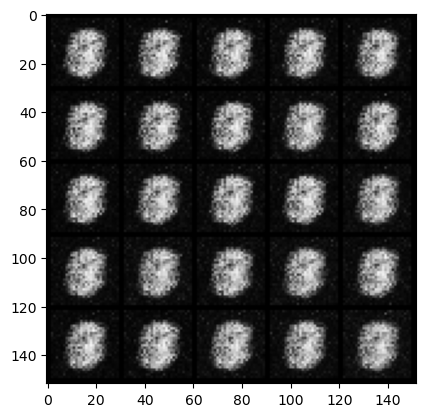

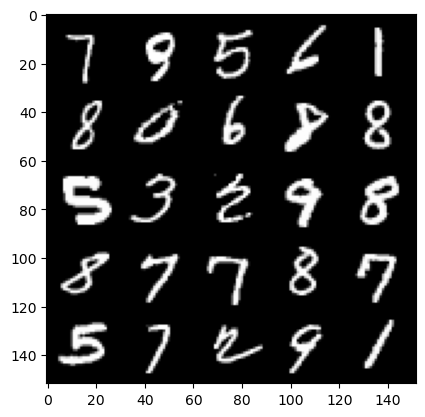

 13%|█▎        | 59/469 [00:01<00:09, 42.93it/s]

Step 1000: Generator loss: 1.8734626834392545, discriminator loss: 0.25751424664258943


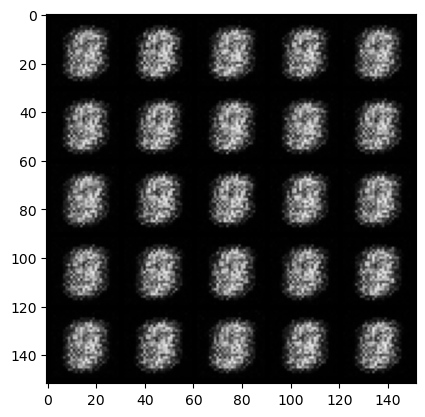

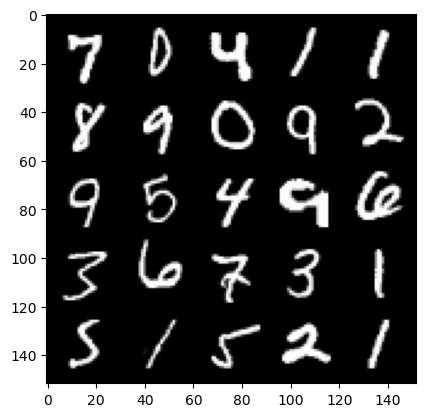

 19%|█▉        | 90/469 [00:02<00:08, 43.12it/s]

Step 1500: Generator loss: 2.1616240932941446, discriminator loss: 0.15137650191783902


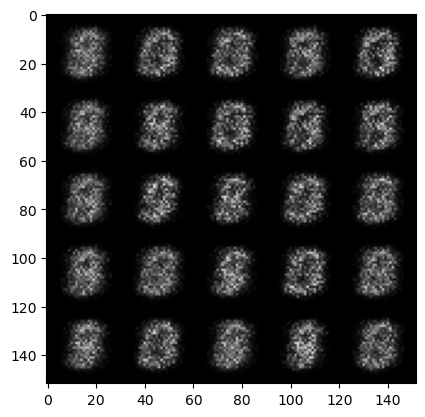

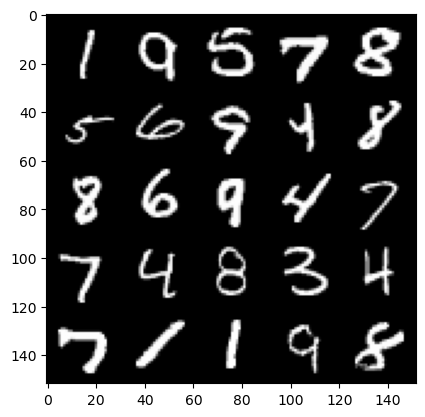

 26%|██▌       | 120/469 [00:02<00:08, 43.20it/s]

Step 2000: Generator loss: 1.7683094594478606, discriminator loss: 0.2087655035257342


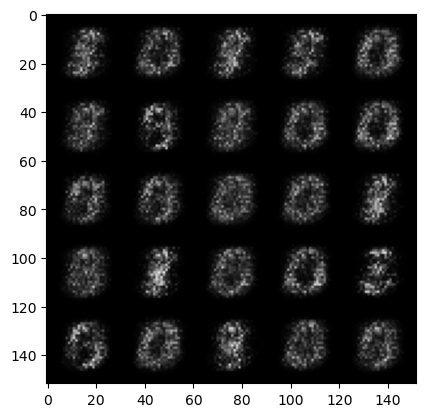

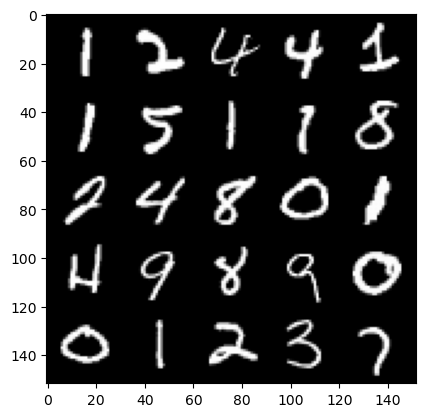

 33%|███▎      | 154/469 [00:04<00:08, 35.43it/s]

Step 2500: Generator loss: 1.6406482901573174, discriminator loss: 0.22590964764356622


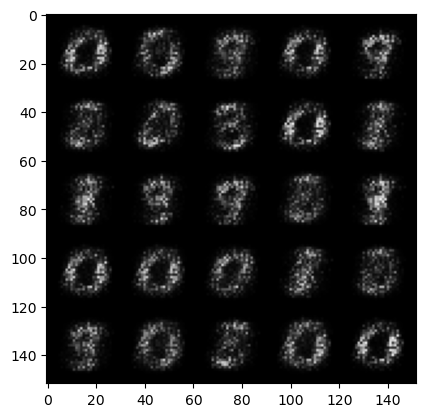

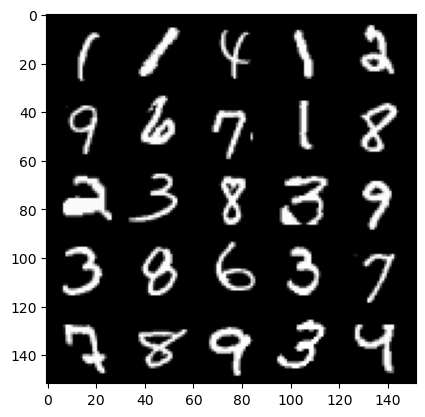

 39%|███▉      | 183/469 [00:05<00:08, 33.89it/s]

Step 3000: Generator loss: 1.903685219287873, discriminator loss: 0.17583424845337858


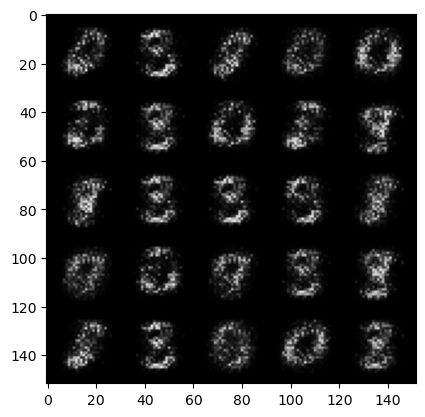

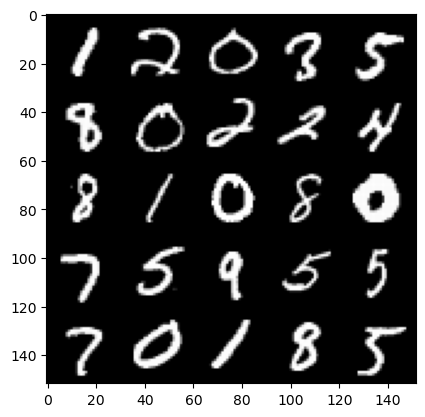

 46%|████▌     | 216/469 [00:05<00:06, 39.53it/s]

Step 3500: Generator loss: 2.3989557342529304, discriminator loss: 0.12527437131106864


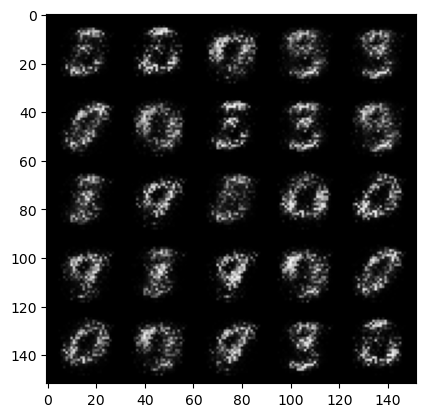

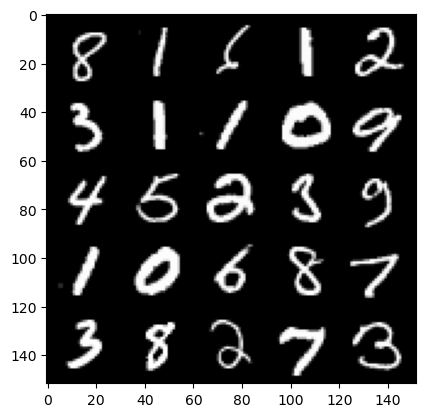

 53%|█████▎    | 247/469 [00:06<00:05, 39.42it/s]

Step 4000: Generator loss: 2.739042597770696, discriminator loss: 0.12059216651320456


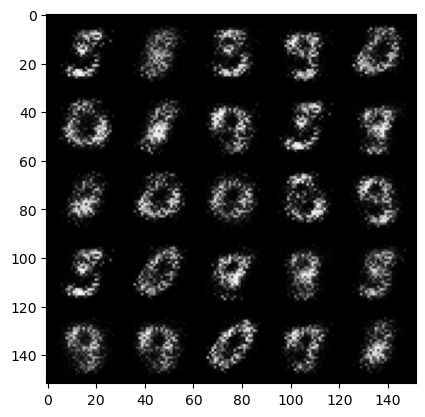

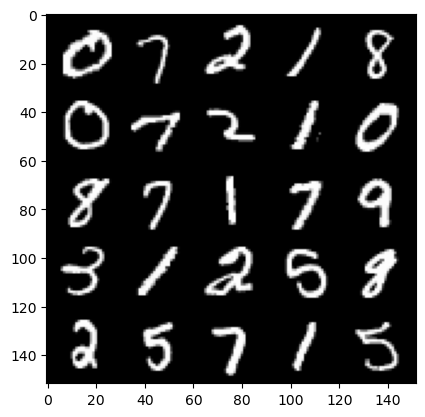

 59%|█████▉    | 278/469 [00:07<00:06, 29.52it/s]

Step 4500: Generator loss: 3.0201825933456417, discriminator loss: 0.10621529108285904


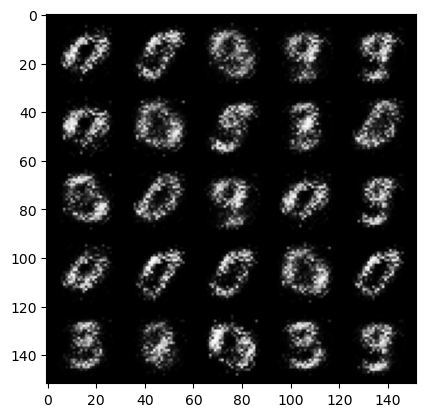

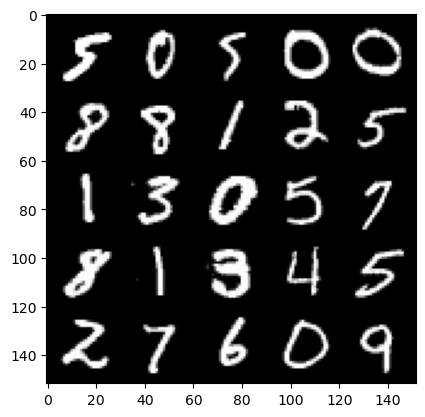

 66%|██████▌   | 308/469 [00:08<00:04, 33.74it/s]

Step 5000: Generator loss: 3.3498989090919498, discriminator loss: 0.07725600004941229


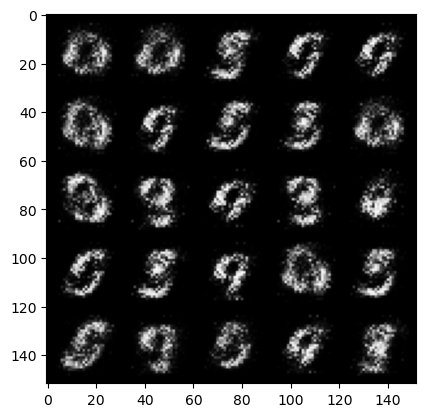

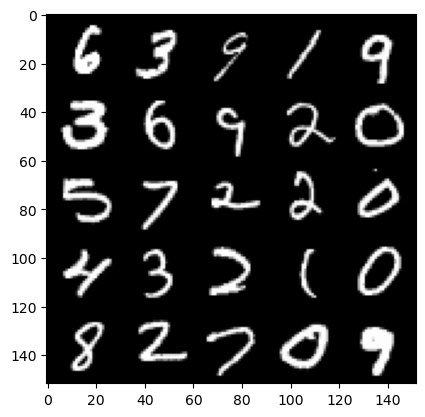

 73%|███████▎  | 341/469 [00:09<00:03, 39.10it/s]

Step 5500: Generator loss: 3.596076207637787, discriminator loss: 0.06527392794191843


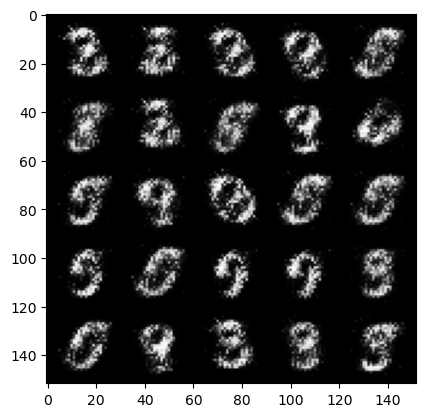

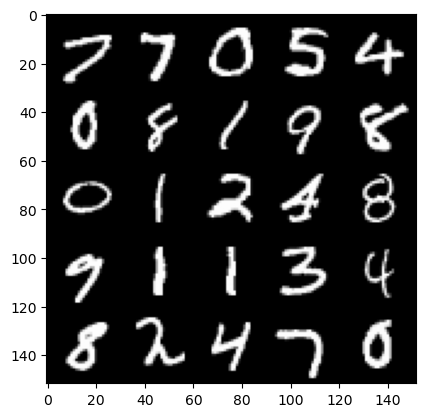

 79%|███████▉  | 370/469 [00:09<00:02, 40.14it/s]

Step 6000: Generator loss: 3.888367681026454, discriminator loss: 0.057602224573493004


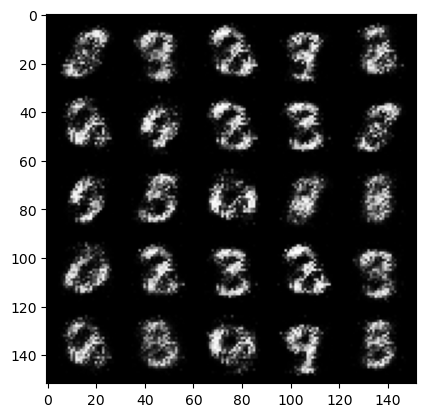

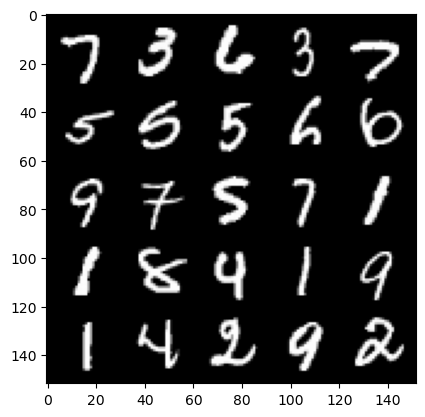

 86%|████████▌ | 403/469 [00:10<00:01, 38.50it/s]

Step 6500: Generator loss: 4.0739053068160995, discriminator loss: 0.0529046424850821


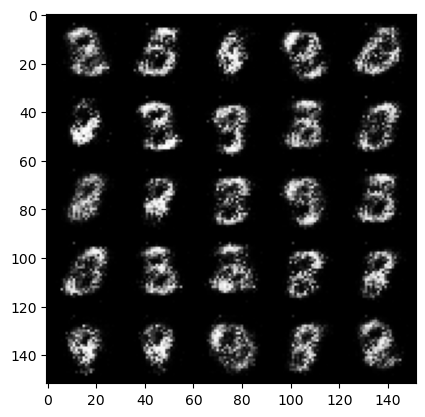

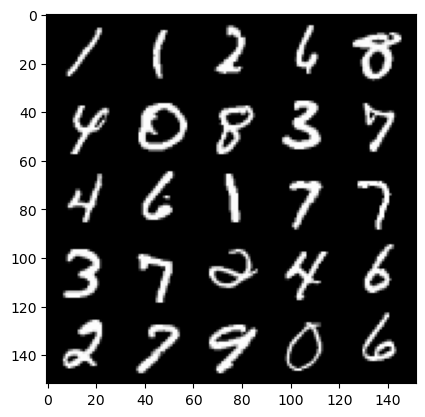

 92%|█████████▏| 431/469 [00:11<00:01, 37.60it/s]

Step 7000: Generator loss: 4.092655695915222, discriminator loss: 0.0600118016526103


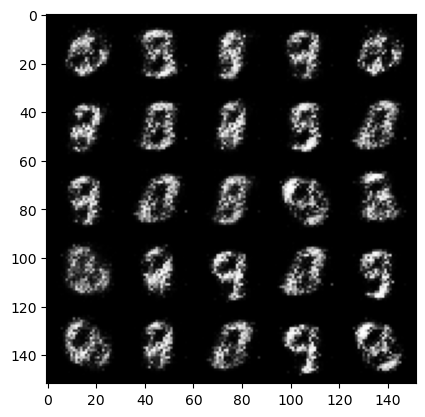

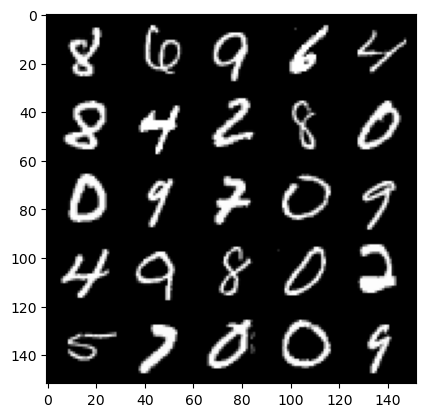

 98%|█████████▊| 461/469 [00:12<00:00, 41.56it/s]

Step 7500: Generator loss: 3.9950607075691256, discriminator loss: 0.06222375634312628


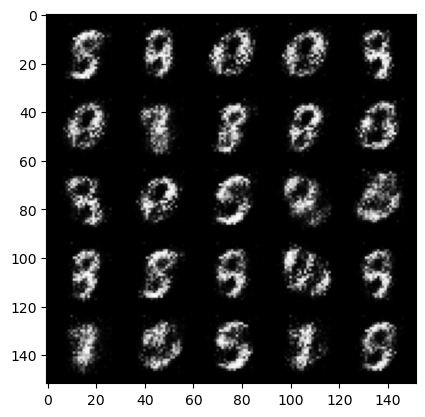

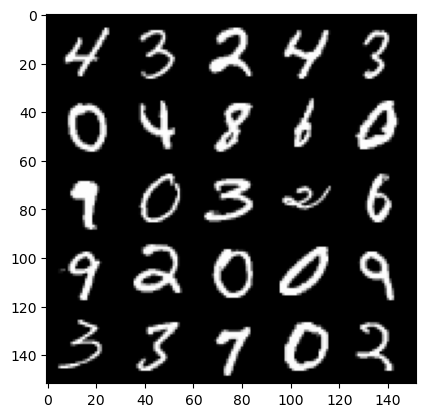

  6%|▌         | 27/469 [00:00<00:12, 34.87it/s]

Step 8000: Generator loss: 4.101500092029572, discriminator loss: 0.060498427696526046


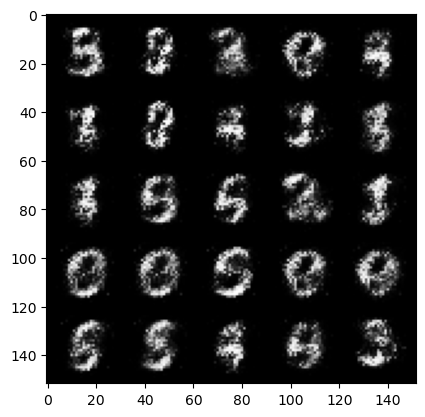

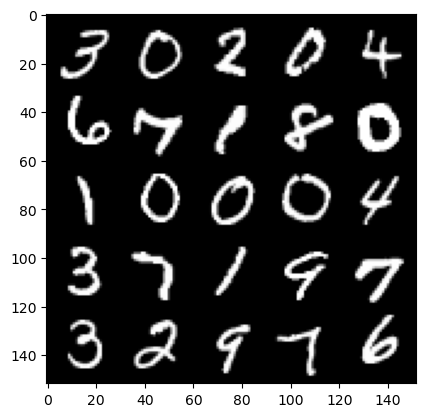

 12%|█▏        | 57/469 [00:01<00:10, 39.33it/s]

Step 8500: Generator loss: 3.932574348926543, discriminator loss: 0.06812249252200132


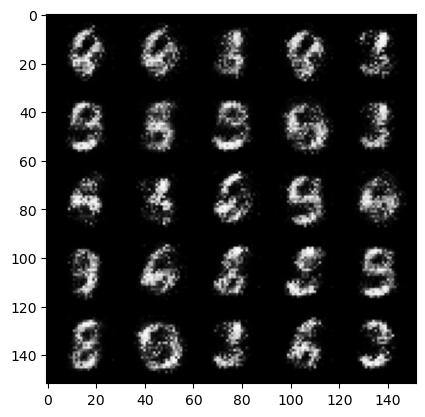

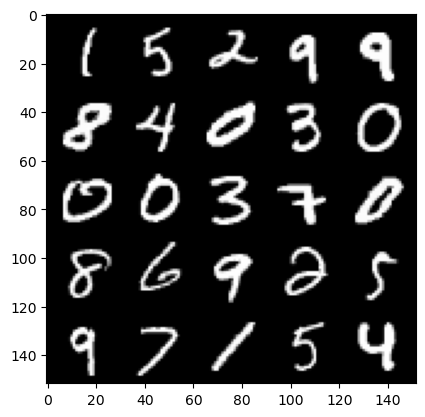

 19%|█▉        | 89/469 [00:02<00:09, 39.97it/s]

Step 9000: Generator loss: 3.9096716942787175, discriminator loss: 0.0701942879334093


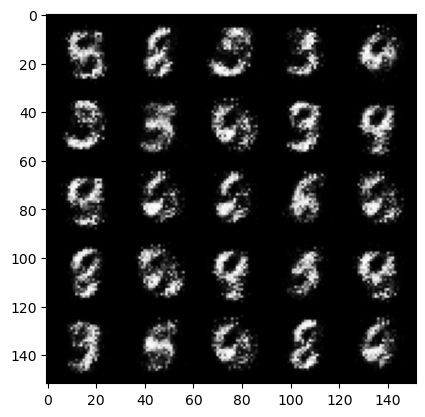

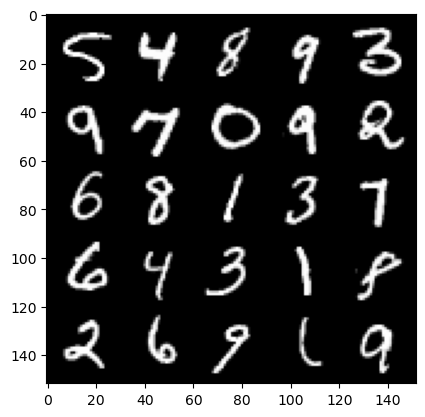

 25%|██▌       | 118/469 [00:02<00:08, 42.67it/s]

Step 9500: Generator loss: 4.011421598911287, discriminator loss: 0.06335730933398004


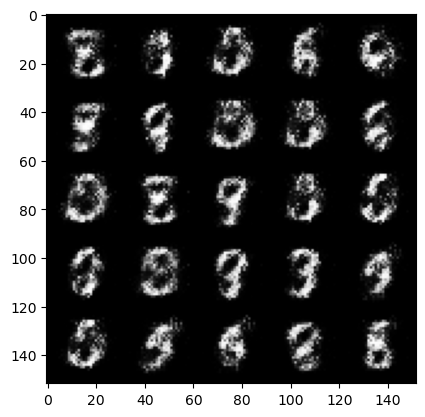

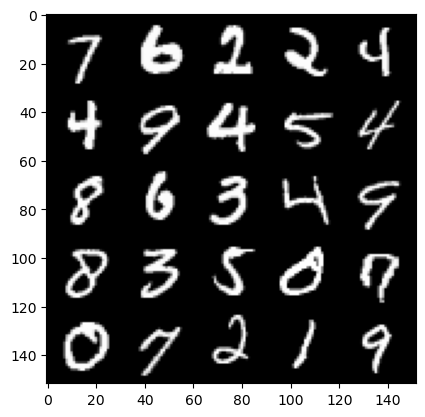

 32%|███▏      | 148/469 [00:04<00:08, 38.05it/s]

Step 10000: Generator loss: 3.815483572006224, discriminator loss: 0.07593377576023343


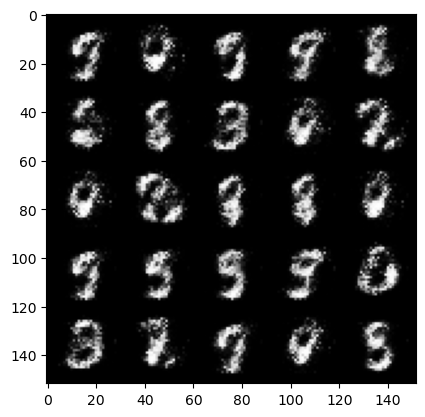

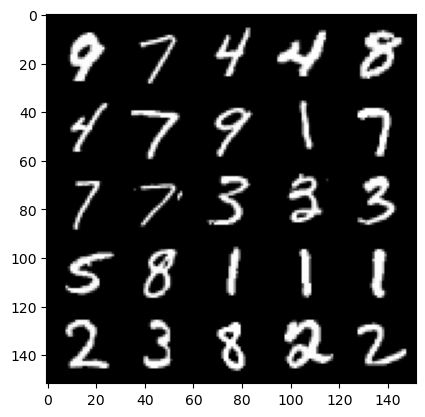

 38%|███▊      | 180/469 [00:04<00:06, 43.50it/s]

Step 10500: Generator loss: 3.8246350893974315, discriminator loss: 0.08073264762759215


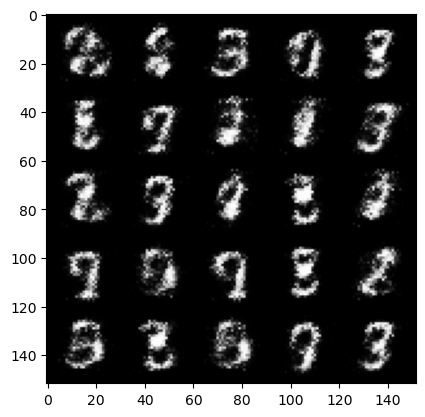

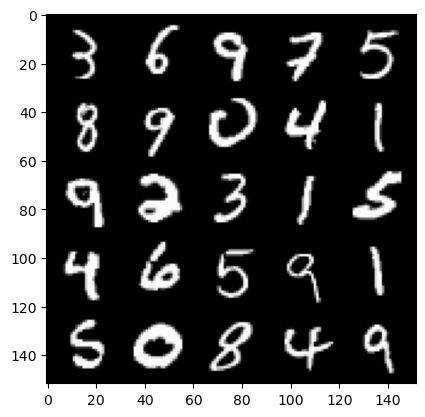

 45%|████▍     | 210/469 [00:04<00:05, 43.96it/s]

Step 11000: Generator loss: 3.9422943181991608, discriminator loss: 0.06770014615356924


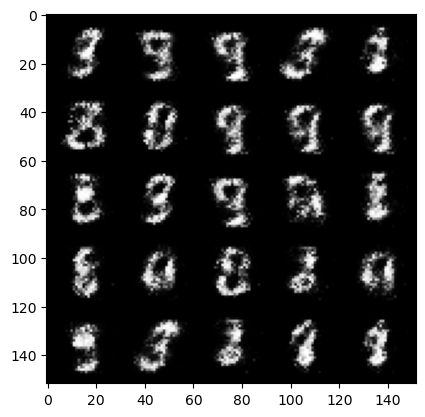

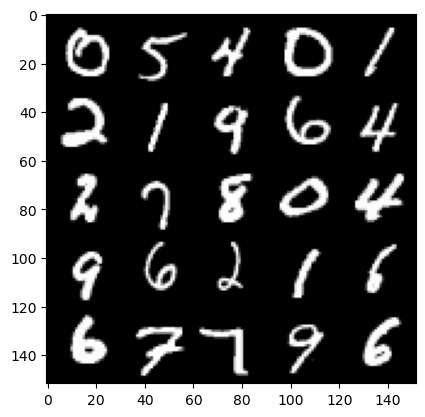

 51%|█████     | 240/469 [00:05<00:05, 42.51it/s]

Step 11500: Generator loss: 3.9988673276901263, discriminator loss: 0.07265946034342045


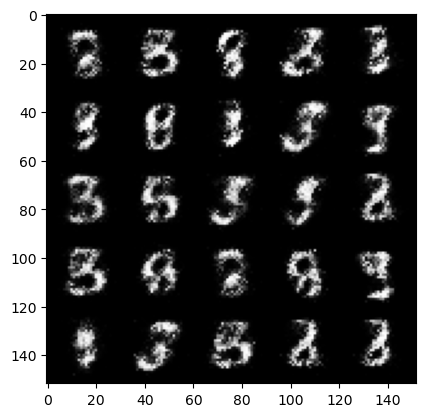

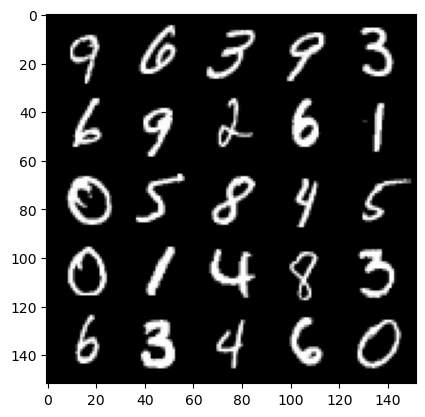

 59%|█████▊    | 275/469 [00:06<00:04, 43.39it/s]

Step 12000: Generator loss: 4.084045629501343, discriminator loss: 0.07893992603570228


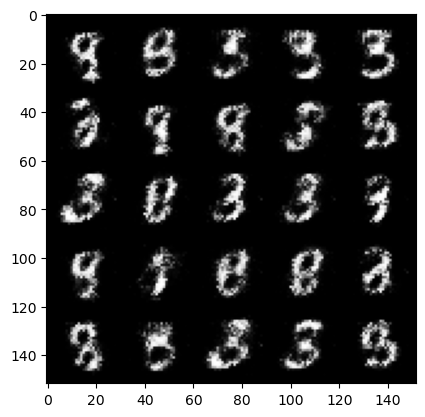

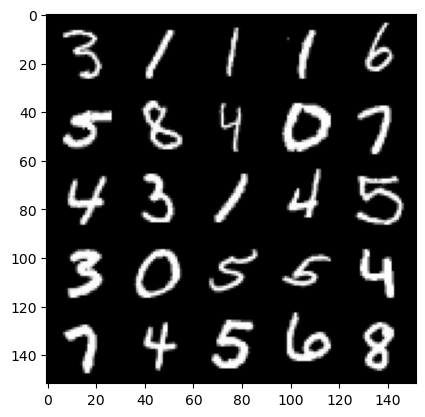

 65%|██████▌   | 306/469 [00:07<00:03, 43.18it/s]

Step 12500: Generator loss: 4.003888945102692, discriminator loss: 0.0806573962643742


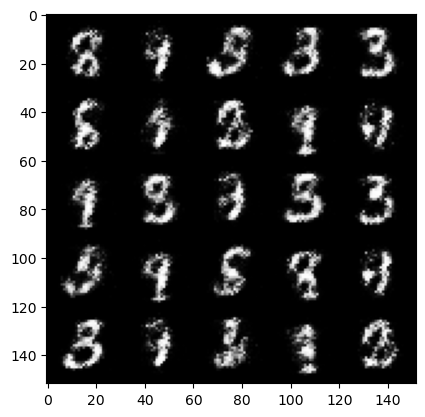

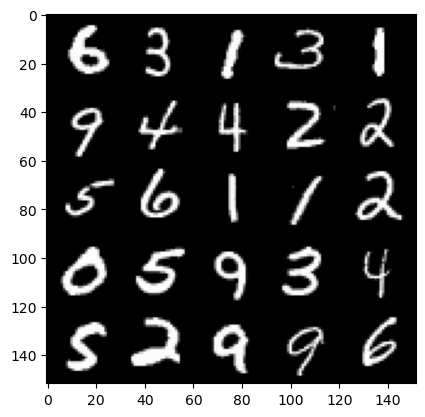

 71%|███████▏  | 335/469 [00:07<00:03, 43.25it/s]

Step 13000: Generator loss: 3.8666397523879974, discriminator loss: 0.088702502258122


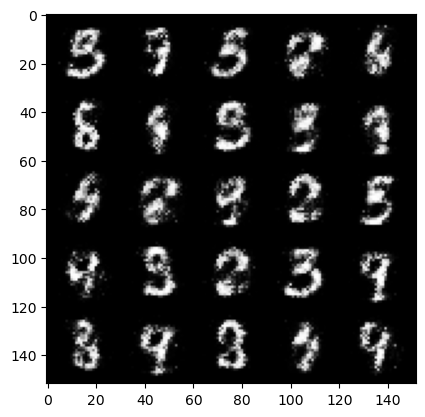

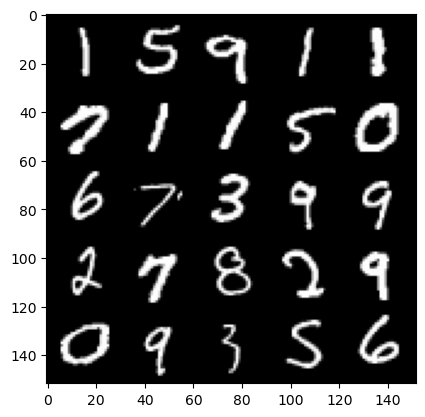

 78%|███████▊  | 365/469 [00:08<00:02, 41.95it/s]

Step 13500: Generator loss: 3.8703420872688294, discriminator loss: 0.09018903045356273


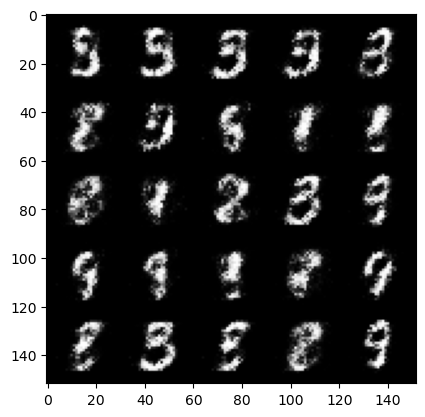

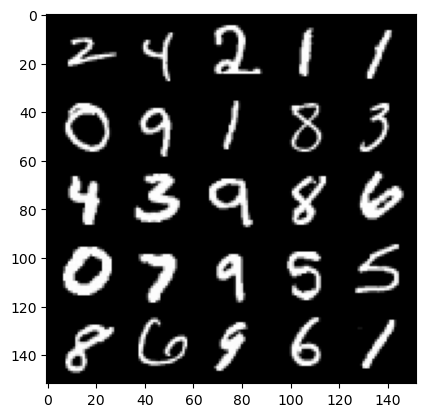

 85%|████████▍ | 398/469 [00:09<00:01, 40.72it/s]

Step 14000: Generator loss: 3.8097914419174193, discriminator loss: 0.09498086883127688


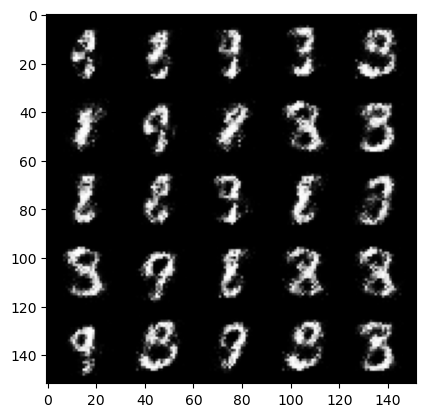

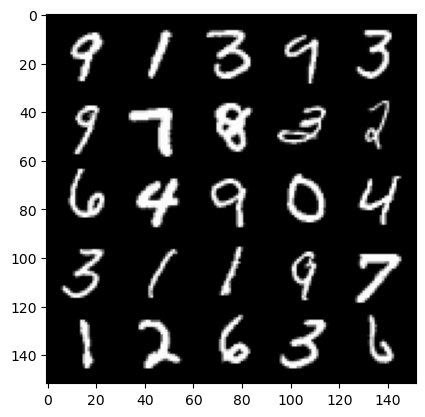

 91%|█████████▏| 429/469 [00:10<00:00, 43.02it/s]

Step 14500: Generator loss: 3.714447474479675, discriminator loss: 0.10336695434153077


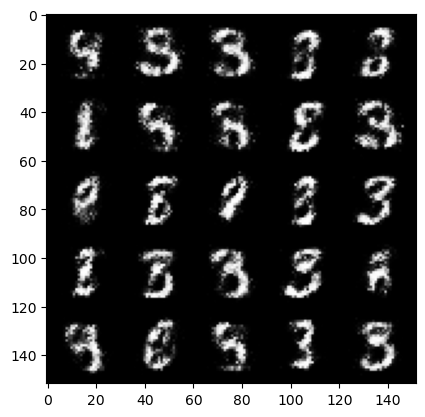

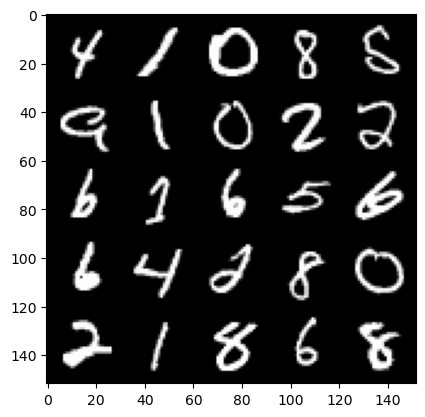

 98%|█████████▊| 460/469 [00:10<00:00, 42.82it/s]

Step 15000: Generator loss: 3.726512321949007, discriminator loss: 0.11086676374822858


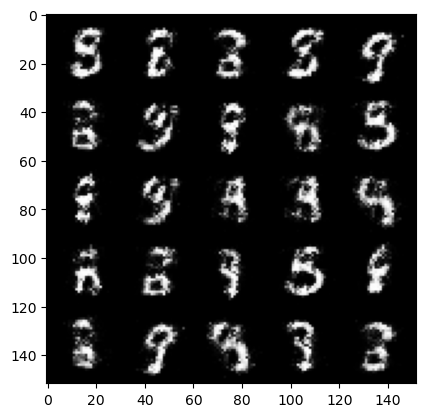

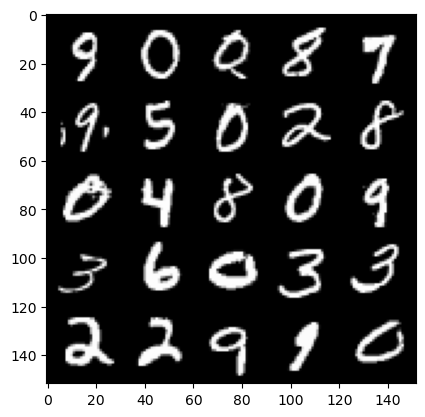

  4%|▍         | 20/469 [00:00<00:10, 41.91it/s]

Step 15500: Generator loss: 3.60804016494751, discriminator loss: 0.12410018241405486


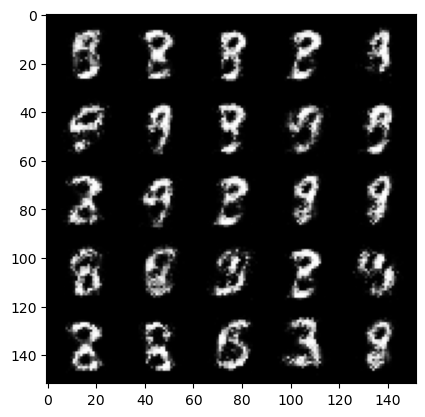

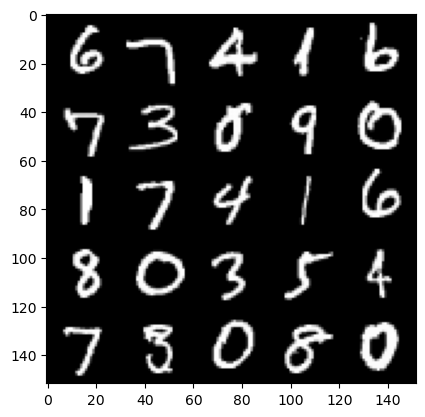

 12%|█▏        | 54/469 [00:01<00:09, 41.72it/s]

Step 16000: Generator loss: 3.6196289443969714, discriminator loss: 0.12699576848000296


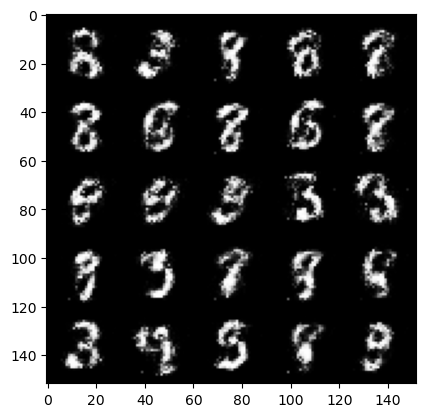

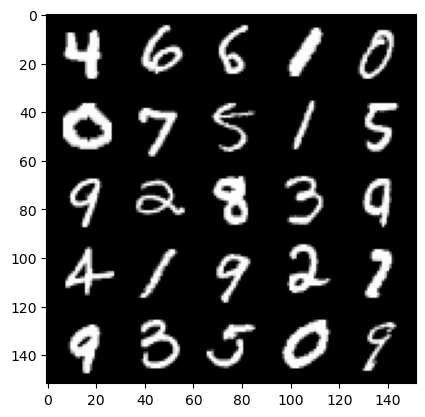

 18%|█▊        | 85/469 [00:02<00:09, 42.37it/s]

Step 16500: Generator loss: 3.5424788241386453, discriminator loss: 0.12353467199951414


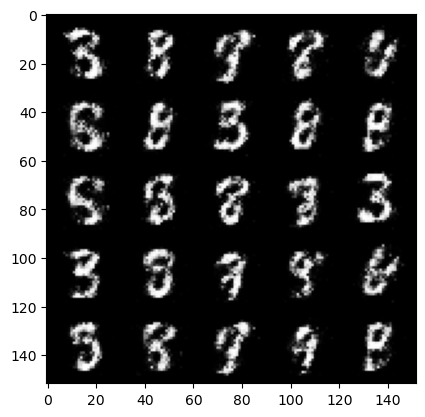

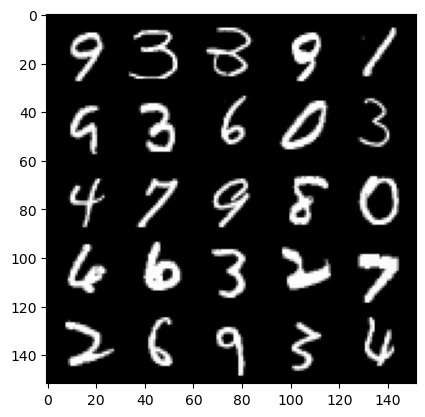

 25%|██▍       | 115/469 [00:02<00:08, 43.09it/s]

Step 17000: Generator loss: 3.5204679198265074, discriminator loss: 0.13594190892577168


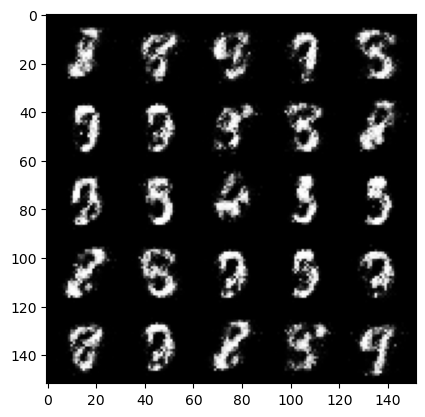

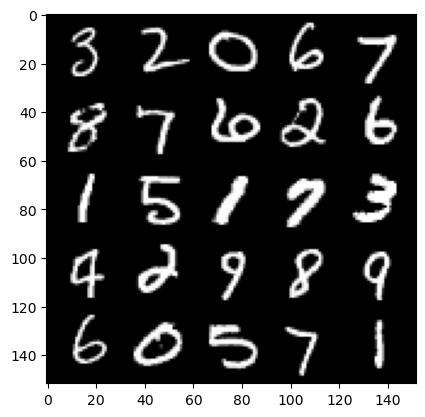

 31%|███       | 145/469 [00:03<00:07, 43.39it/s]

Step 17500: Generator loss: 3.684459566116333, discriminator loss: 0.12273869726806877


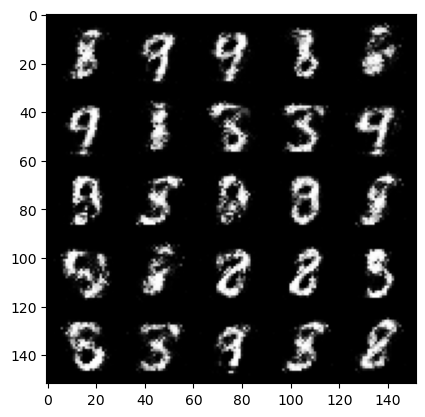

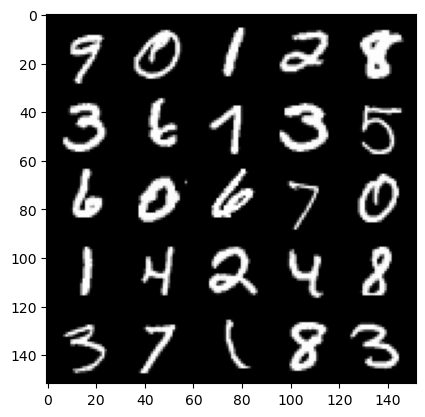

 37%|███▋      | 175/469 [00:04<00:06, 43.17it/s]

Step 18000: Generator loss: 3.5653772411346485, discriminator loss: 0.12904574779421094


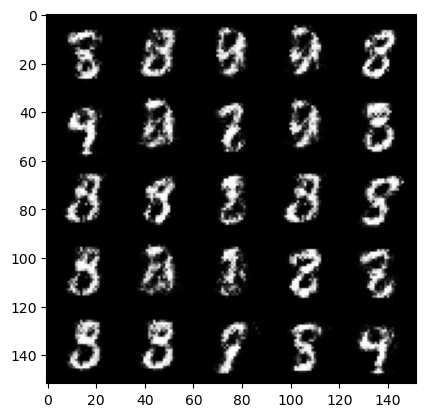

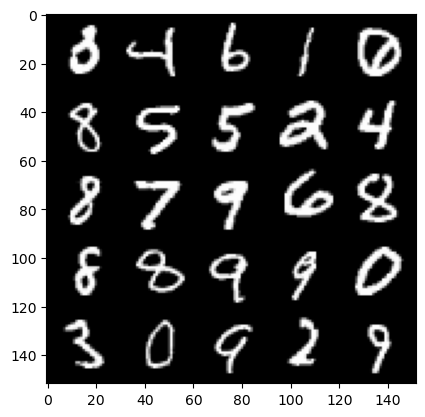

 44%|████▎     | 205/469 [00:04<00:06, 42.67it/s]

Step 18500: Generator loss: 3.457366318702699, discriminator loss: 0.14123284794390203


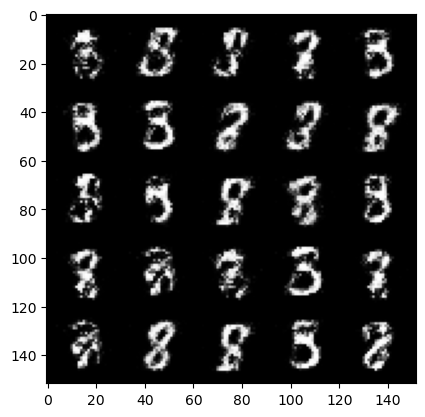

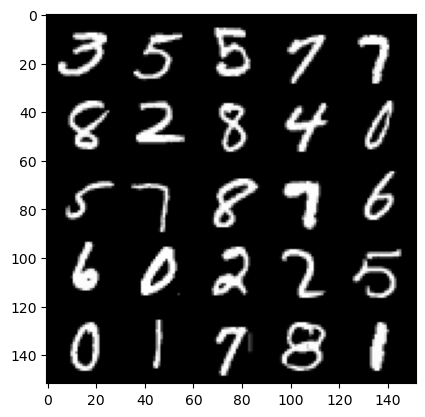

 51%|█████     | 240/469 [00:05<00:05, 43.05it/s]

Step 19000: Generator loss: 3.4043420209884636, discriminator loss: 0.142251330792904


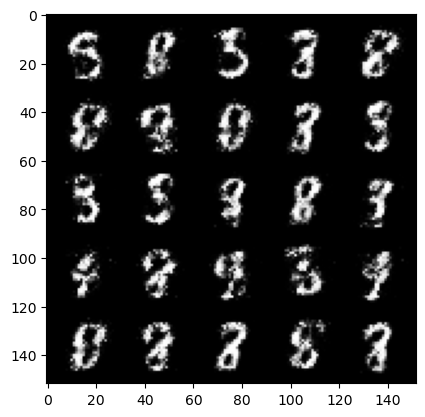

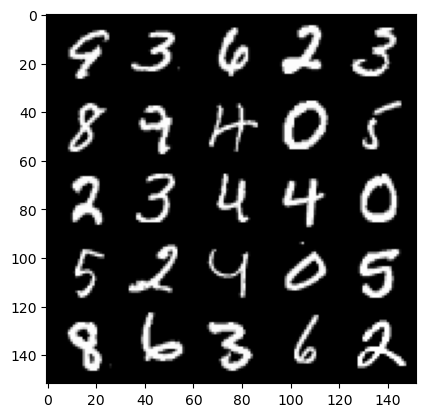

 57%|█████▋    | 269/469 [00:08<00:05, 35.28it/s]

Step 19500: Generator loss: 3.3007885580062846, discriminator loss: 0.15767615181207661


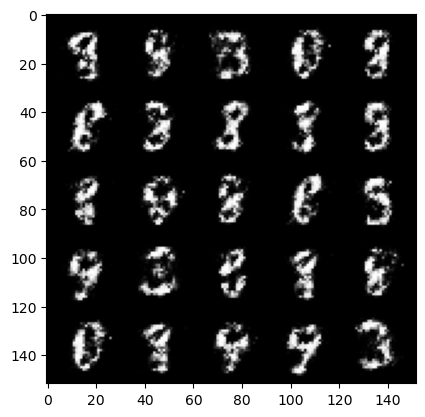

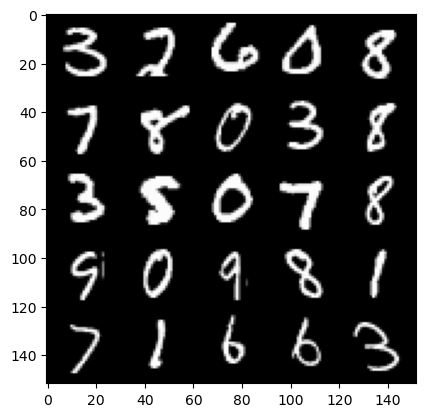

 64%|██████▍   | 299/469 [00:09<00:04, 36.65it/s]

Step 20000: Generator loss: 3.225902087211611, discriminator loss: 0.15451130604743957


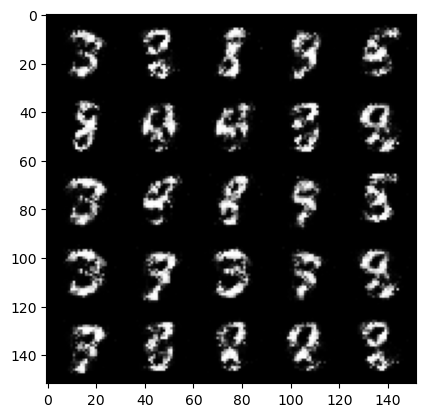

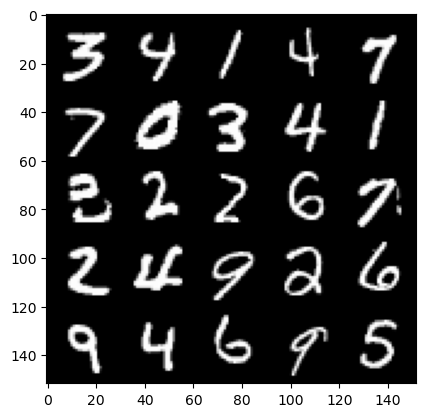

 71%|███████   | 332/469 [00:09<00:03, 35.84it/s]

Step 20500: Generator loss: 3.345240707874298, discriminator loss: 0.15273501682281496


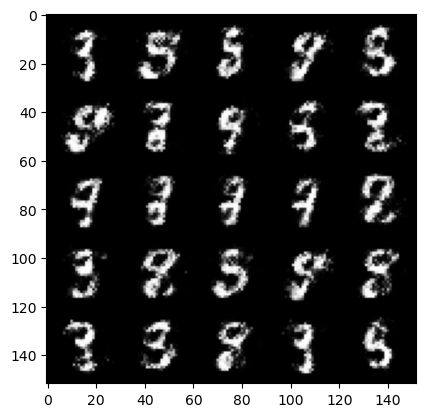

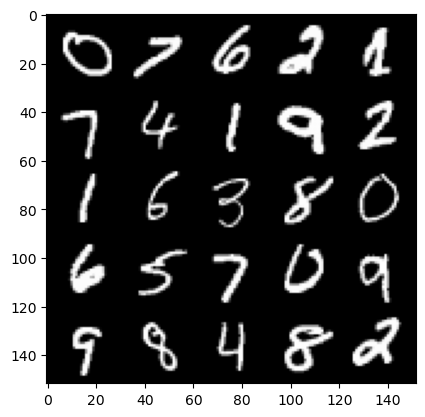

 77%|███████▋  | 361/469 [00:09<00:02, 42.72it/s]

Step 21000: Generator loss: 3.3453474173545854, discriminator loss: 0.16318804779648788


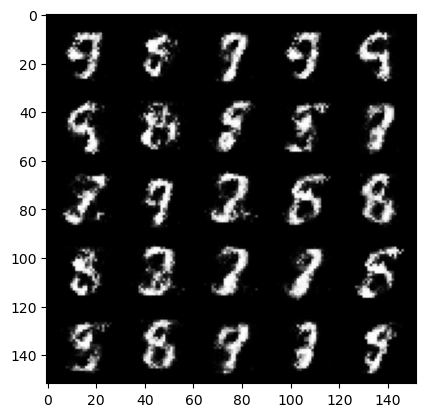

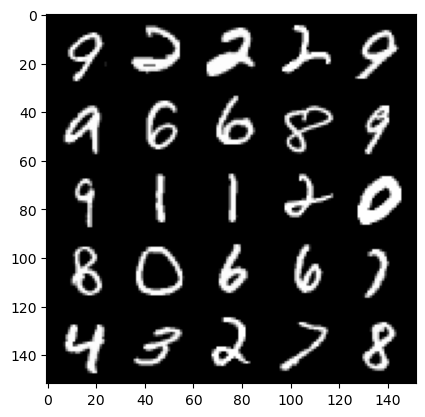

 84%|████████▍ | 395/469 [00:09<00:01, 42.74it/s]

Step 21500: Generator loss: 3.4718741493225083, discriminator loss: 0.14354916447401048


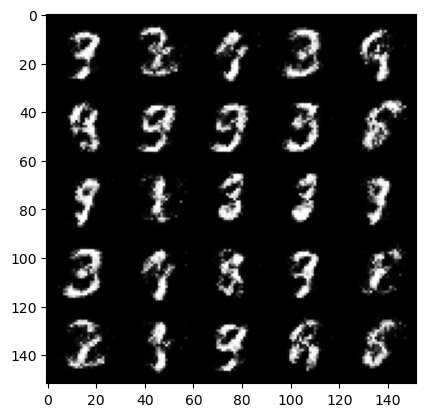

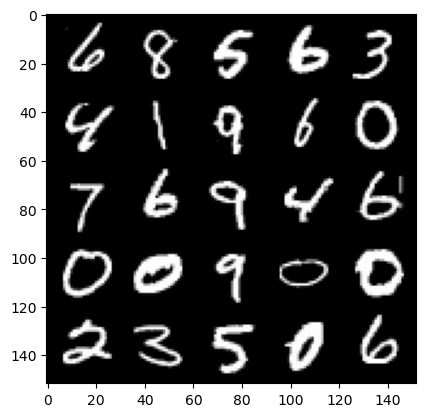

 91%|█████████ | 425/469 [00:09<00:01, 42.94it/s]

Step 22000: Generator loss: 3.271345254898071, discriminator loss: 0.16544252113997948


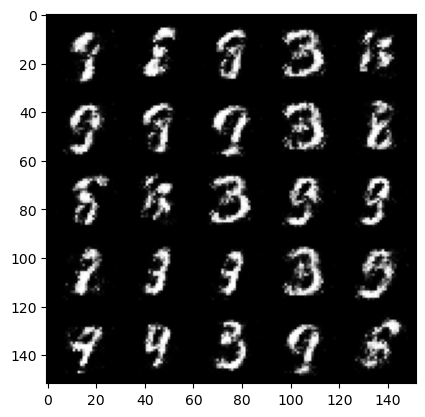

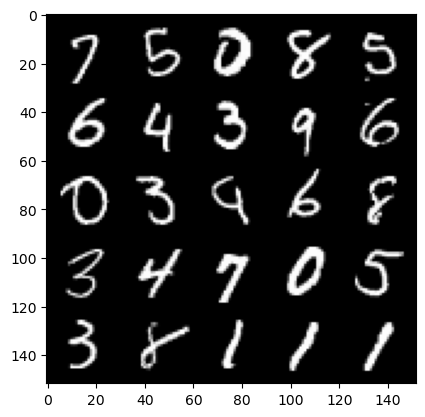

 97%|█████████▋| 455/469 [00:10<00:00, 42.95it/s]

Step 22500: Generator loss: 3.158534195423126, discriminator loss: 0.1653117590993644


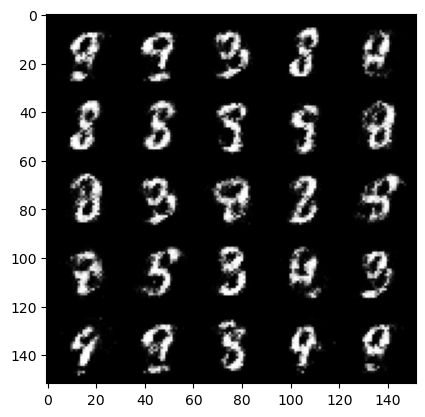

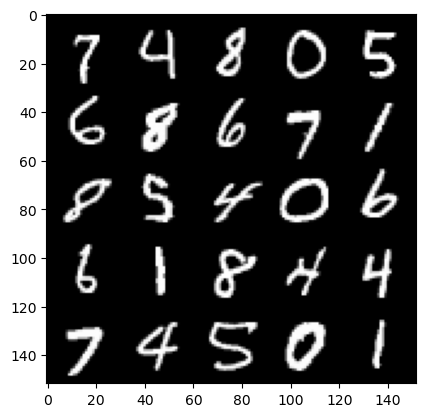

  3%|▎         | 15/469 [00:00<00:11, 41.11it/s]

Step 23000: Generator loss: 3.0849380340576174, discriminator loss: 0.17943024563789367


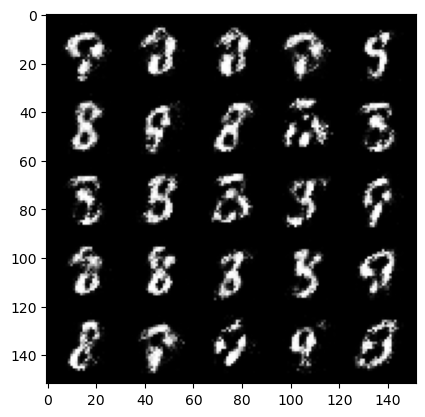

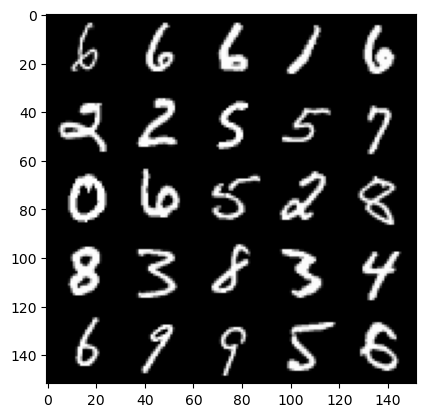

 11%|█         | 50/469 [00:01<00:09, 42.24it/s]

Step 23500: Generator loss: 3.1973885741233854, discriminator loss: 0.17830568167567243


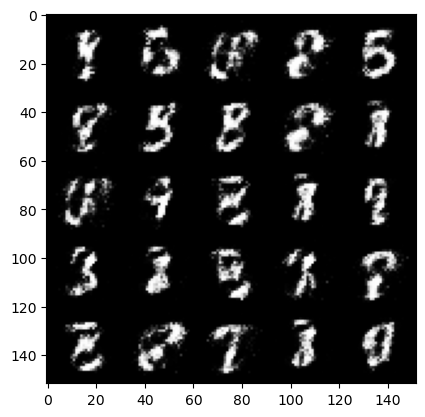

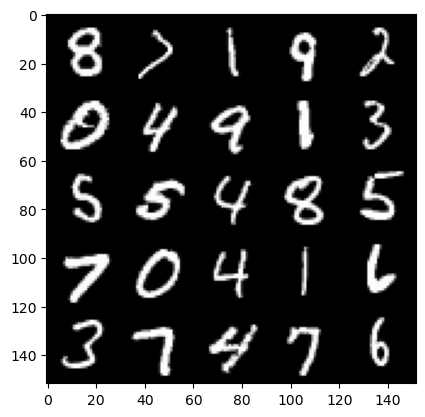

 17%|█▋        | 79/469 [00:02<00:10, 35.75it/s]

Step 24000: Generator loss: 3.1012320423126196, discriminator loss: 0.18789342236518866


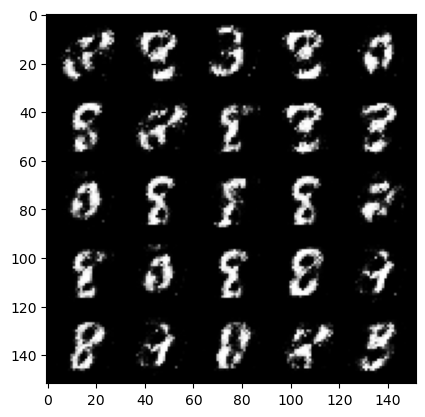

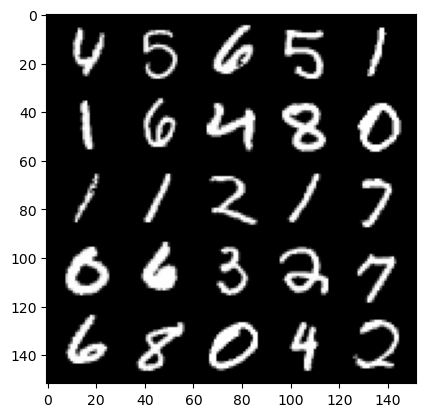

 23%|██▎       | 110/469 [00:02<00:08, 41.89it/s]

Step 24500: Generator loss: 3.3175122361183145, discriminator loss: 0.17099962052702897


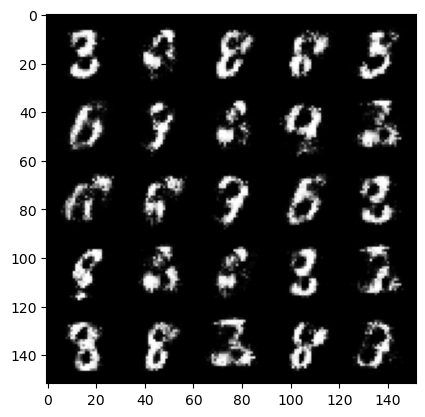

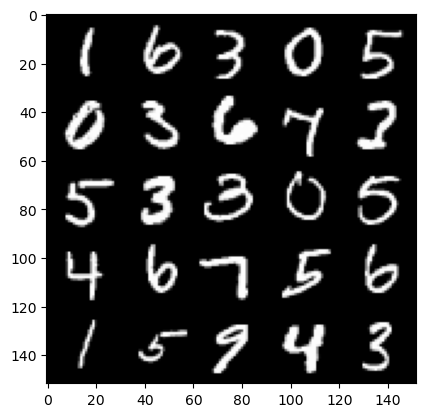

 30%|██▉       | 139/469 [00:03<00:07, 42.46it/s]

Step 25000: Generator loss: 2.940749166011811, discriminator loss: 0.20979462721943862


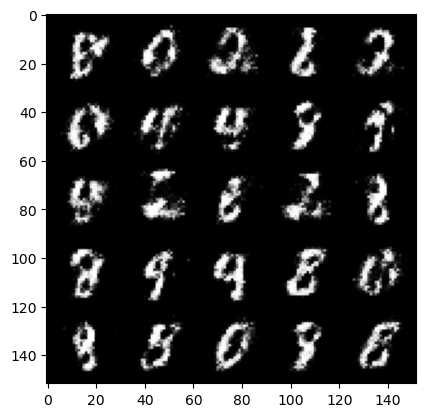

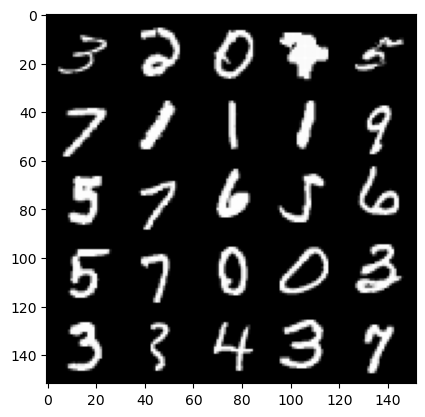

 36%|███▌      | 170/469 [00:03<00:06, 43.16it/s]

Step 25500: Generator loss: 3.11517336654663, discriminator loss: 0.16959441401064404


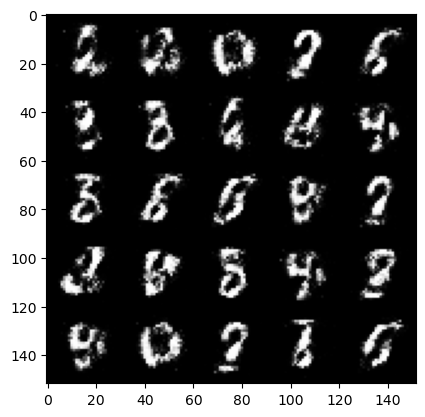

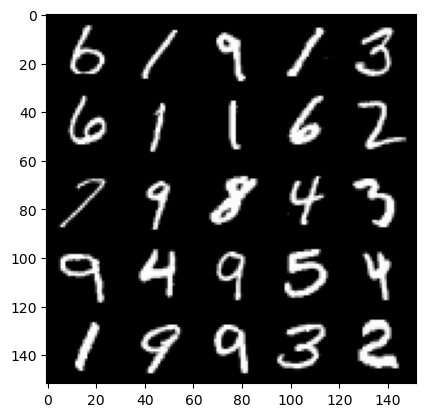

 44%|████▎     | 205/469 [00:04<00:06, 42.08it/s]

Step 26000: Generator loss: 3.2366188068389894, discriminator loss: 0.162610911011696


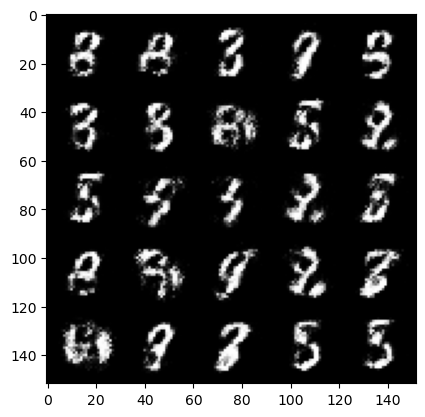

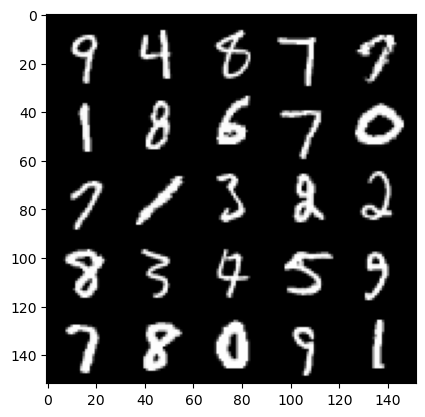

 50%|█████     | 235/469 [00:05<00:05, 43.29it/s]

Step 26500: Generator loss: 3.033407701492309, discriminator loss: 0.1973300810605285


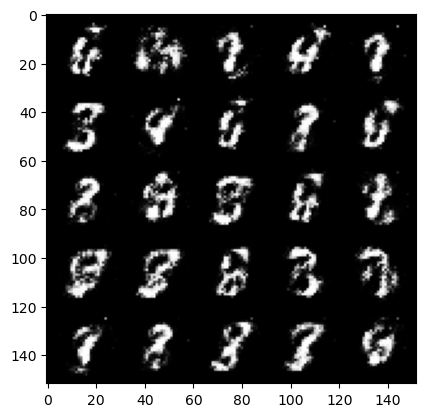

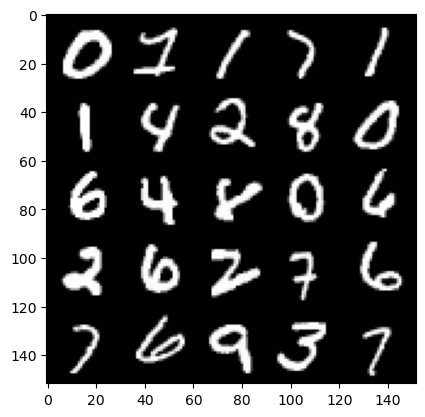

 57%|█████▋    | 267/469 [00:06<00:04, 42.54it/s]

Step 27000: Generator loss: 2.9944322576522824, discriminator loss: 0.18978347727656372


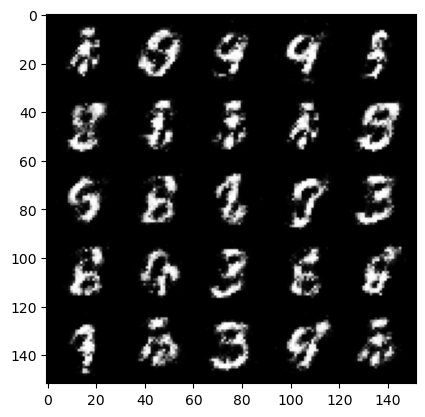

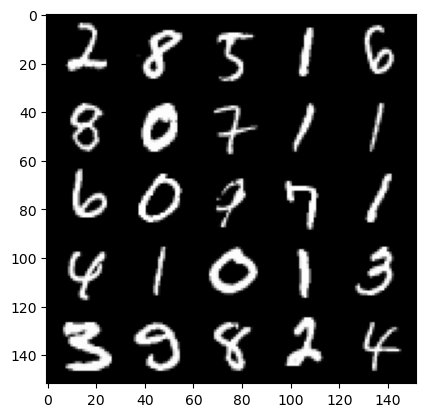

 63%|██████▎   | 295/469 [00:06<00:04, 43.46it/s]

Step 27500: Generator loss: 2.9379248909950237, discriminator loss: 0.19148229603469374


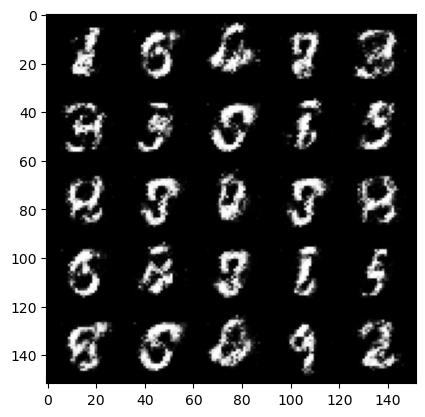

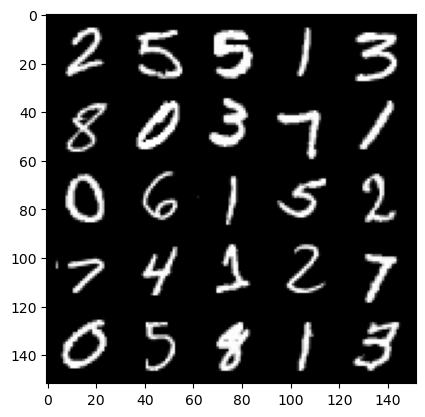

 70%|██████▉   | 327/469 [00:08<00:05, 26.65it/s]

Step 28000: Generator loss: 2.8907129273414593, discriminator loss: 0.2084439139515162


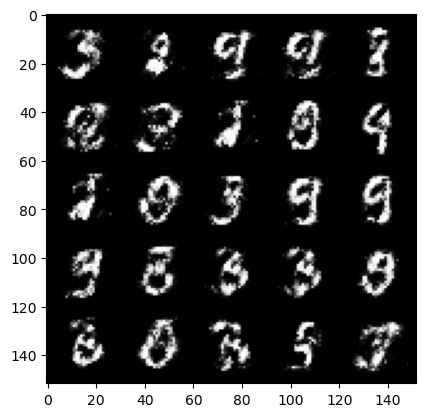

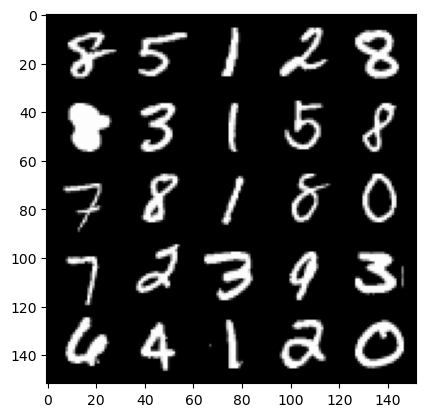

 76%|███████▌  | 356/469 [00:09<00:02, 43.88it/s]

Step 28500: Generator loss: 2.8173013091087316, discriminator loss: 0.22146471893787376


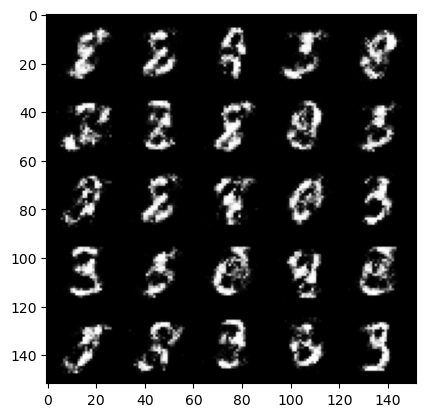

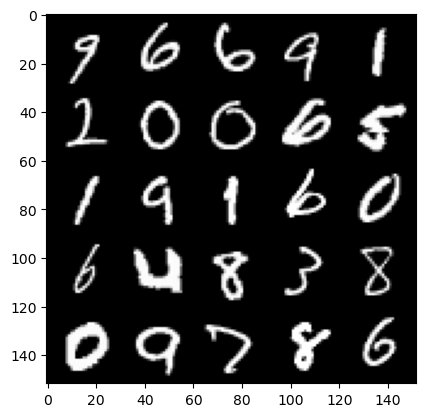

 83%|████████▎ | 389/469 [00:09<00:01, 43.22it/s]

Step 29000: Generator loss: 2.757842952728273, discriminator loss: 0.23575716423988347


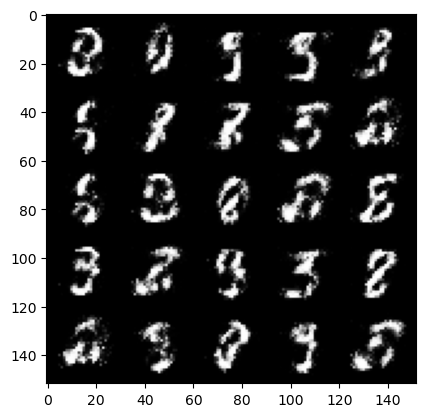

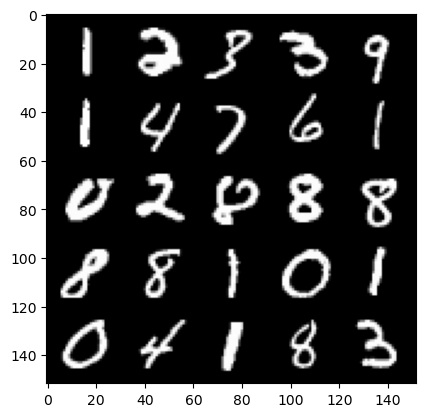

 90%|████████▉ | 421/469 [00:10<00:01, 42.00it/s]

Step 29500: Generator loss: 2.8840367794036825, discriminator loss: 0.22385269872844207


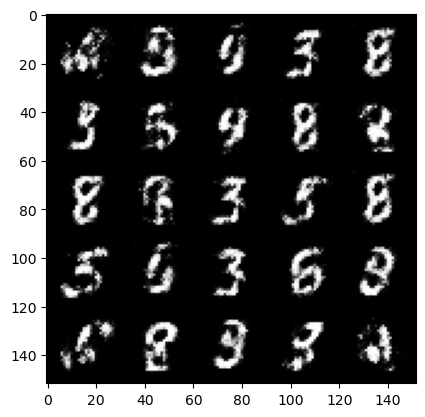

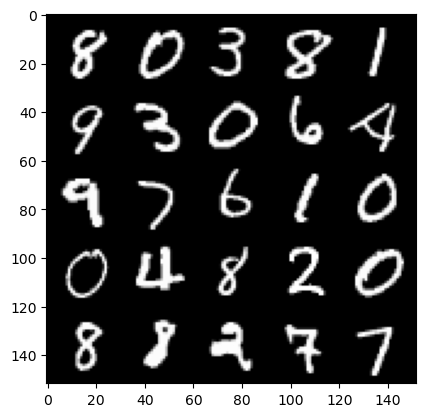

 96%|█████████▌| 450/469 [00:10<00:00, 42.27it/s]

Step 30000: Generator loss: 2.8677824459075922, discriminator loss: 0.20862488028407103


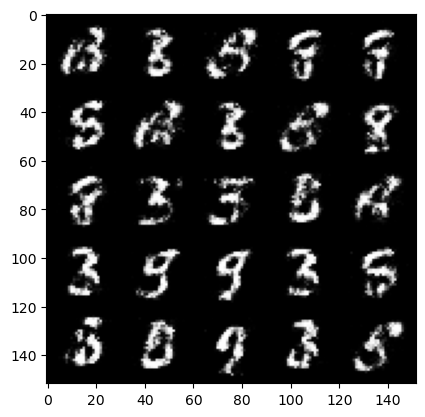

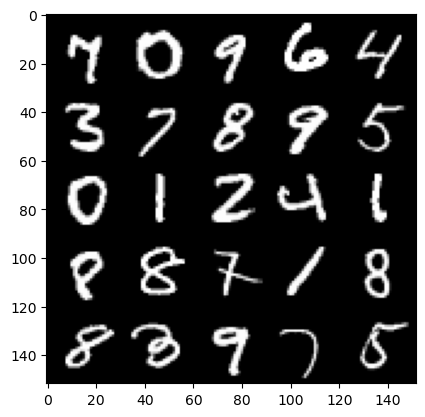

  3%|▎         | 15/469 [00:00<00:10, 42.50it/s]

Step 30500: Generator loss: 2.6732064018249493, discriminator loss: 0.25315194964408866


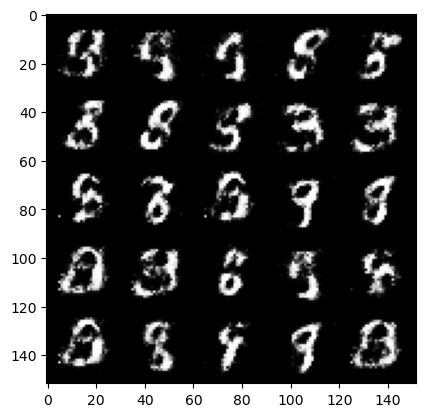

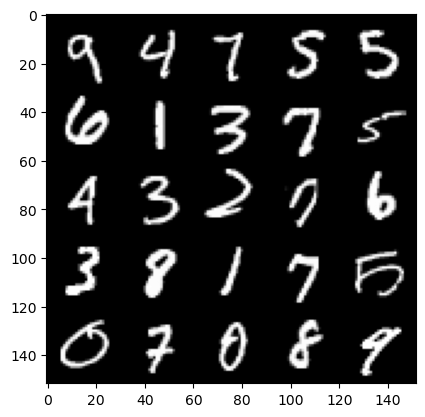

 10%|▉         | 45/469 [00:01<00:09, 42.75it/s]

Step 31000: Generator loss: 2.7072236752510057, discriminator loss: 0.23683683815598475


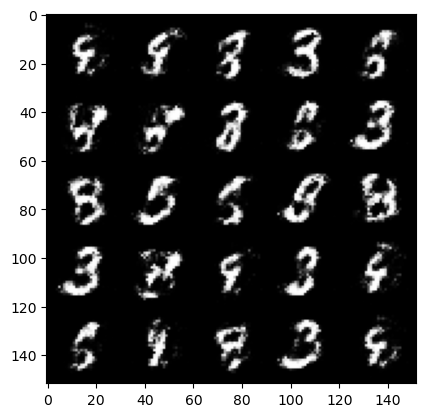

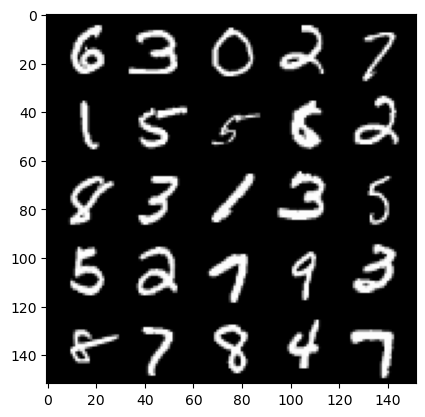

 16%|█▌        | 76/469 [00:02<00:10, 37.62it/s]

Step 31500: Generator loss: 2.740088877677917, discriminator loss: 0.24400204649567606


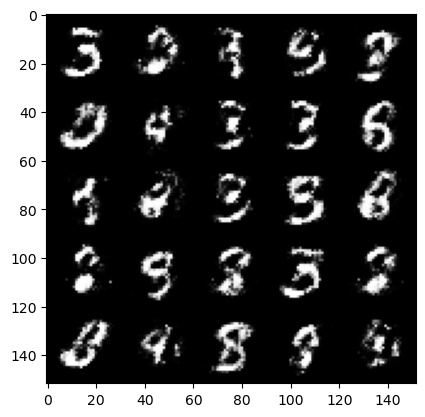

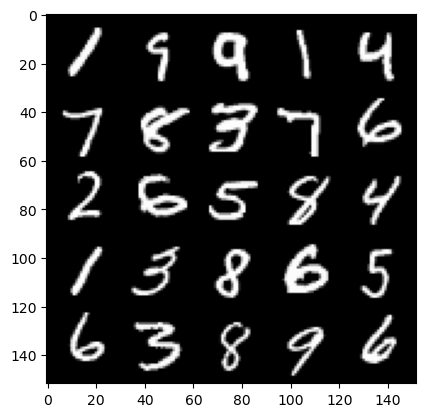

 22%|██▏       | 105/469 [00:02<00:08, 42.35it/s]

Step 32000: Generator loss: 2.722040629386901, discriminator loss: 0.22861129772663116


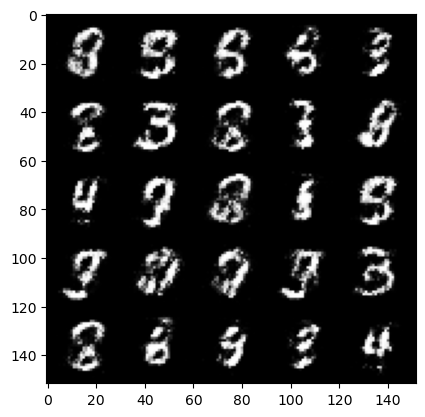

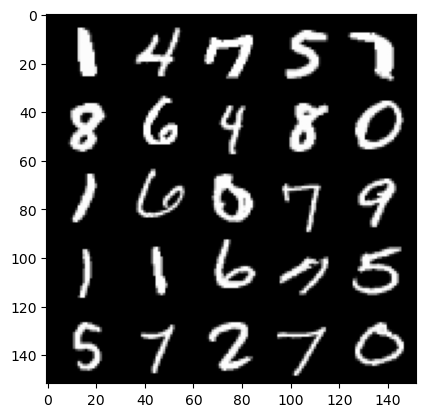

 30%|██▉       | 139/469 [00:03<00:07, 42.48it/s]

Step 32500: Generator loss: 2.7073920278549175, discriminator loss: 0.21124008700251573


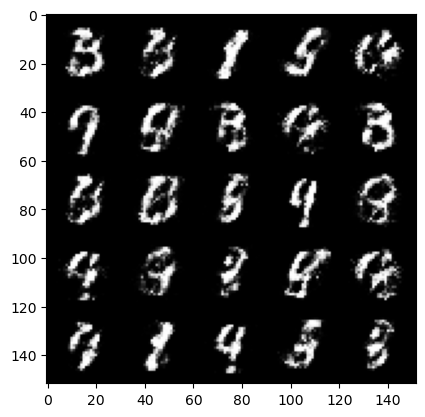

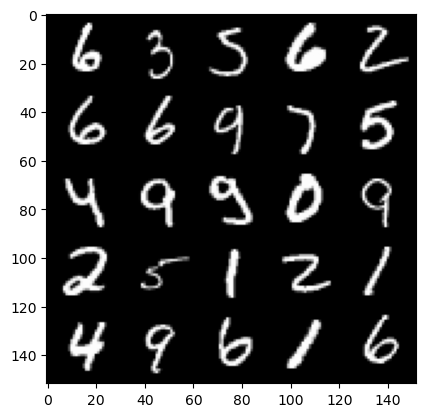

 36%|███▌      | 168/469 [00:03<00:06, 43.24it/s]

Step 33000: Generator loss: 2.6426468935012766, discriminator loss: 0.23749441382288936


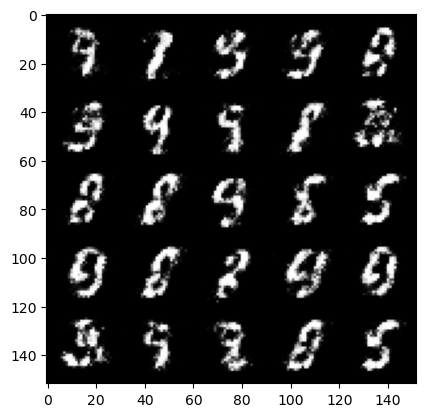

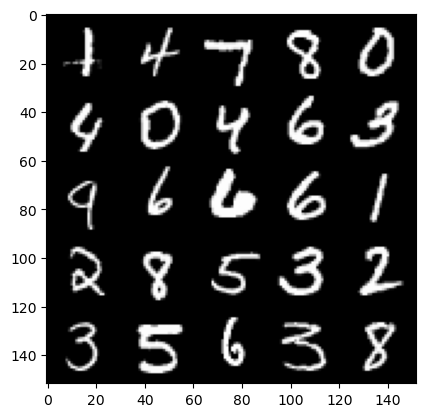

 43%|████▎     | 201/469 [00:04<00:07, 35.67it/s]

Step 33500: Generator loss: 2.688032437324528, discriminator loss: 0.2335648370385168


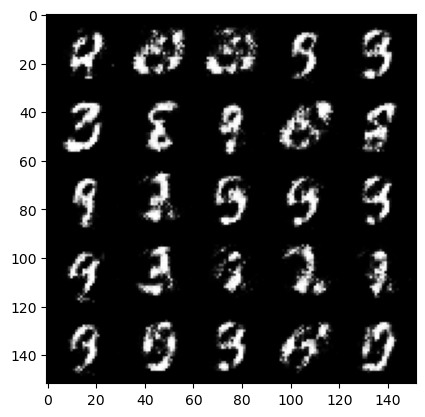

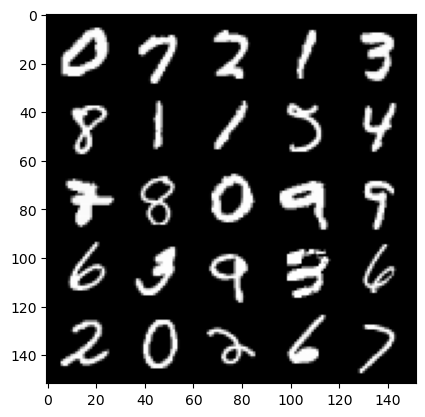

 49%|████▉     | 230/469 [00:05<00:05, 43.16it/s]

Step 34000: Generator loss: 2.6758156261444084, discriminator loss: 0.2502844231128693


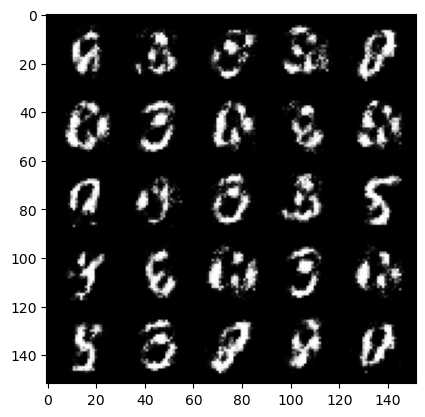

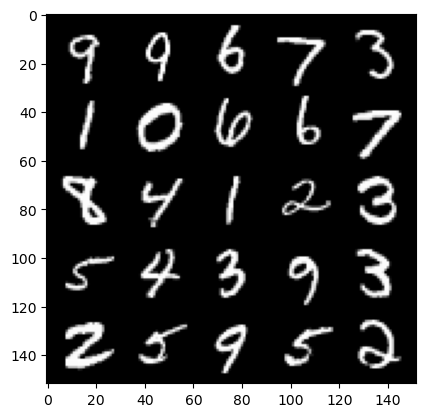

 55%|█████▌    | 260/469 [00:06<00:04, 43.35it/s]

Step 34500: Generator loss: 2.7012375993728654, discriminator loss: 0.22556265473365783


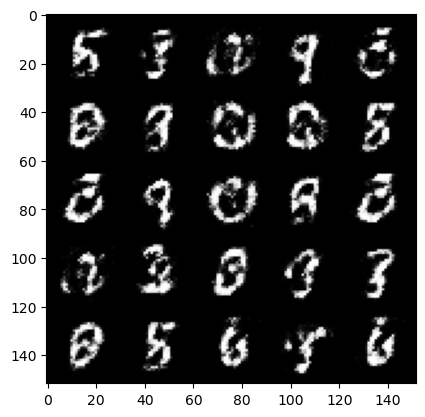

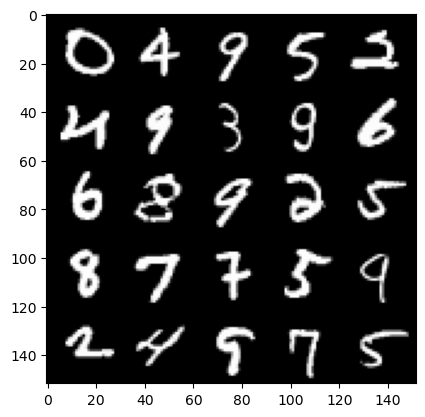

 62%|██████▏   | 290/469 [00:06<00:04, 40.40it/s]

Step 35000: Generator loss: 2.6747775907516473, discriminator loss: 0.24571867856383303


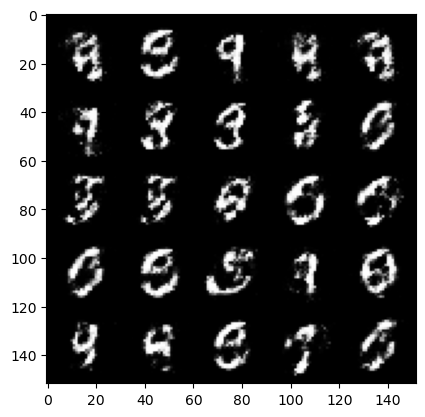

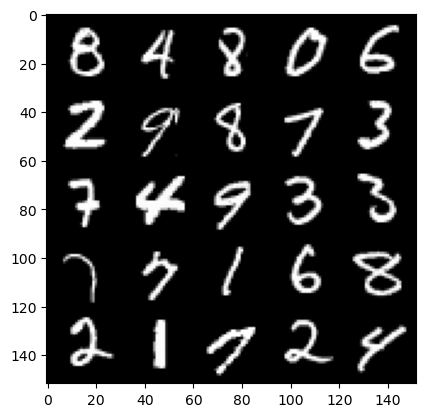

 69%|██████▉   | 324/469 [00:07<00:03, 41.64it/s]

Step 35500: Generator loss: 2.5884003005027783, discriminator loss: 0.2561577982306479


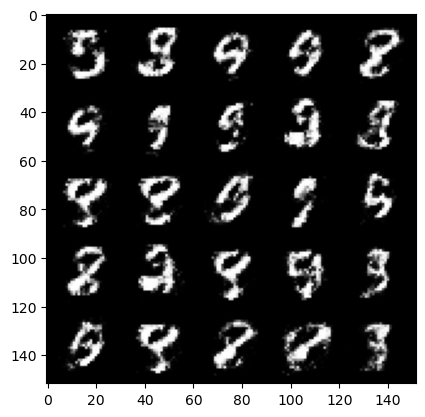

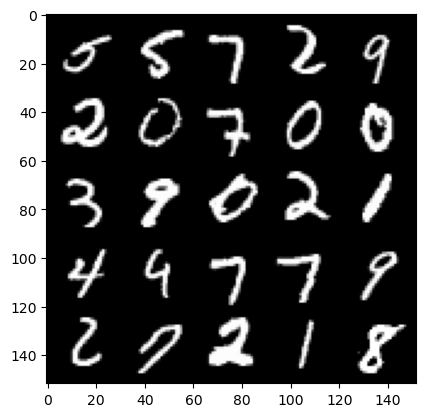

 75%|███████▌  | 354/469 [00:08<00:02, 42.70it/s]

Step 36000: Generator loss: 2.6249310100078564, discriminator loss: 0.25341481953859346


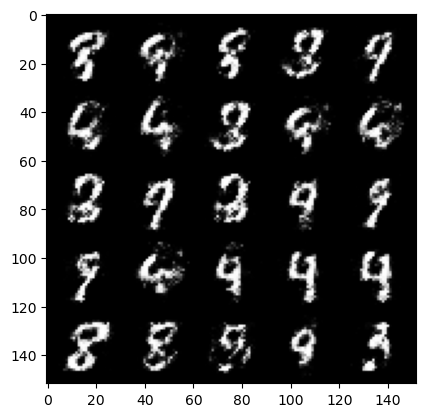

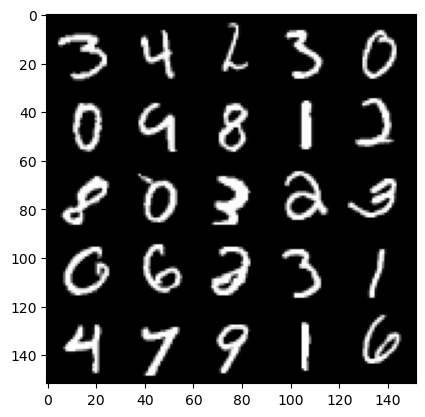

 82%|████████▏ | 385/469 [00:08<00:01, 42.84it/s]

Step 36500: Generator loss: 2.498387450456622, discriminator loss: 0.2717857489585876


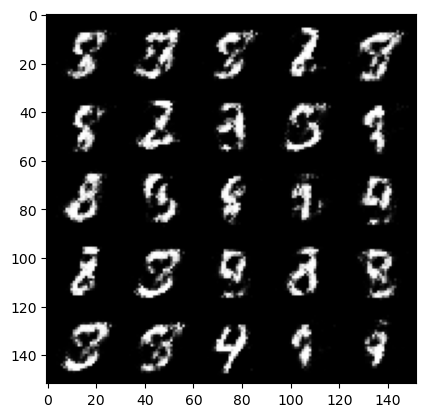

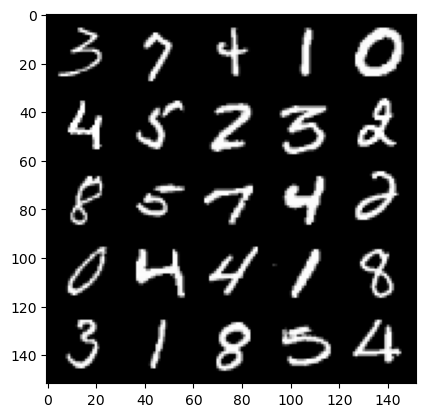

 88%|████████▊ | 415/469 [00:09<00:01, 43.03it/s]

Step 37000: Generator loss: 2.480113050460815, discriminator loss: 0.2615761815607546


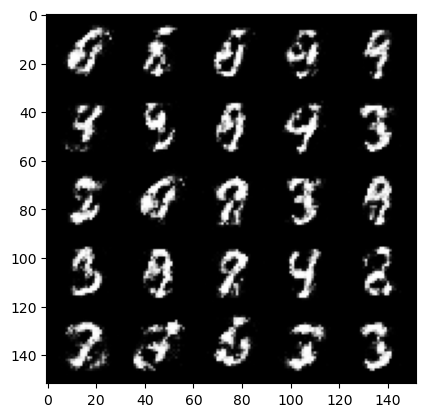

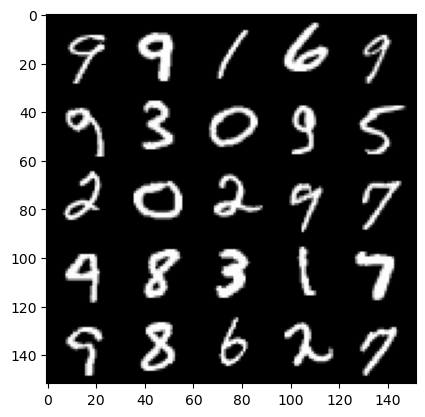

 96%|█████████▌| 449/469 [00:12<00:00, 35.88it/s]

Step 37500: Generator loss: 2.5608104352951053, discriminator loss: 0.24658425435423872


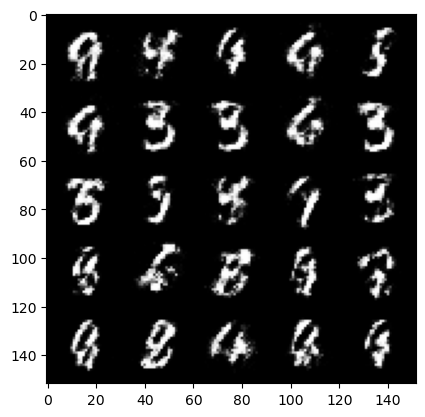

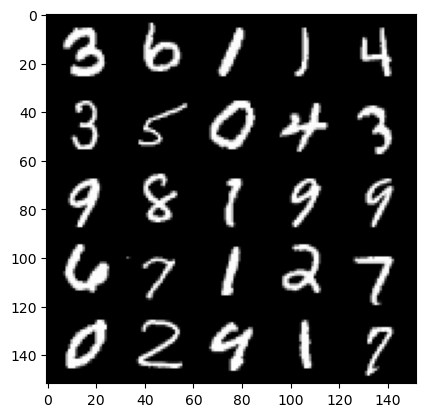

  2%|▏         | 8/469 [00:00<00:12, 35.97it/s]

Step 38000: Generator loss: 2.4957813851833377, discriminator loss: 0.26153011119365716


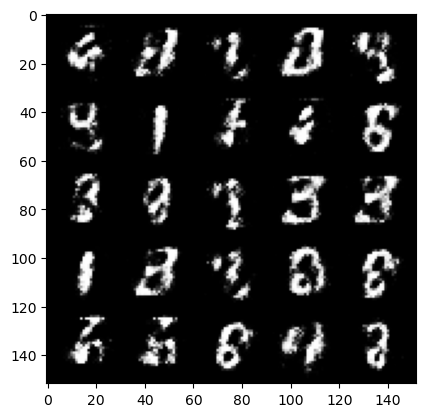

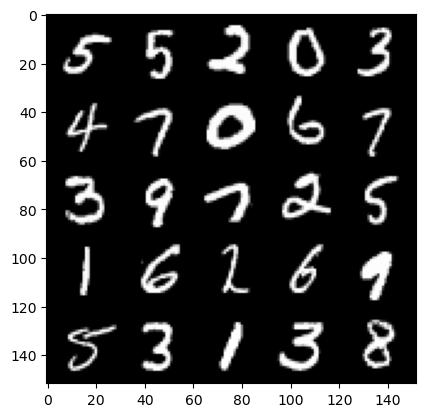

  9%|▊         | 40/469 [00:01<00:11, 36.60it/s]

Step 38500: Generator loss: 2.4716271998882324, discriminator loss: 0.2613632089197636


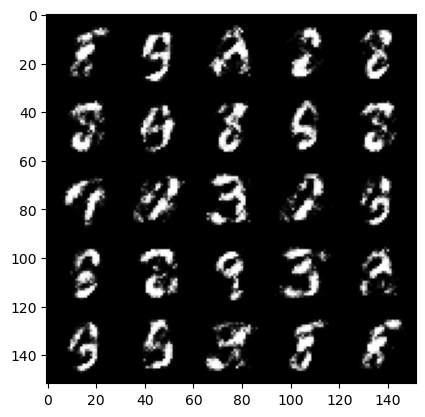

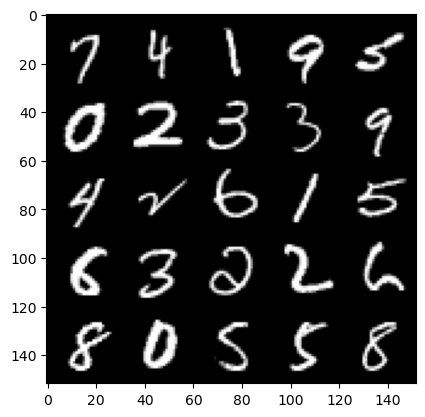

 16%|█▌        | 73/469 [00:01<00:10, 38.27it/s]

Step 39000: Generator loss: 2.4287192630767835, discriminator loss: 0.26879709327220913


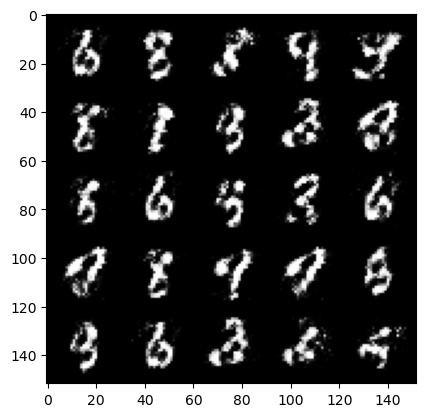

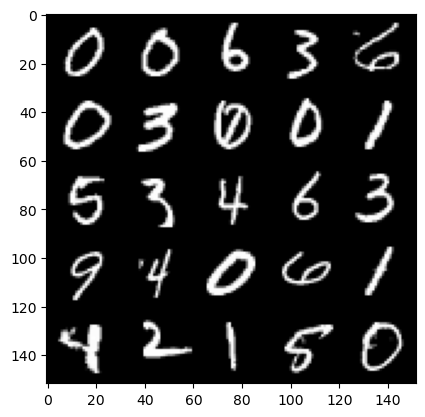

 21%|██▏       | 100/469 [00:02<00:08, 43.18it/s]

Step 39500: Generator loss: 2.457408411741255, discriminator loss: 0.27538988080620763


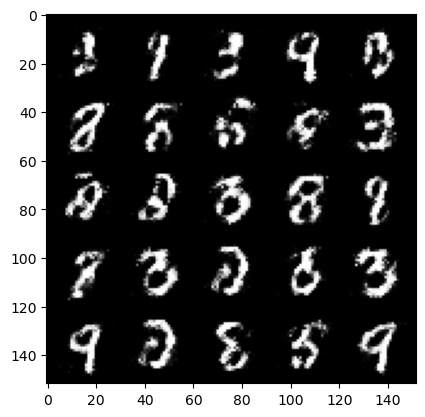

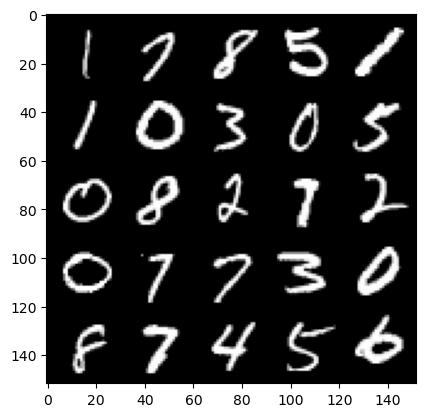

 28%|██▊       | 133/469 [00:03<00:07, 42.60it/s]

Step 40000: Generator loss: 2.307676024675369, discriminator loss: 0.2900127595961093


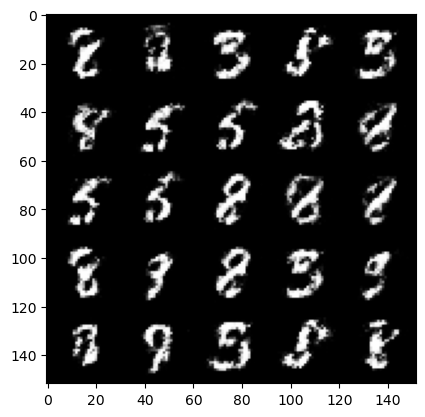

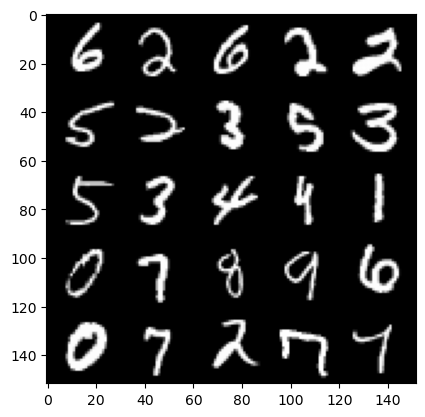

 35%|███▍      | 164/469 [00:04<00:08, 36.47it/s]

Step 40500: Generator loss: 2.3345197312831893, discriminator loss: 0.2805864078104495


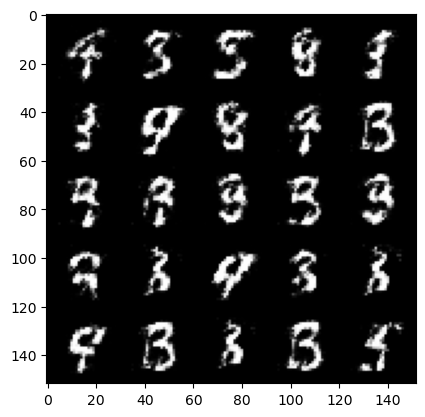

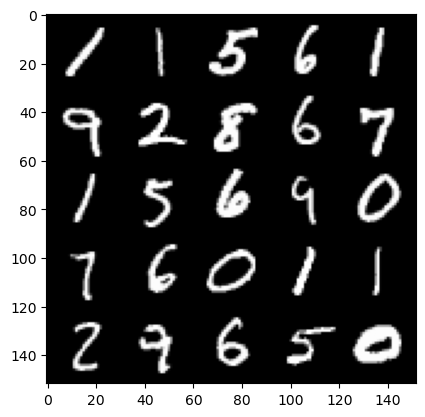

 42%|████▏     | 195/469 [00:04<00:06, 42.63it/s]

Step 41000: Generator loss: 2.3645067329406735, discriminator loss: 0.27788704812526693


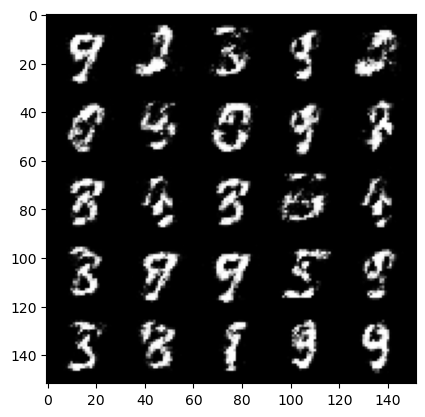

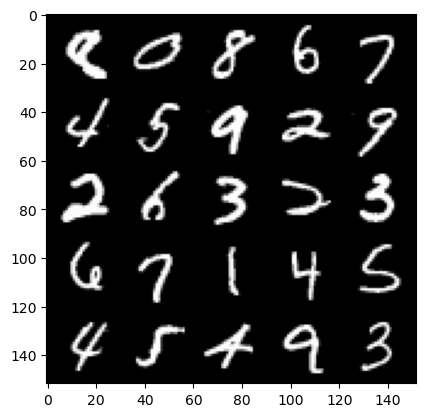

 48%|████▊     | 225/469 [00:05<00:05, 43.65it/s]

Step 41500: Generator loss: 2.386929978370668, discriminator loss: 0.2793970737755297


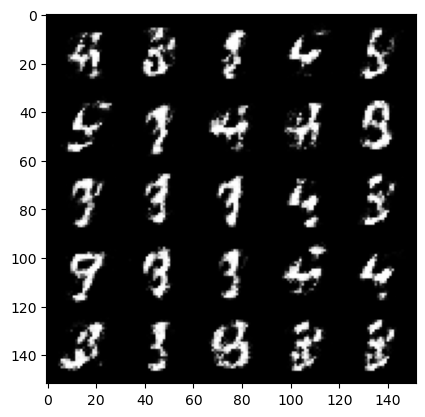

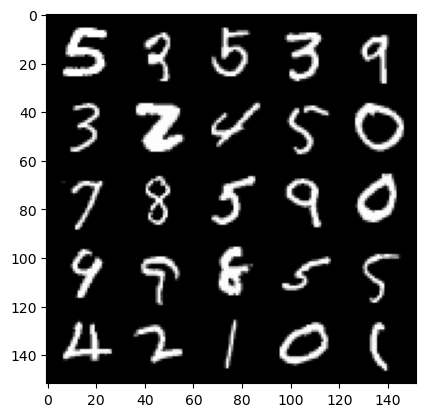

 54%|█████▍    | 255/469 [00:05<00:05, 42.41it/s]

Step 42000: Generator loss: 2.306011817455289, discriminator loss: 0.2889062392115592


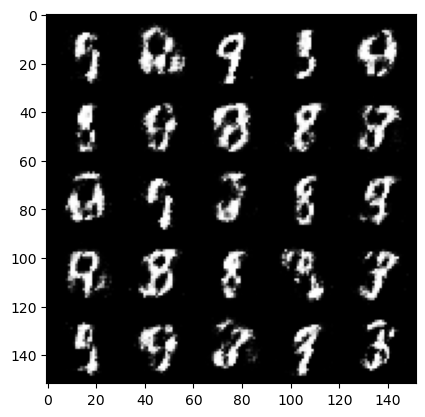

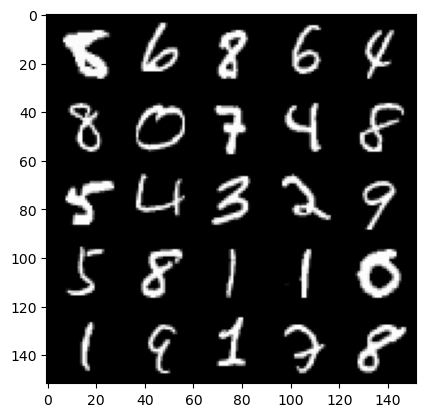

 62%|██████▏   | 290/469 [00:06<00:04, 43.30it/s]

Step 42500: Generator loss: 2.3686094043254844, discriminator loss: 0.2812057987749579


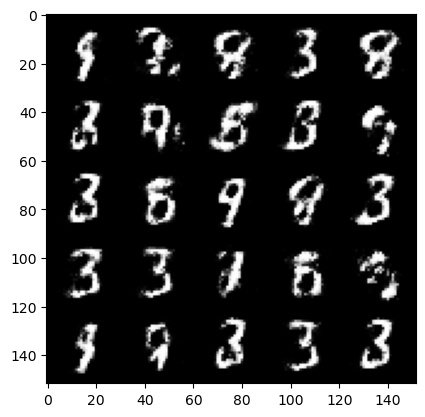

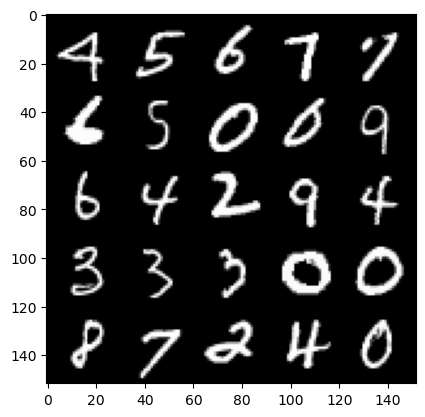

 68%|██████▊   | 320/469 [00:07<00:03, 42.72it/s]

Step 43000: Generator loss: 2.4127218480110173, discriminator loss: 0.284030676215887


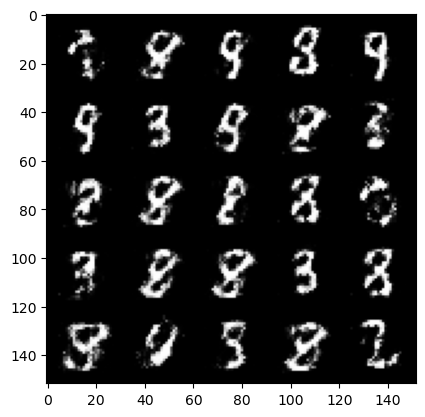

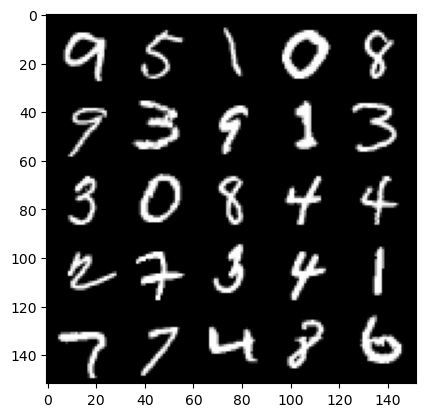

 75%|███████▍  | 350/469 [00:08<00:02, 42.89it/s]

Step 43500: Generator loss: 2.1603824174404127, discriminator loss: 0.3284917498528957


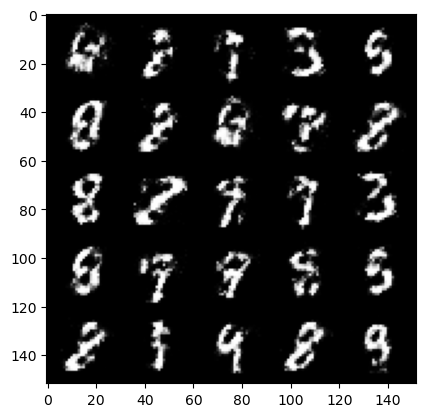

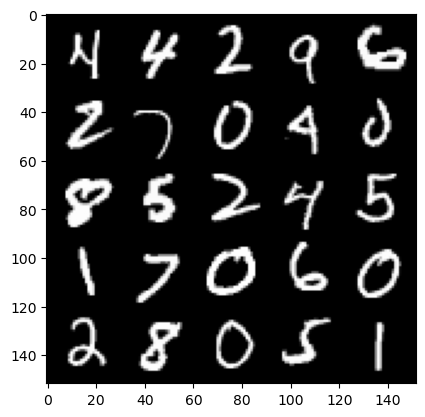

 81%|████████  | 380/469 [00:08<00:02, 42.28it/s]

Step 44000: Generator loss: 2.253860061407088, discriminator loss: 0.29078464022278766


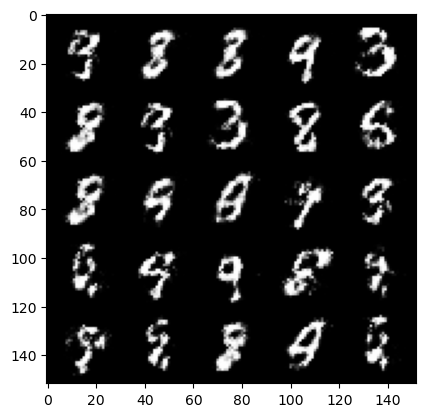

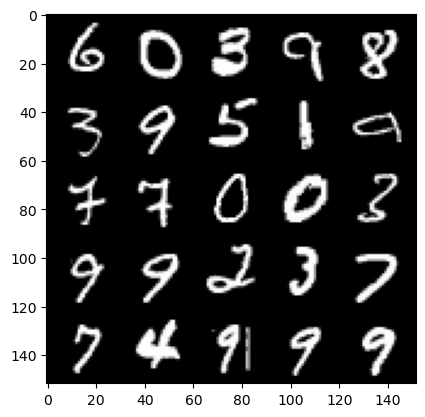

 87%|████████▋ | 410/469 [00:09<00:01, 40.75it/s]

Step 44500: Generator loss: 2.2453080322742456, discriminator loss: 0.31314055299758886


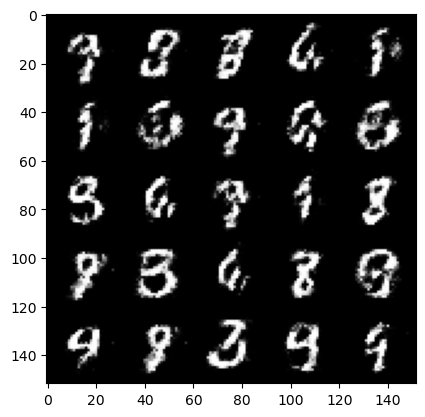

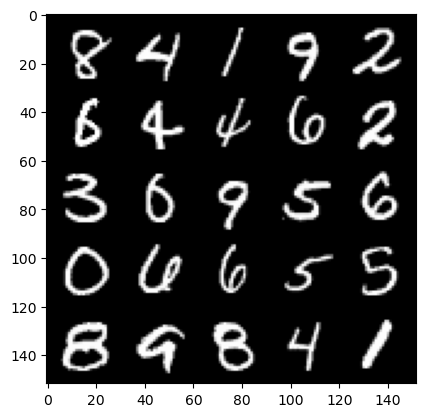

 95%|█████████▍| 445/469 [00:10<00:00, 42.86it/s]

Step 45000: Generator loss: 2.14988126373291, discriminator loss: 0.3224456631839275


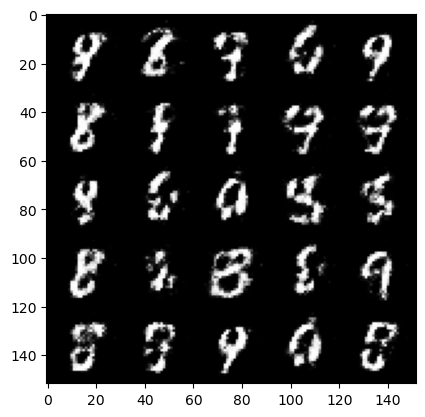

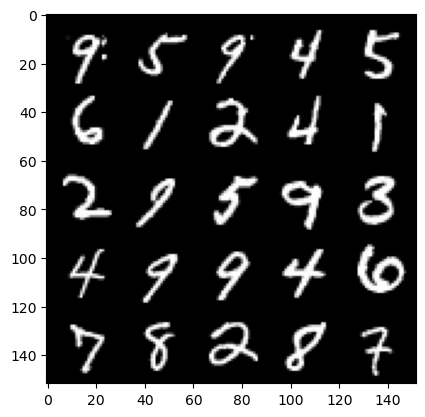

  1%|          | 5/469 [00:00<00:11, 41.07it/s]

Step 45500: Generator loss: 2.165524431228638, discriminator loss: 0.32478411626815784


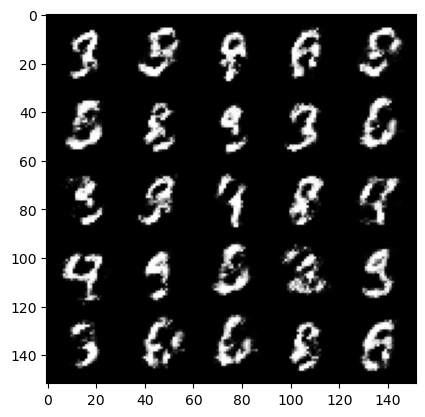

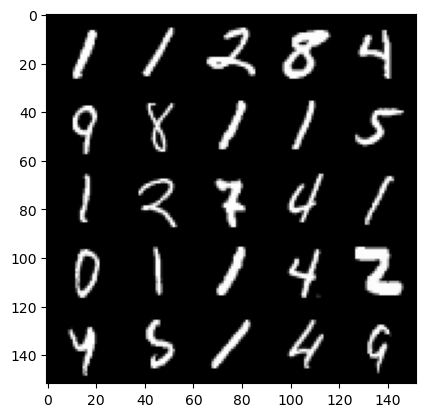

  8%|▊         | 36/469 [00:00<00:10, 41.60it/s]

Step 46000: Generator loss: 2.1901491110324844, discriminator loss: 0.3165175948143006


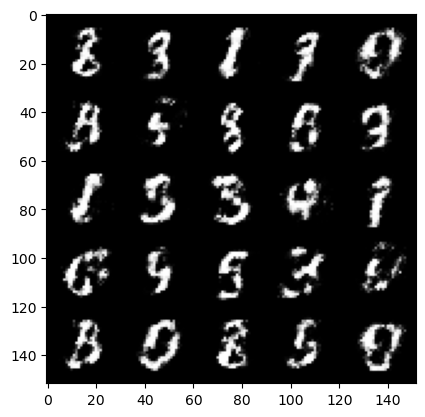

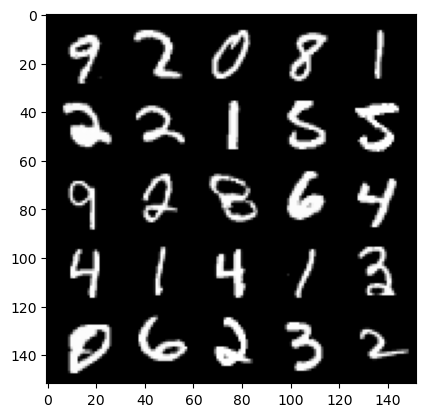

 14%|█▍        | 65/469 [00:01<00:09, 42.40it/s]

Step 46500: Generator loss: 2.324440726280212, discriminator loss: 0.27530118125677133


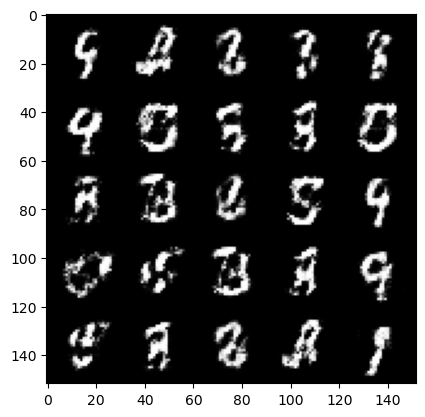

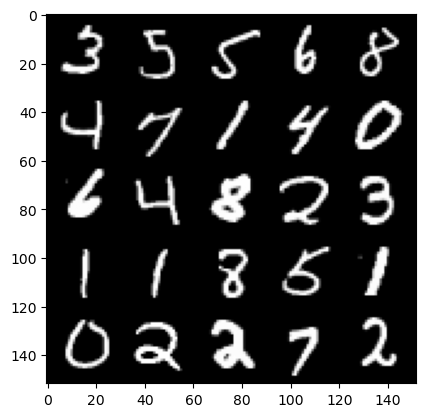

 21%|██▏       | 100/469 [00:02<00:08, 42.85it/s]

Step 47000: Generator loss: 2.266048974752427, discriminator loss: 0.2871137661635873


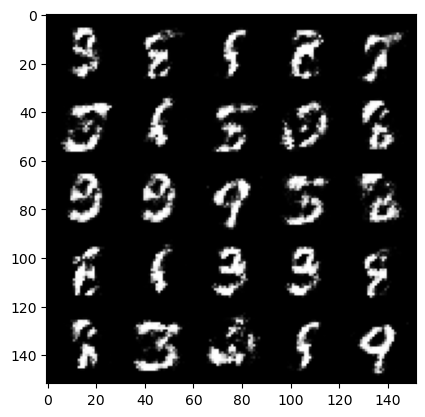

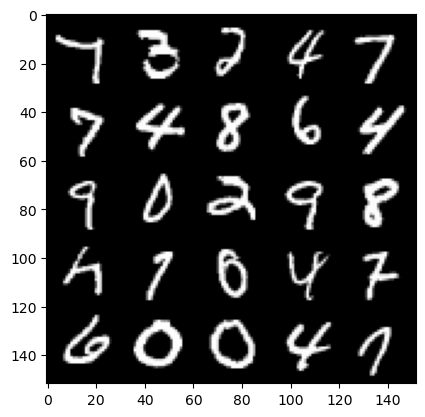

 28%|██▊       | 130/469 [00:03<00:07, 42.69it/s]

Step 47500: Generator loss: 2.2618963830471057, discriminator loss: 0.2923055479228498


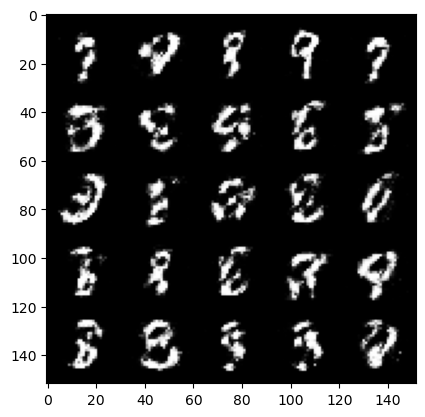

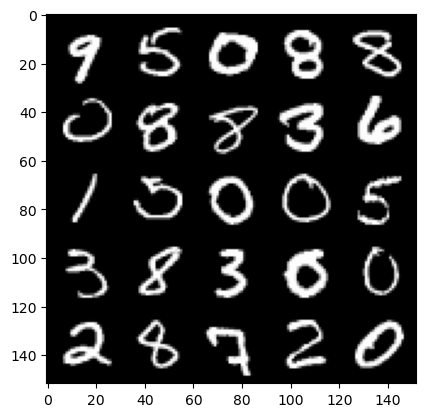

 34%|███▍      | 160/469 [00:03<00:07, 41.13it/s]

Step 48000: Generator loss: 2.157719944477082, discriminator loss: 0.3201867086589339


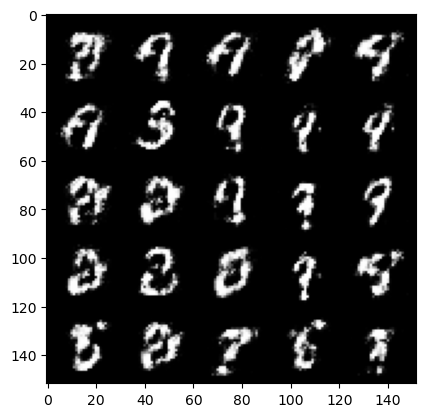

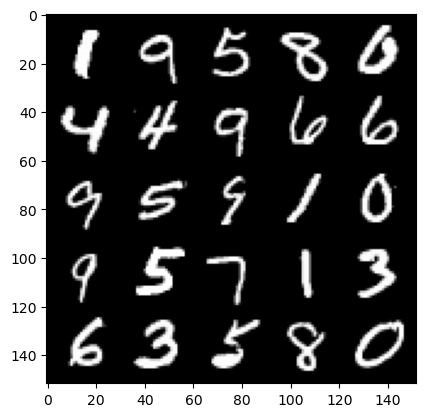

 40%|████      | 189/469 [00:04<00:06, 43.07it/s]

Step 48500: Generator loss: 2.1475327081680287, discriminator loss: 0.3061302492916581


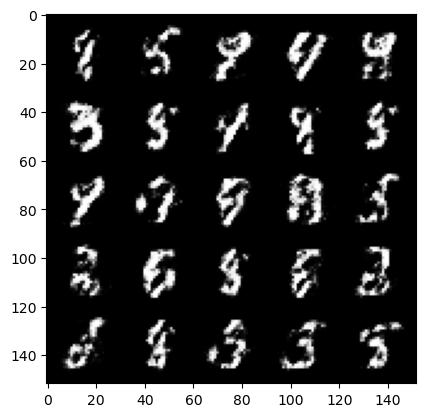

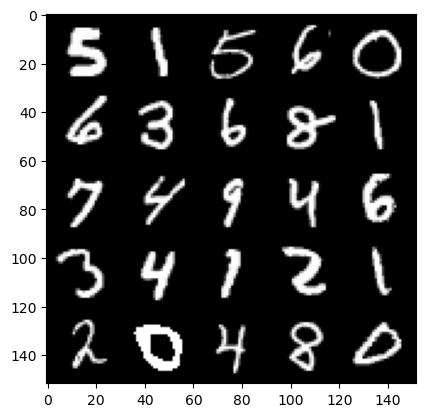

 47%|████▋     | 222/469 [00:05<00:05, 43.03it/s]

Step 49000: Generator loss: 2.2344515709877015, discriminator loss: 0.28791033130884125


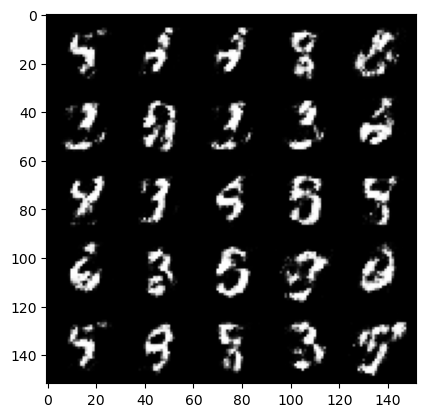

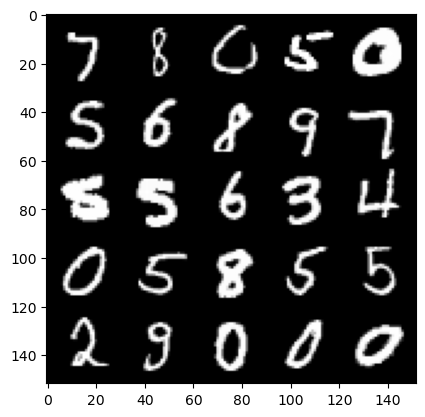

 54%|█████▍    | 254/469 [00:05<00:05, 42.39it/s]

Step 49500: Generator loss: 2.1562604503631597, discriminator loss: 0.31523144116997726


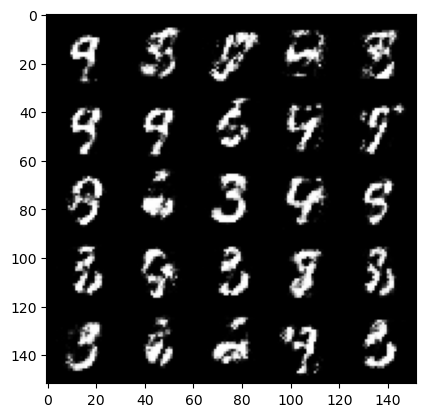

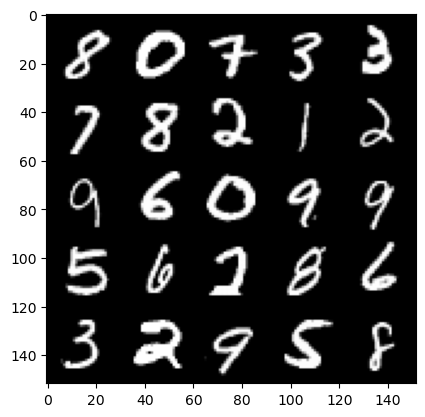

 61%|██████    | 284/469 [00:06<00:04, 42.27it/s]

Step 50000: Generator loss: 2.0456126310825358, discriminator loss: 0.34402795025706273


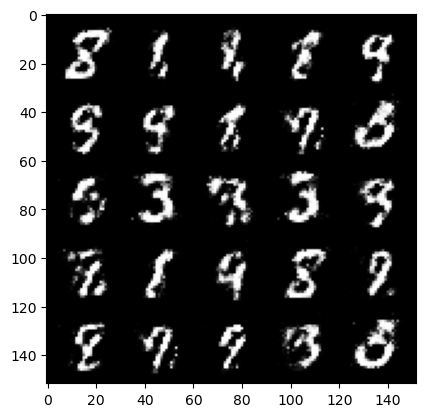

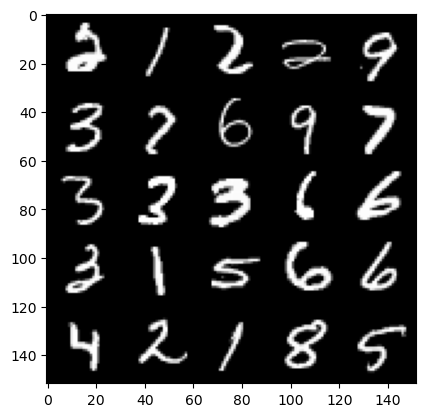

 67%|██████▋   | 315/469 [00:07<00:03, 42.00it/s]

Step 50500: Generator loss: 2.0716343326568607, discriminator loss: 0.33912655767798416


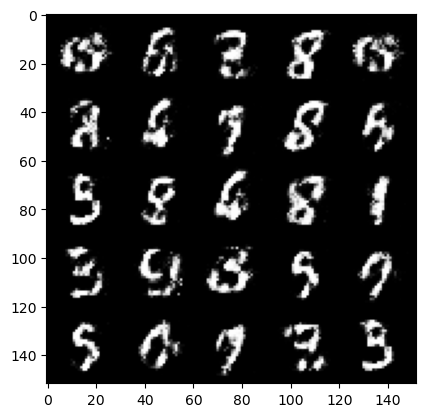

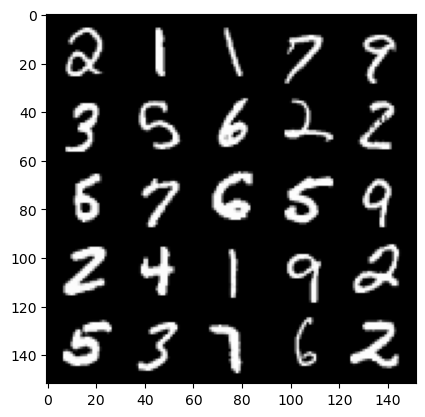

 74%|███████▎  | 345/469 [00:07<00:02, 42.89it/s]

Step 51000: Generator loss: 1.9994404871463778, discriminator loss: 0.3533061884641646


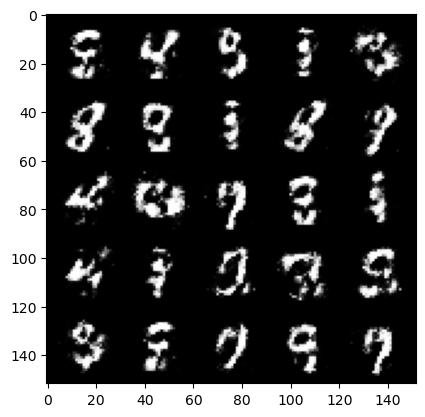

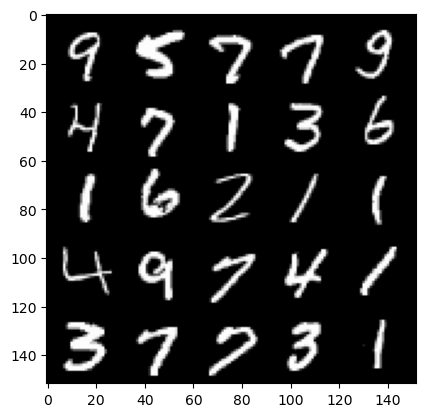

 80%|███████▉  | 375/469 [00:08<00:02, 41.61it/s]

Step 51500: Generator loss: 1.9858543777465822, discriminator loss: 0.3618499583601952


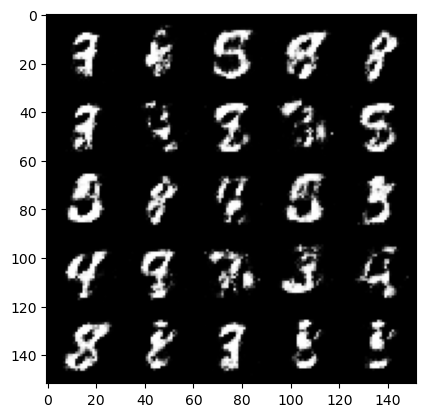

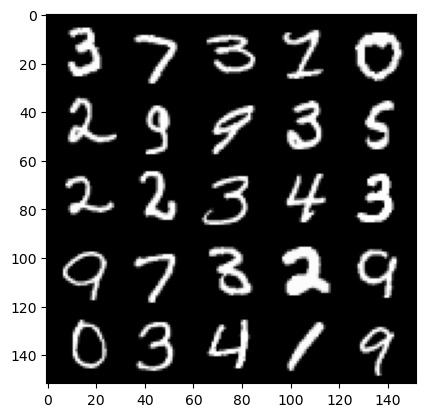

 87%|████████▋ | 410/469 [00:09<00:01, 43.25it/s]

Step 52000: Generator loss: 1.9601328711509713, discriminator loss: 0.3596918810606005


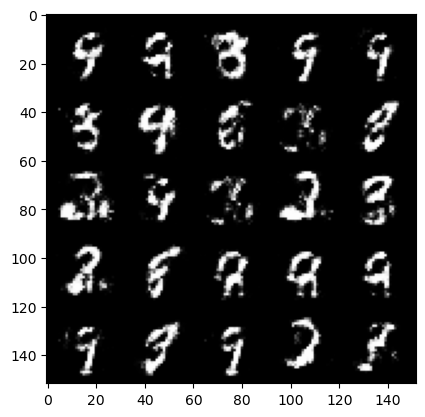

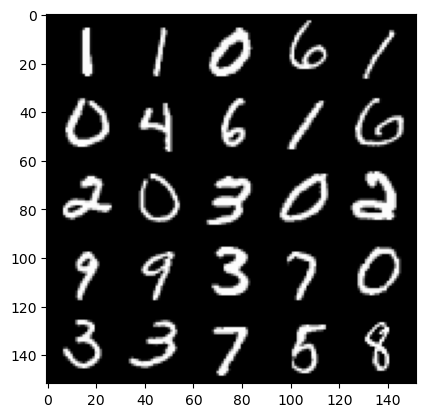

 94%|█████████▍| 440/469 [00:10<00:00, 43.52it/s]

Step 52500: Generator loss: 2.0154492840766904, discriminator loss: 0.34364450839161875


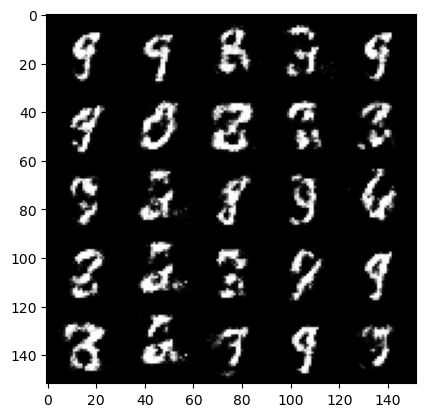

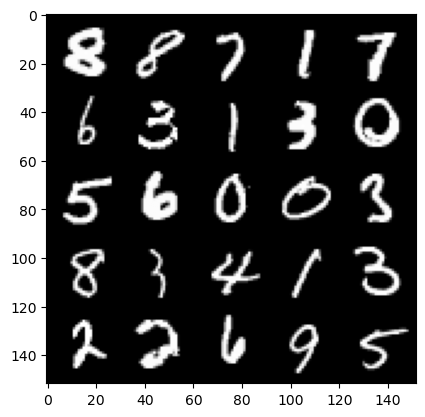

  0%|          | 0/469 [00:00<?, ?it/s]

Step 53000: Generator loss: 1.9568544204235094, discriminator loss: 0.3607865638136866


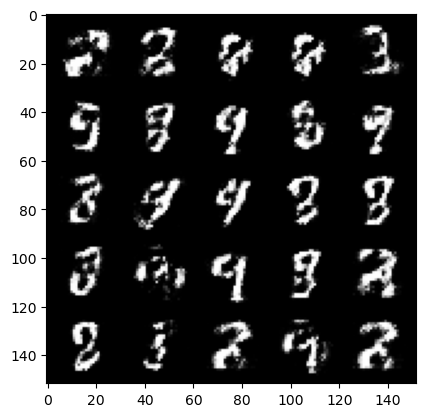

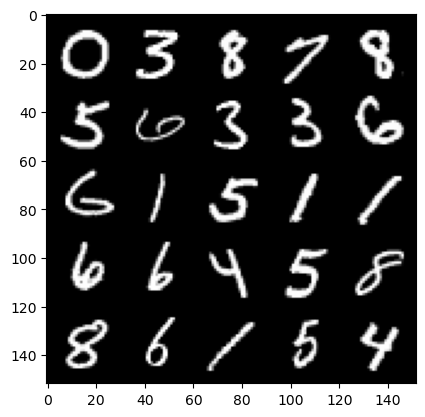

  6%|▋         | 30/469 [00:00<00:10, 41.62it/s]

Step 53500: Generator loss: 2.090742149591447, discriminator loss: 0.3203075662851331


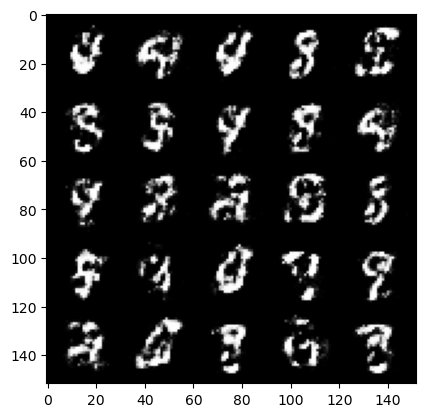

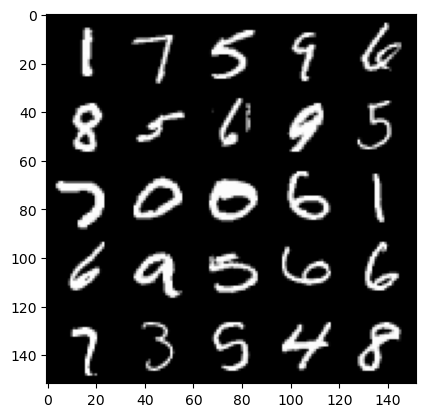

 14%|█▎        | 64/469 [00:01<00:09, 43.18it/s]

Step 54000: Generator loss: 1.9601380147933938, discriminator loss: 0.3615420396924018


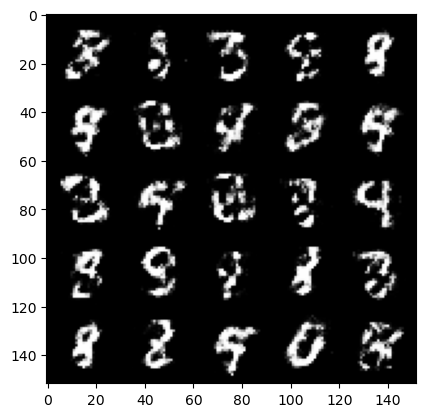

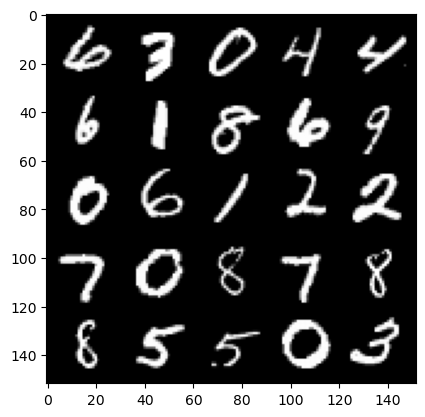

 20%|██        | 95/469 [00:02<00:08, 43.07it/s]

Step 54500: Generator loss: 2.0242865626811977, discriminator loss: 0.3478054371476172


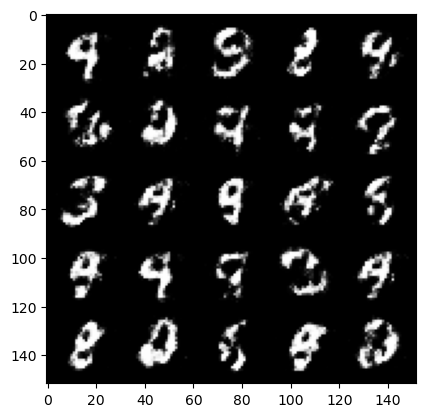

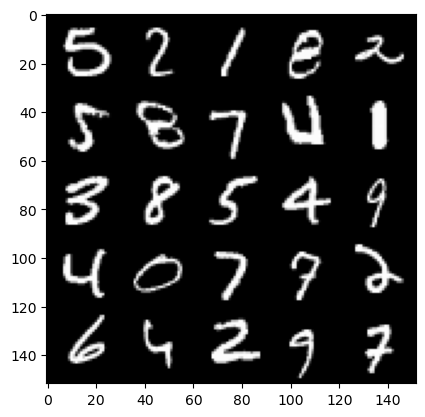

 27%|██▋       | 125/469 [00:02<00:08, 42.71it/s]

Step 55000: Generator loss: 1.9146962673664087, discriminator loss: 0.38096977305412294


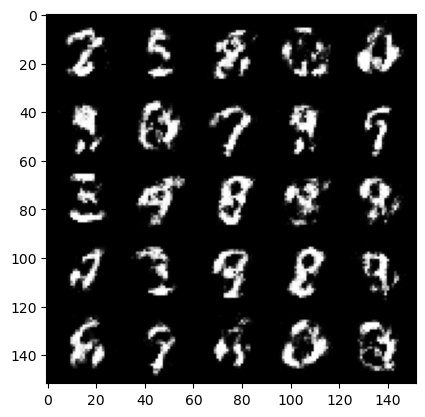

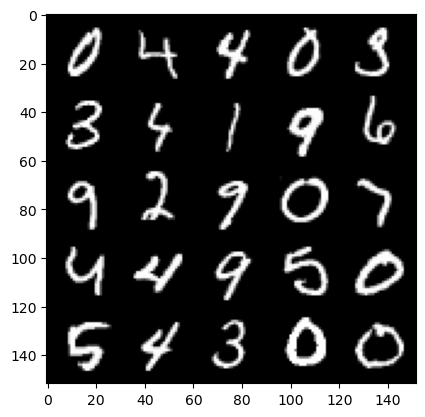

 33%|███▎      | 156/469 [00:03<00:07, 42.13it/s]

Step 55500: Generator loss: 1.954114115715026, discriminator loss: 0.3579833019971848


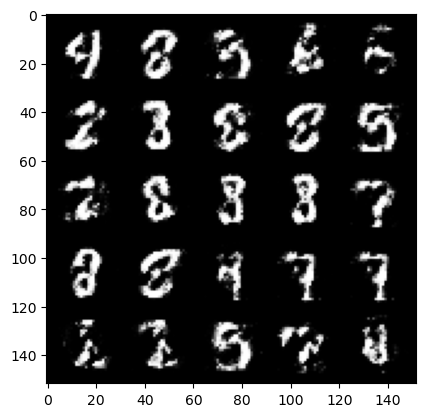

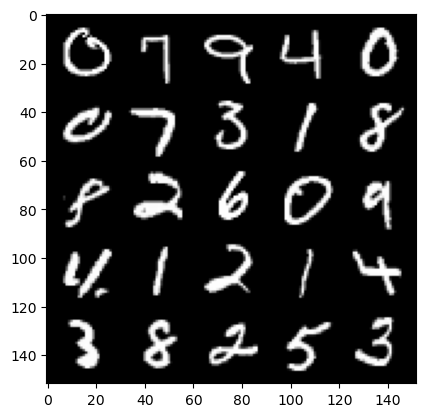

 40%|████      | 189/469 [00:04<00:07, 38.99it/s]

Step 56000: Generator loss: 1.9596837086677528, discriminator loss: 0.36347734266519527


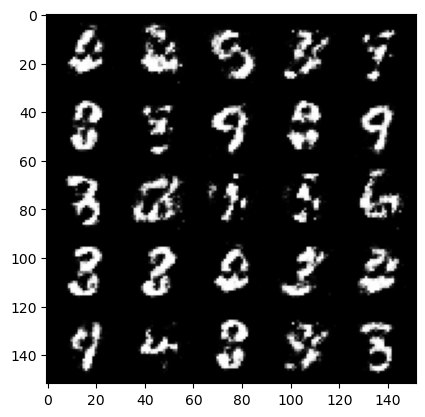

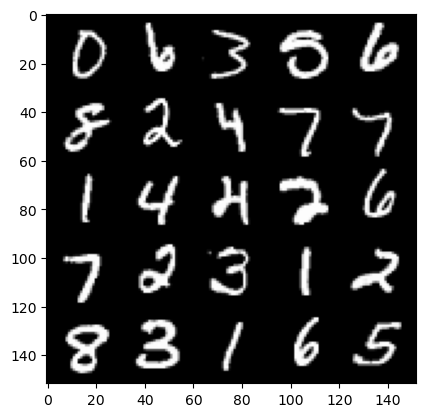

 46%|████▋     | 218/469 [00:05<00:05, 42.95it/s]

Step 56500: Generator loss: 1.9009129021167752, discriminator loss: 0.370260605573654


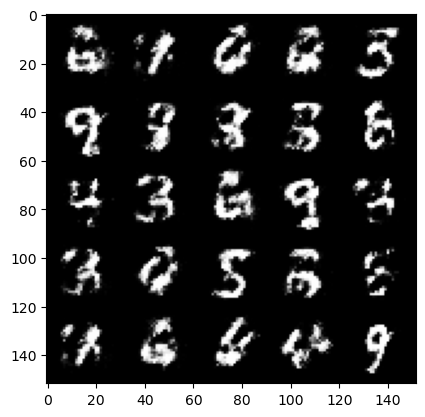

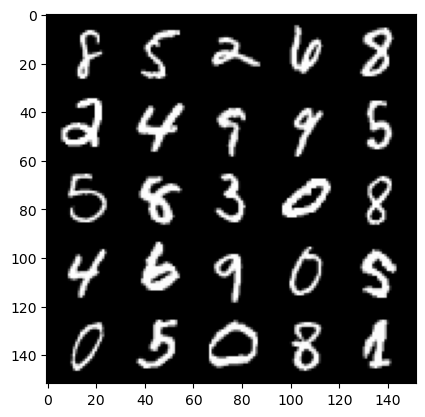

 53%|█████▎    | 250/469 [00:05<00:05, 41.81it/s]

Step 57000: Generator loss: 1.8695173406600962, discriminator loss: 0.3689264436364175


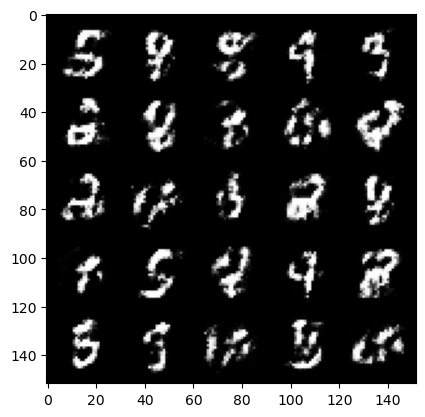

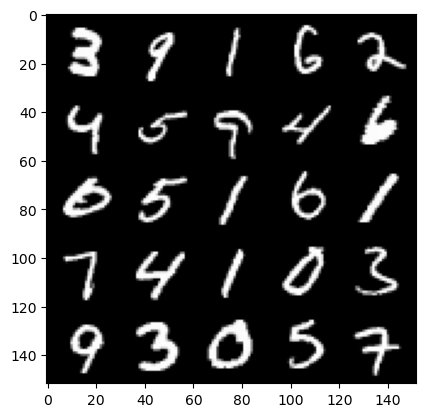

 60%|█████▉    | 280/469 [00:06<00:04, 40.63it/s]

Step 57500: Generator loss: 1.8956331703662879, discriminator loss: 0.3617466210126878


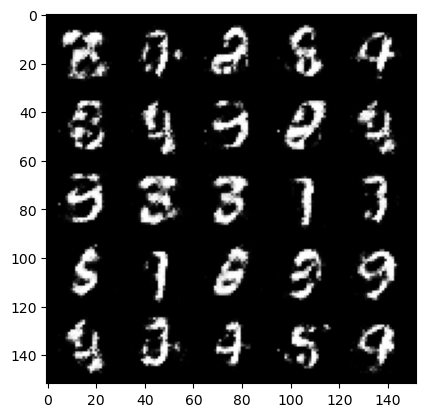

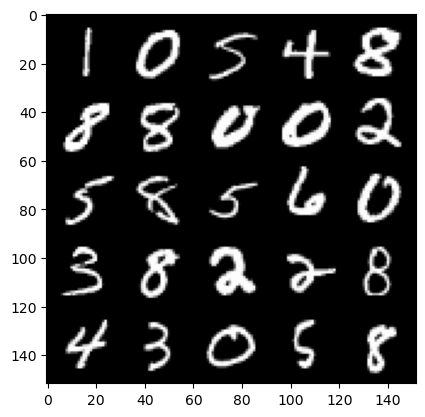

 66%|██████▌   | 309/469 [00:07<00:03, 42.95it/s]

Step 58000: Generator loss: 1.9179921162128435, discriminator loss: 0.3638433893322942


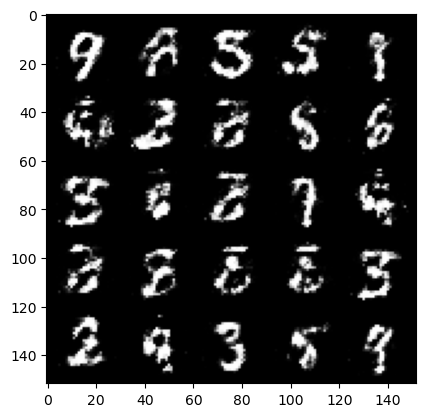

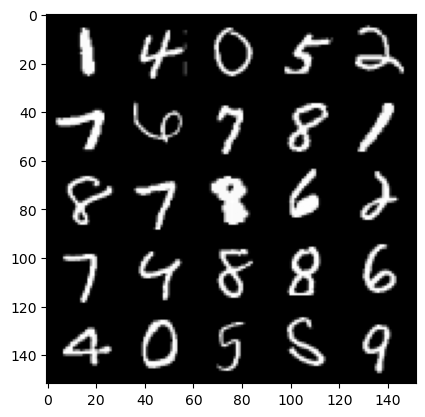

 72%|███████▏  | 340/469 [00:07<00:02, 43.31it/s]

Step 58500: Generator loss: 1.792043838739396, discriminator loss: 0.4024087998867036


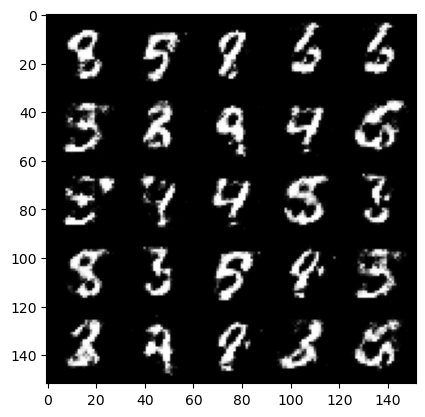

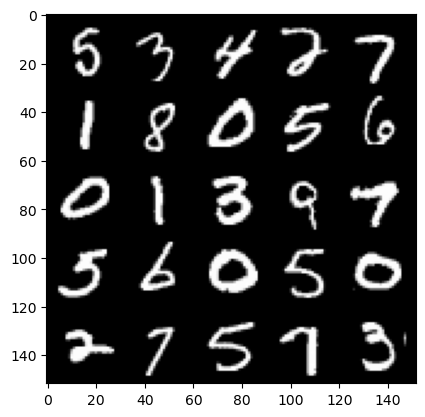

 80%|███████▉  | 375/469 [00:08<00:02, 42.16it/s]

Step 59000: Generator loss: 1.8327633726596848, discriminator loss: 0.3687010924816134


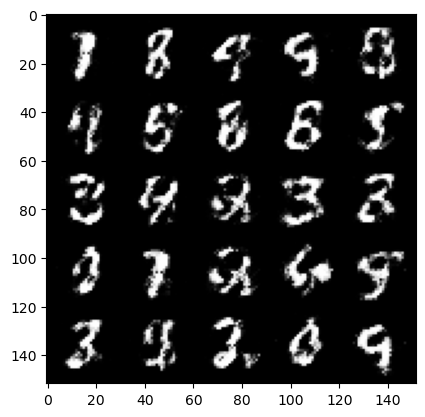

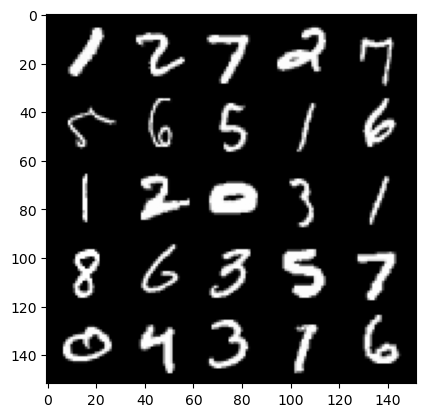

 86%|████████▋ | 405/469 [00:09<00:01, 42.93it/s]

Step 59500: Generator loss: 1.8263561422824859, discriminator loss: 0.37295304137468366


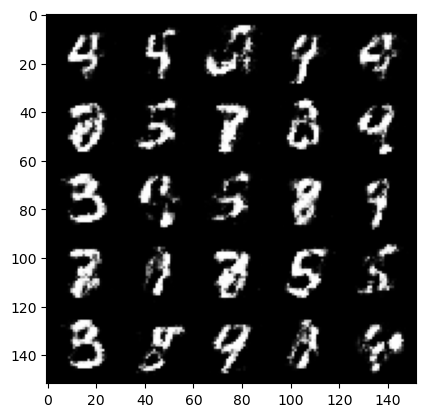

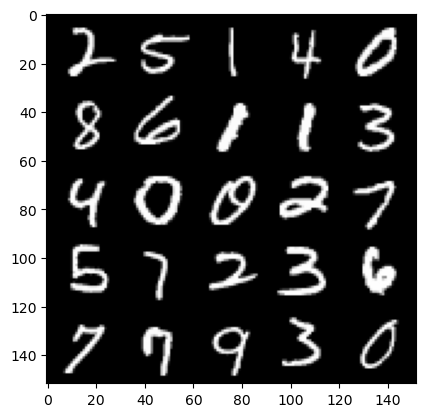

 93%|█████████▎| 435/469 [00:10<00:00, 43.04it/s]

Step 60000: Generator loss: 1.8006556384563468, discriminator loss: 0.39035827457904787


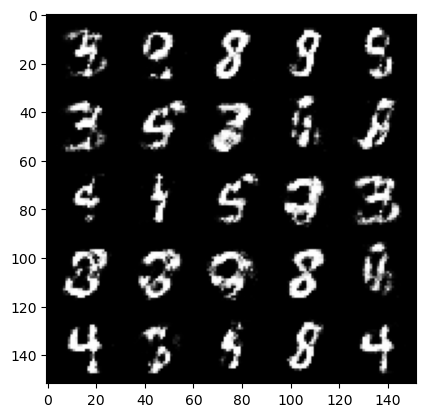

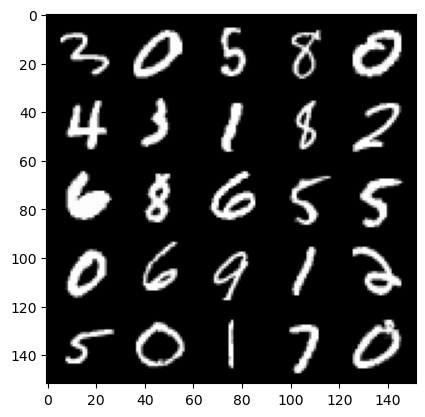

 99%|█████████▉| 464/469 [00:10<00:00, 41.67it/s]

Step 60500: Generator loss: 1.8315606184005744, discriminator loss: 0.3653434160947797


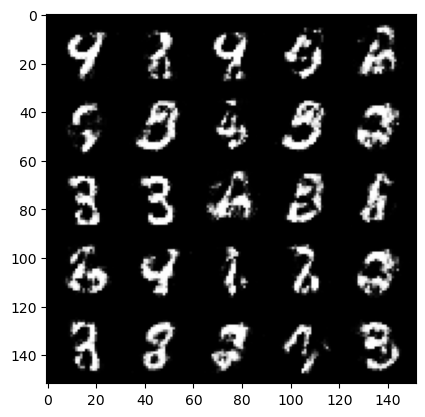

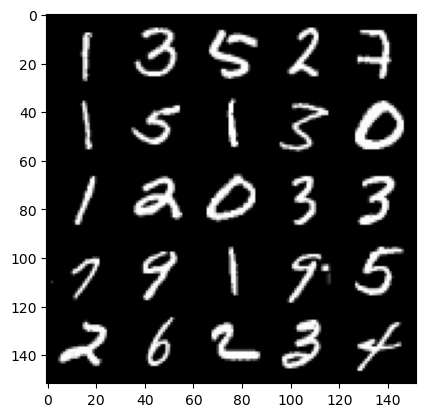

  6%|▋         | 30/469 [00:00<00:10, 42.39it/s]

Step 61000: Generator loss: 1.8071794750690446, discriminator loss: 0.36845734608173347


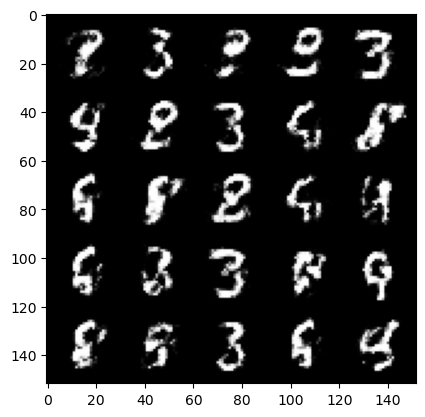

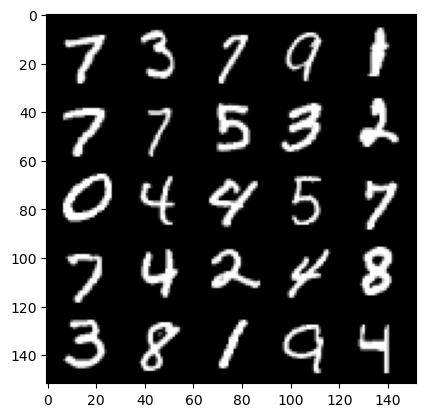

 13%|█▎        | 60/469 [00:01<00:09, 42.64it/s]

Step 61500: Generator loss: 1.8660707383155821, discriminator loss: 0.3517303550243376


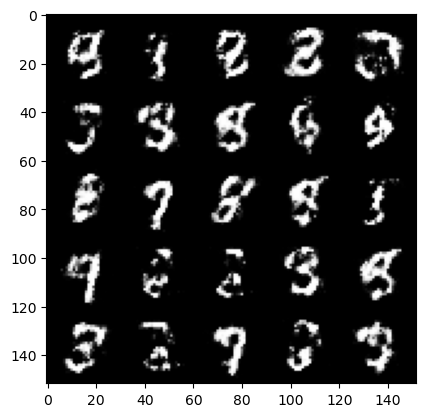

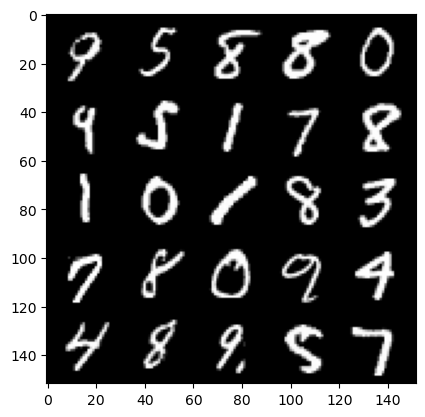

 19%|█▉        | 90/469 [00:02<00:08, 43.00it/s]

Step 62000: Generator loss: 1.8770669386386873, discriminator loss: 0.34992207410931575


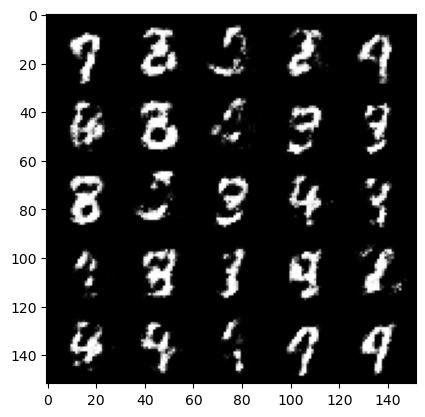

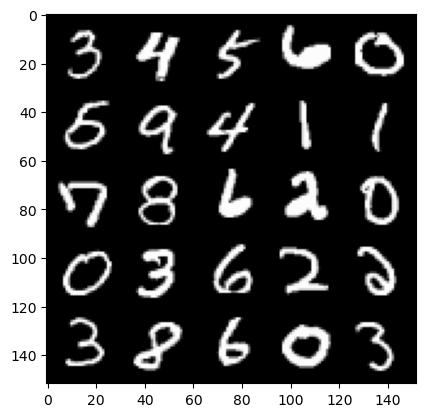

 26%|██▌       | 120/469 [00:02<00:08, 43.46it/s]

Step 62500: Generator loss: 1.847689635753631, discriminator loss: 0.3600708167552949


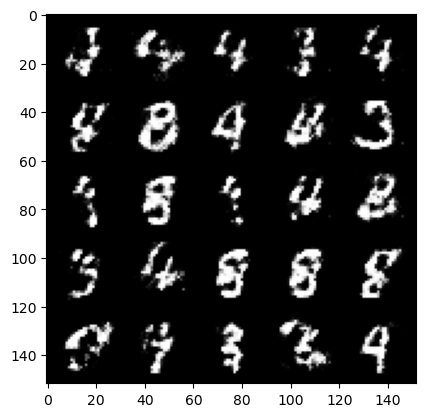

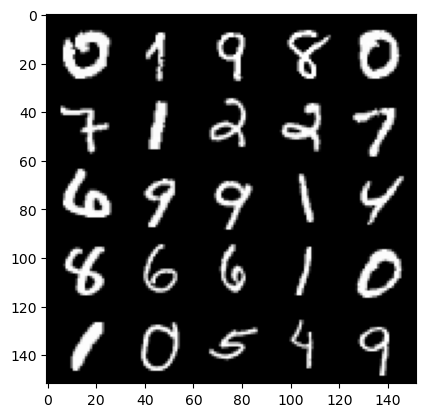

 32%|███▏      | 150/469 [00:03<00:07, 43.57it/s]

Step 63000: Generator loss: 1.8862483222484587, discriminator loss: 0.3505933279991149


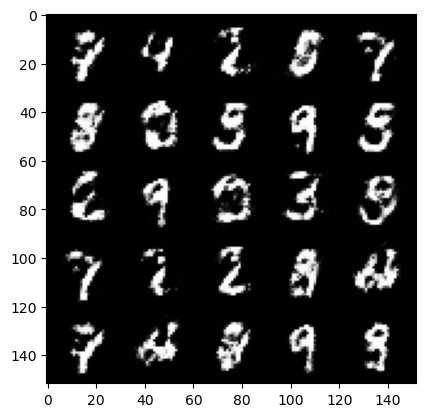

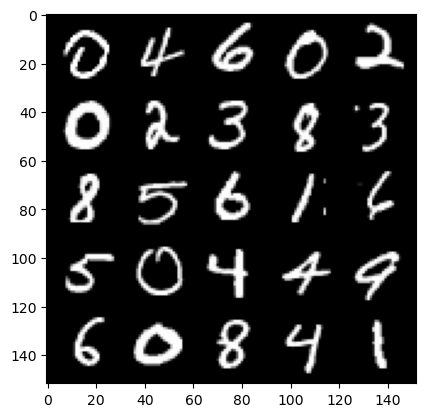

 39%|███▉      | 185/469 [00:04<00:06, 43.67it/s]

Step 63500: Generator loss: 1.891463468313216, discriminator loss: 0.3548810682296754


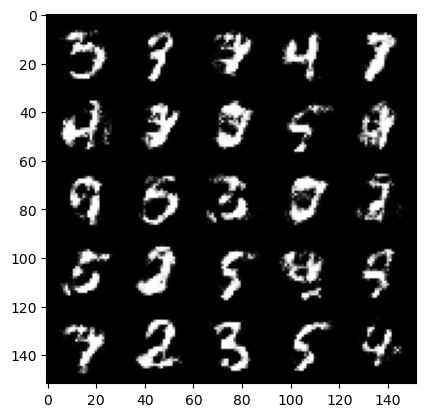

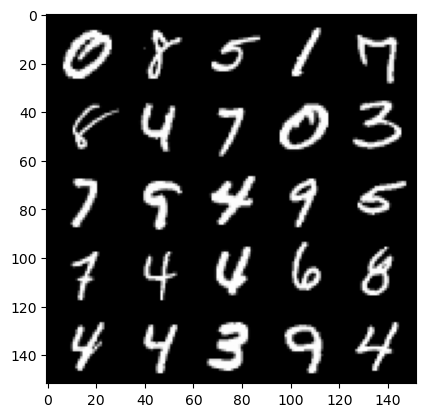

 46%|████▌     | 215/469 [00:04<00:05, 43.97it/s]

Step 64000: Generator loss: 1.7784822857379934, discriminator loss: 0.39794554781913793


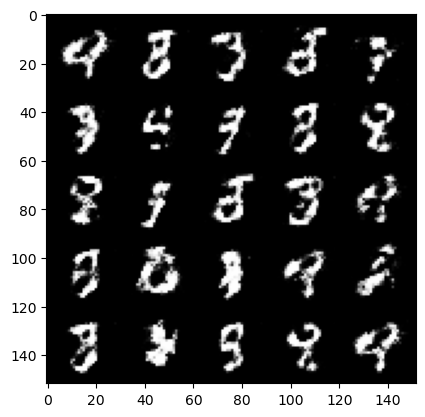

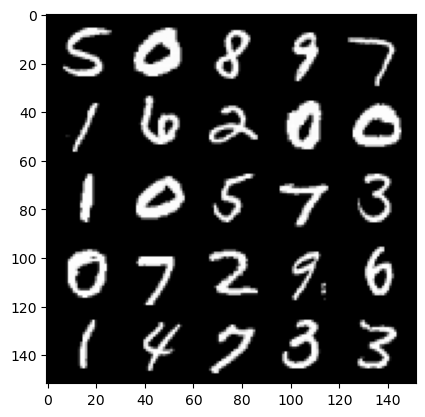

 52%|█████▏    | 245/469 [00:05<00:05, 43.62it/s]

Step 64500: Generator loss: 1.6912238574028025, discriminator loss: 0.40889023095369326


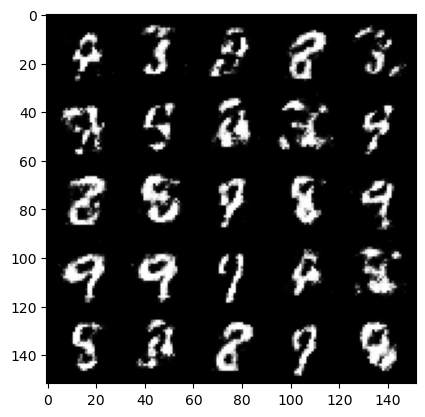

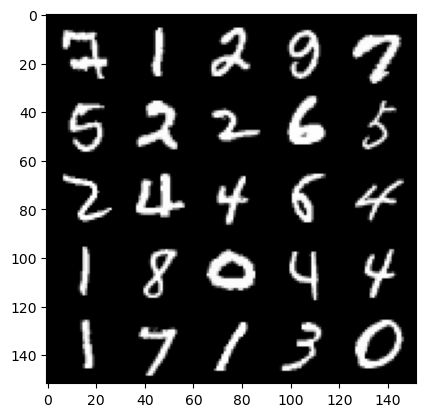

 59%|█████▊    | 275/469 [00:06<00:04, 43.87it/s]

Step 65000: Generator loss: 1.7497377803325656, discriminator loss: 0.3828810027241703


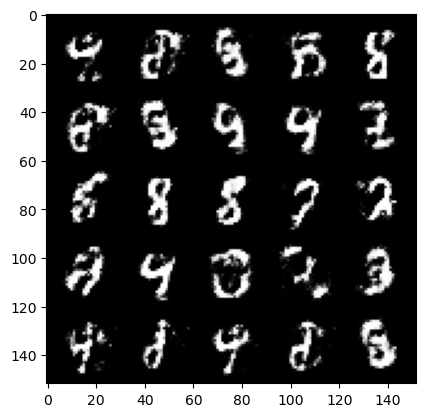

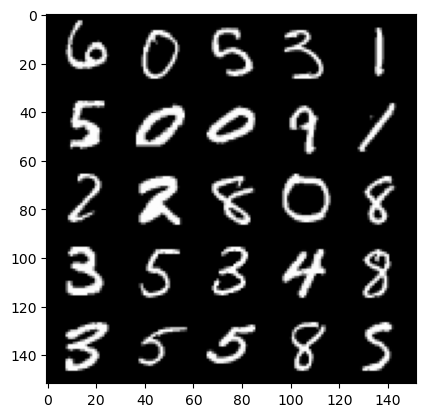

 65%|██████▌   | 305/469 [00:06<00:03, 43.80it/s]

Step 65500: Generator loss: 1.8131721768379219, discriminator loss: 0.3782605667114257


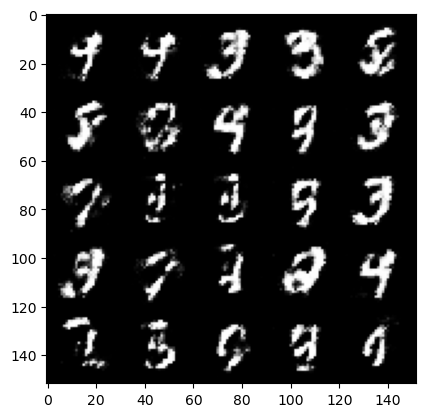

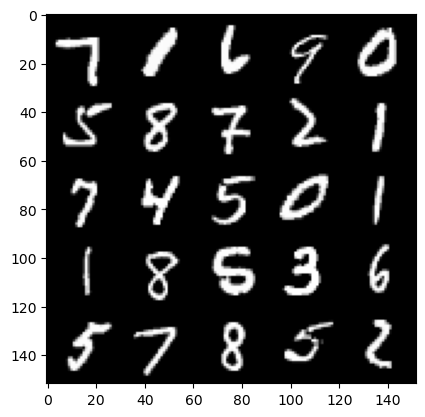

 72%|███████▏  | 340/469 [00:07<00:03, 42.85it/s]

Step 66000: Generator loss: 1.7341291520595543, discriminator loss: 0.3890309138298035


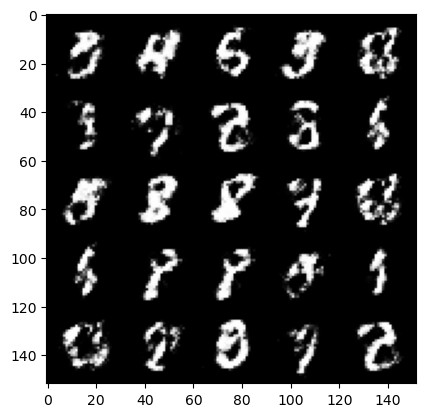

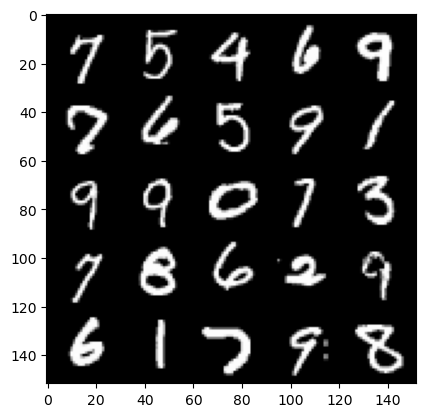

 79%|███████▊  | 369/469 [00:08<00:02, 42.90it/s]

Step 66500: Generator loss: 1.690259848833083, discriminator loss: 0.3882715357542039


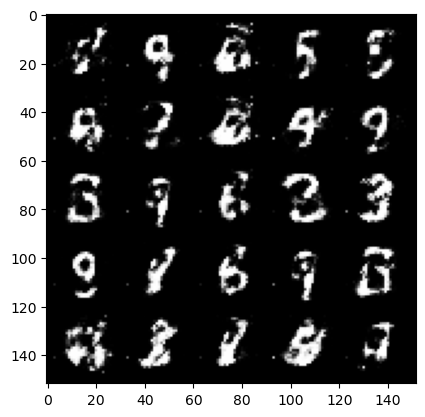

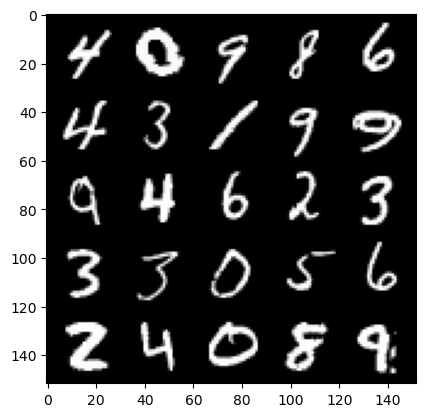

 85%|████████▌ | 400/469 [00:09<00:01, 43.77it/s]

Step 67000: Generator loss: 1.8570477898120876, discriminator loss: 0.36046303611993785


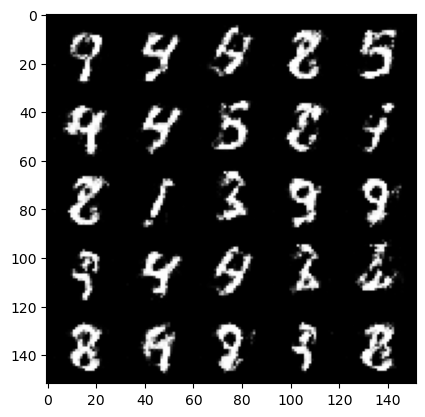

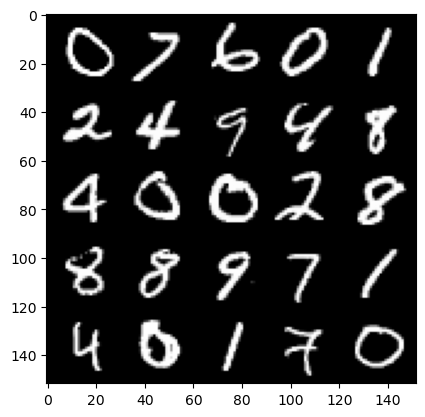

 92%|█████████▏| 430/469 [00:09<00:00, 44.22it/s]

Step 67500: Generator loss: 1.7644672467708578, discriminator loss: 0.37989124065637586


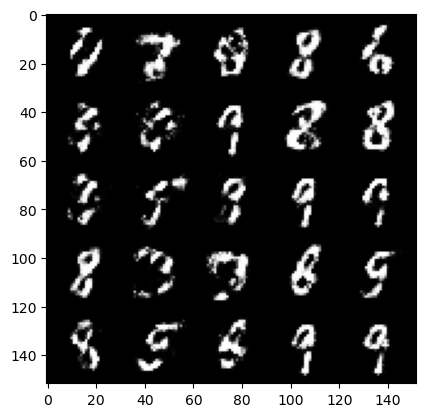

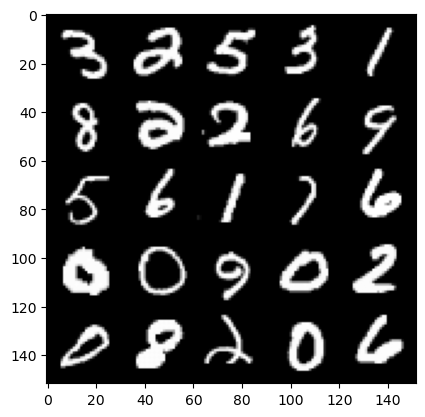

 98%|█████████▊| 460/469 [00:10<00:00, 42.79it/s]

Step 68000: Generator loss: 1.7772780950069438, discriminator loss: 0.3812069300413126


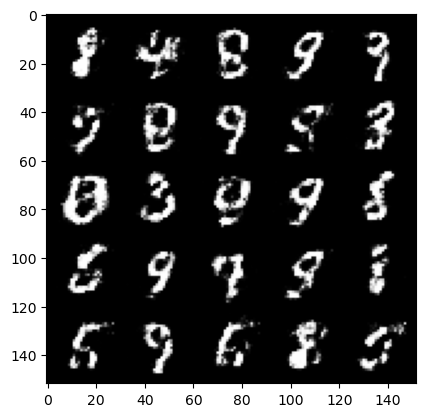

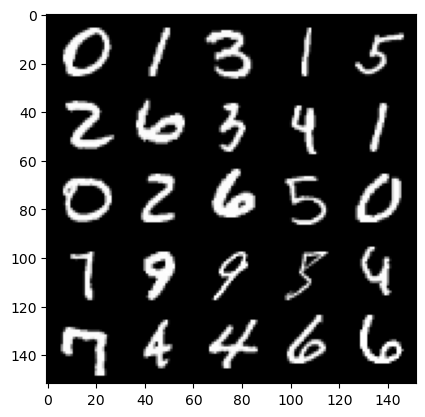

  5%|▌         | 25/469 [00:00<00:10, 43.86it/s]

Step 68500: Generator loss: 1.869589567184448, discriminator loss: 0.3548720638751986


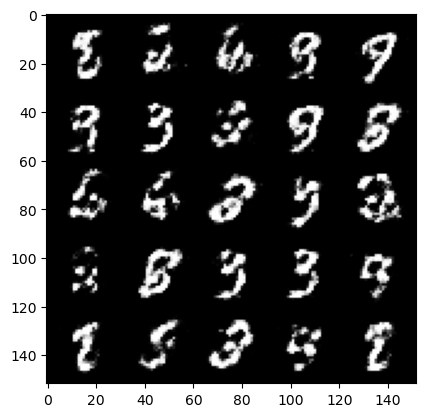

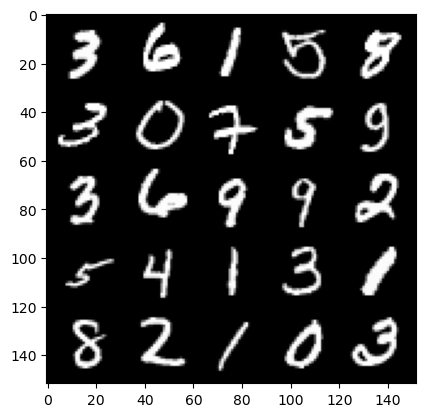

 12%|█▏        | 55/469 [00:01<00:09, 42.99it/s]

Step 69000: Generator loss: 1.8771936254501362, discriminator loss: 0.3508682960867886


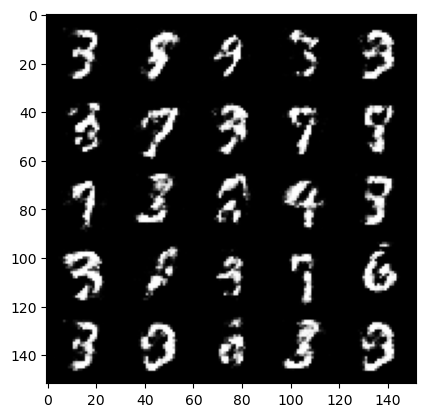

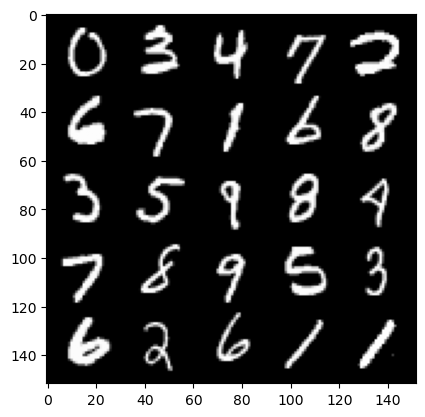

 18%|█▊        | 85/469 [00:01<00:08, 43.17it/s]

Step 69500: Generator loss: 1.751515003204346, discriminator loss: 0.3753756491839883


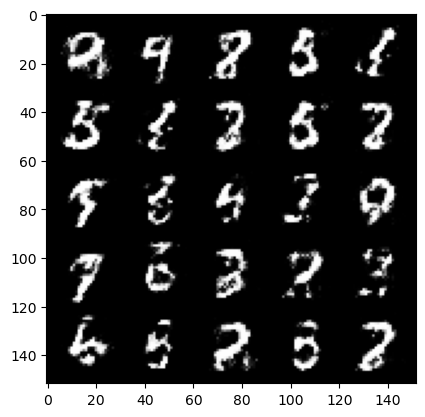

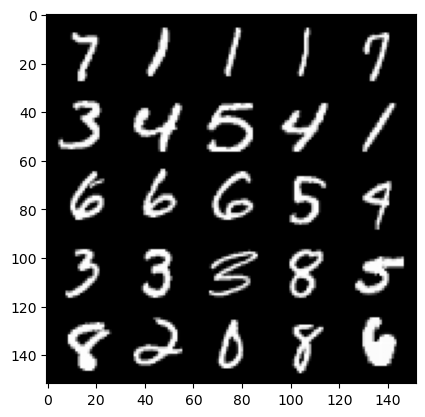

 25%|██▍       | 115/469 [00:02<00:08, 43.09it/s]

Step 70000: Generator loss: 1.8137791843414313, discriminator loss: 0.38085553851723664


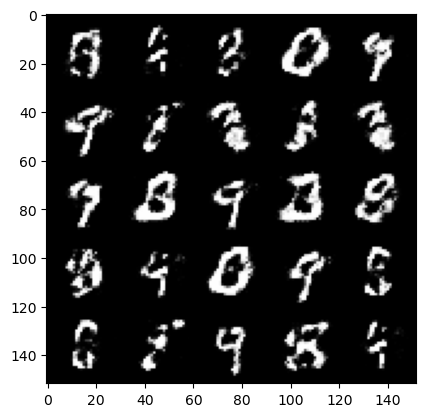

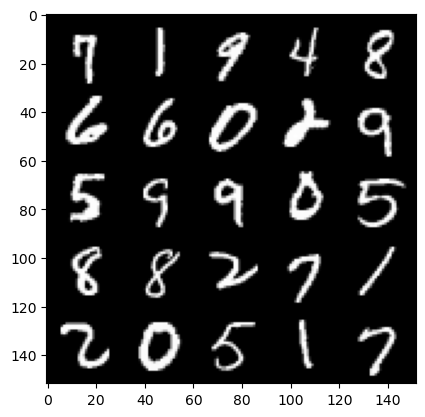

 32%|███▏      | 150/469 [00:03<00:07, 43.64it/s]

Step 70500: Generator loss: 1.7186151010990116, discriminator loss: 0.38378517609834634


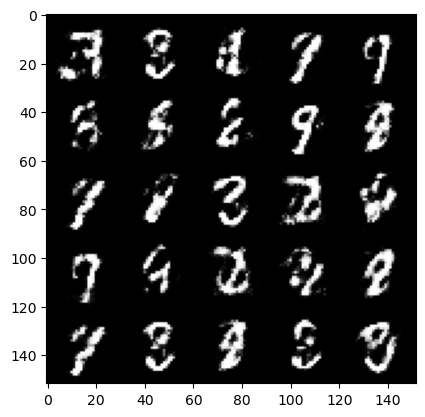

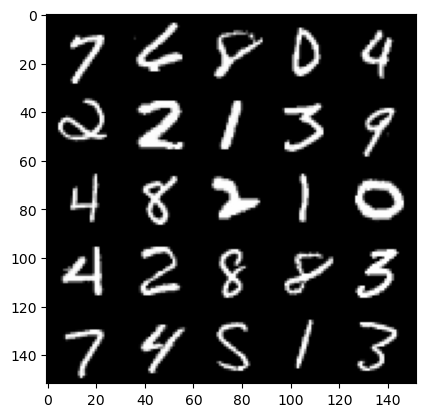

 38%|███▊      | 180/469 [00:04<00:06, 43.30it/s]

Step 71000: Generator loss: 1.8000363128185268, discriminator loss: 0.36806094068288825


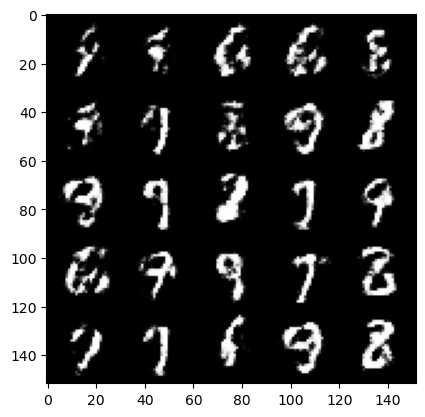

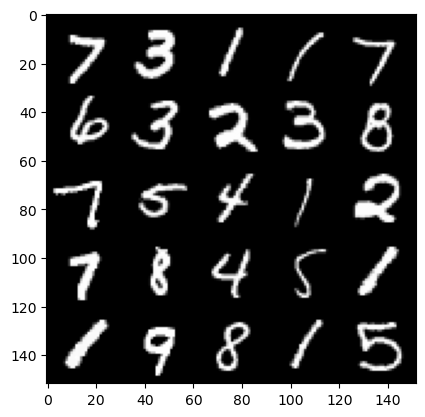

 45%|████▍     | 210/469 [00:04<00:06, 42.44it/s]

Step 71500: Generator loss: 1.6703060758113852, discriminator loss: 0.40297791516780873


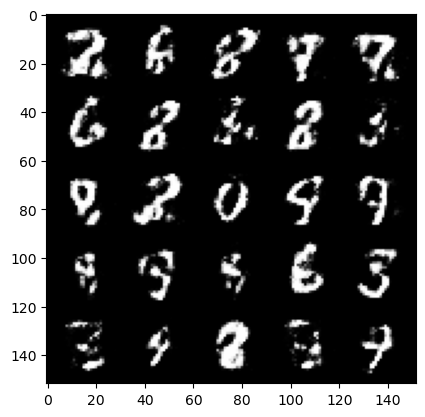

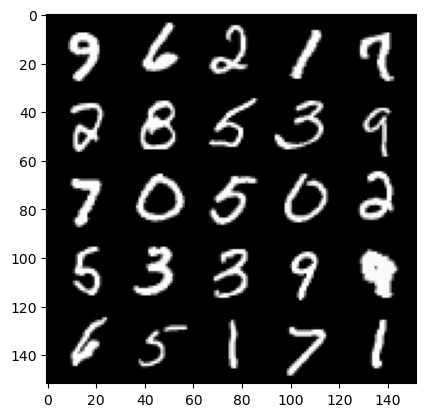

 51%|█████     | 240/469 [00:05<00:05, 43.17it/s]

Step 72000: Generator loss: 1.6887596166133887, discriminator loss: 0.3940566710233694


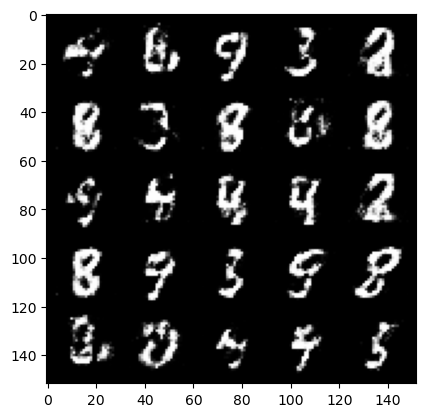

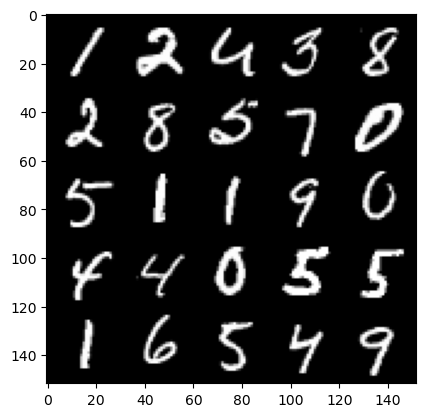

 58%|█████▊    | 270/469 [00:06<00:04, 43.59it/s]

Step 72500: Generator loss: 1.6712056469917305, discriminator loss: 0.39398192143440247


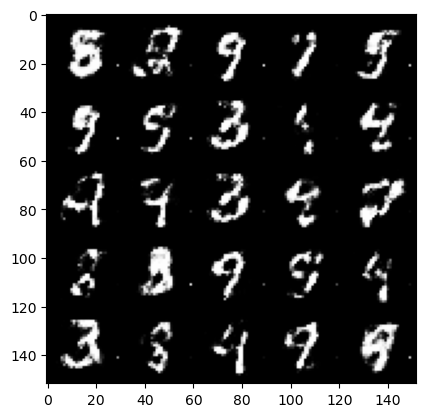

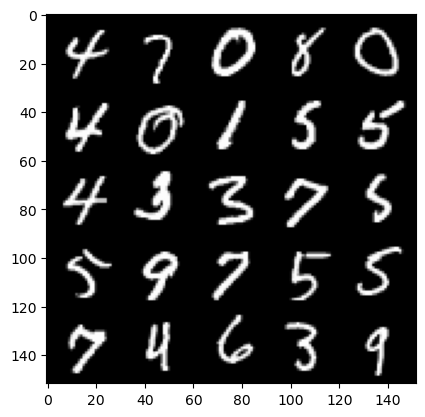

 65%|██████▌   | 305/469 [00:06<00:03, 43.97it/s]

Step 73000: Generator loss: 1.706183545351028, discriminator loss: 0.38167091113328927


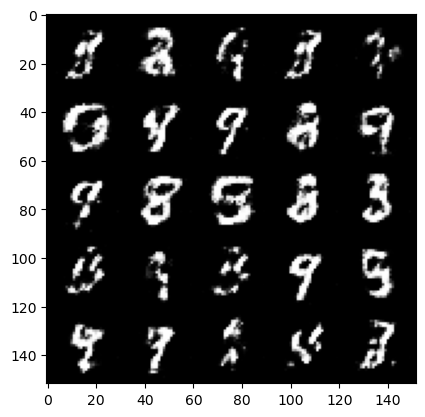

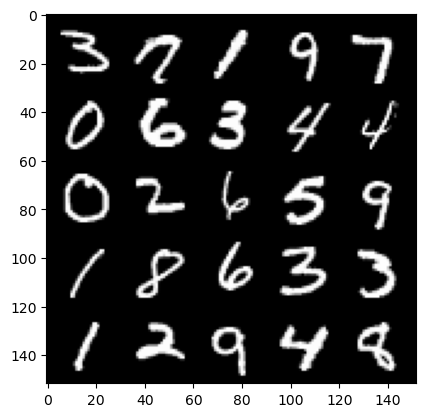

 71%|███████▏  | 335/469 [00:07<00:03, 43.42it/s]

Step 73500: Generator loss: 1.618002098798752, discriminator loss: 0.41869220125675205


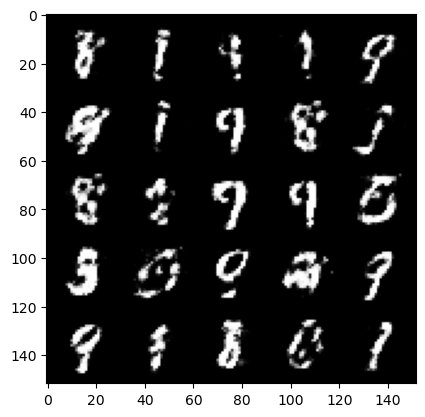

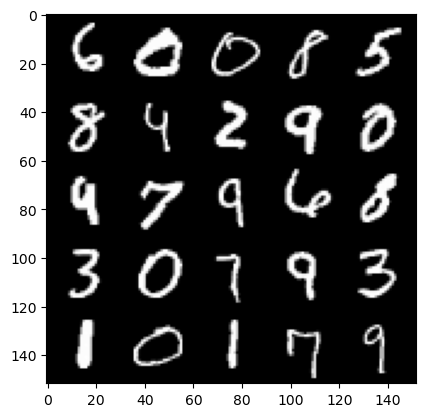

 78%|███████▊  | 365/469 [00:08<00:02, 43.37it/s]

Step 74000: Generator loss: 1.593795246839523, discriminator loss: 0.41066781026124977


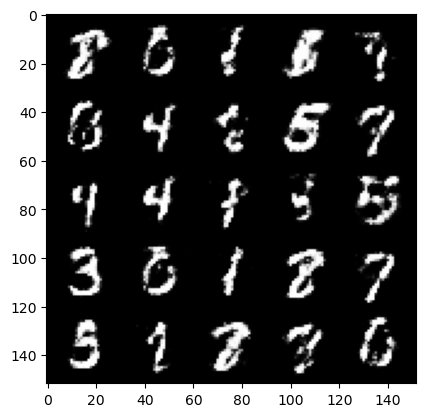

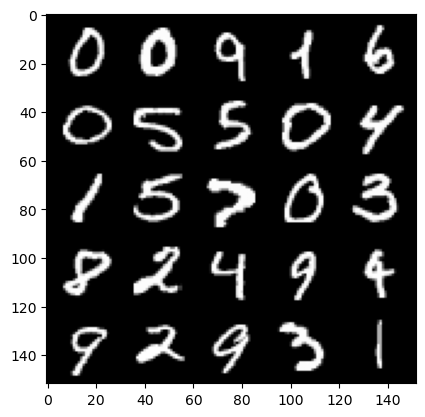

 84%|████████▍ | 395/469 [00:08<00:01, 43.58it/s]

Step 74500: Generator loss: 1.5868818330764771, discriminator loss: 0.4068108915686604


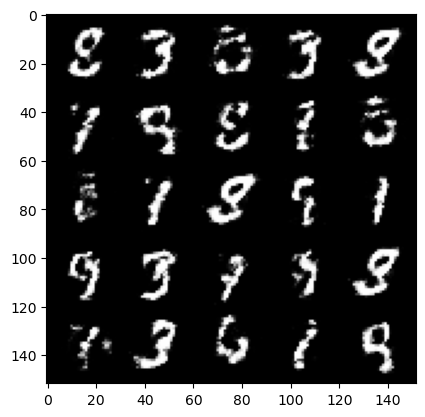

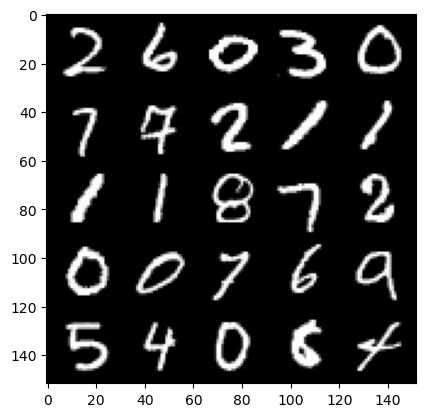

 91%|█████████ | 425/469 [00:09<00:01, 43.51it/s]

Step 75000: Generator loss: 1.696390105724335, discriminator loss: 0.3942595646977425


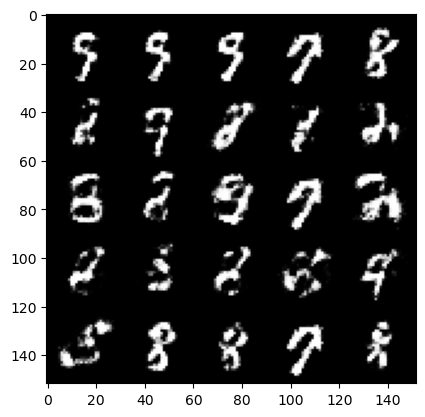

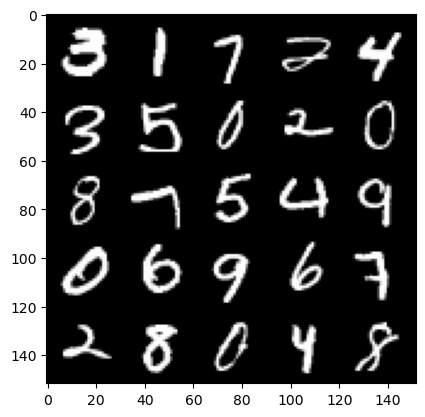

 98%|█████████▊| 460/469 [00:10<00:00, 41.39it/s]

Step 75500: Generator loss: 1.6825009510517122, discriminator loss: 0.3978482357859616


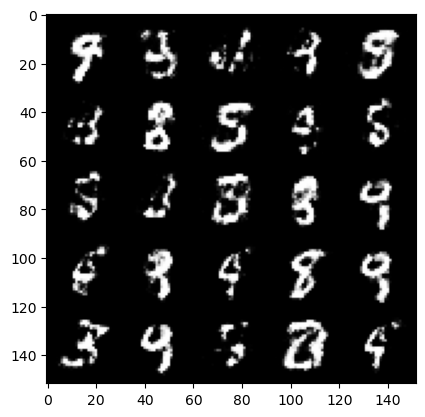

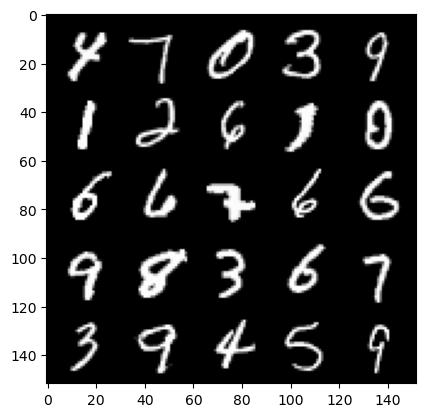

  4%|▍         | 20/469 [00:00<00:10, 43.27it/s]

Step 76000: Generator loss: 1.6376876597404486, discriminator loss: 0.4007209753990172


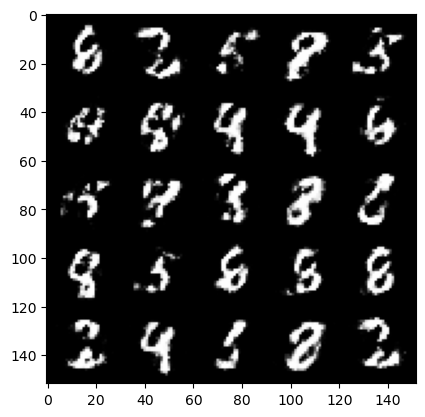

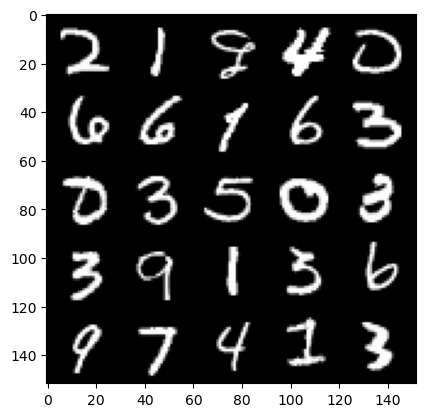

 11%|█         | 50/469 [00:01<00:09, 43.20it/s]

Step 76500: Generator loss: 1.7172167885303493, discriminator loss: 0.37364001941680897


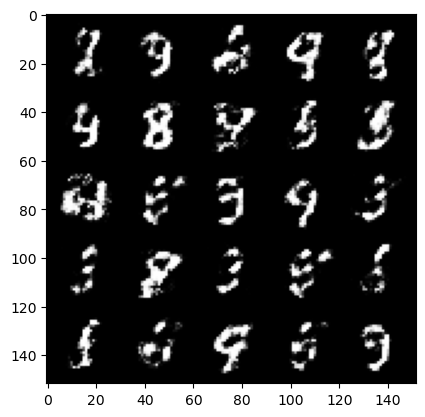

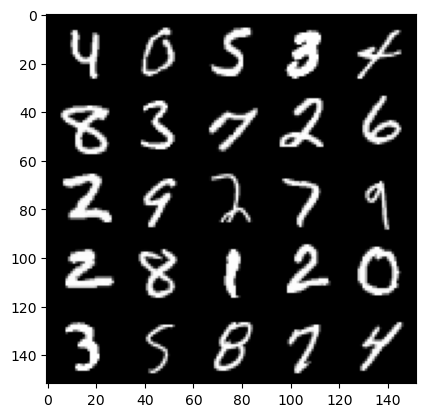

 17%|█▋        | 80/469 [00:01<00:08, 44.09it/s]

Step 77000: Generator loss: 1.6896370356082924, discriminator loss: 0.3793900530338284


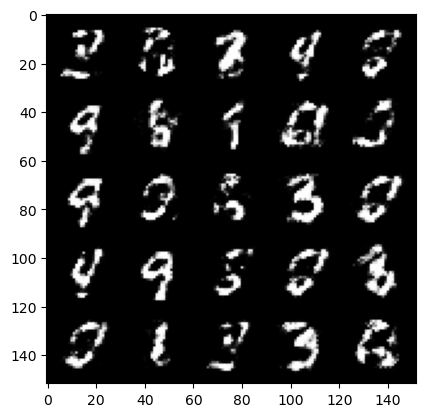

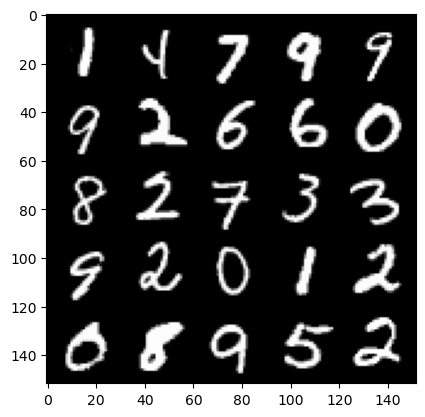

 25%|██▍       | 115/469 [00:02<00:08, 44.12it/s]

Step 77500: Generator loss: 1.7456202318668352, discriminator loss: 0.380136794149876


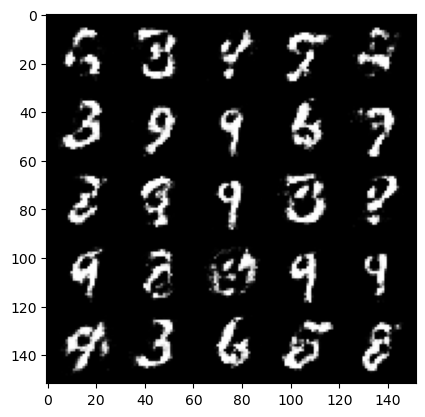

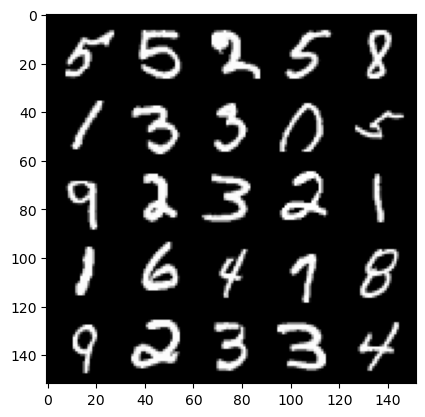

 31%|███       | 145/469 [00:03<00:07, 44.26it/s]

Step 78000: Generator loss: 1.70591964817047, discriminator loss: 0.39682531881332406


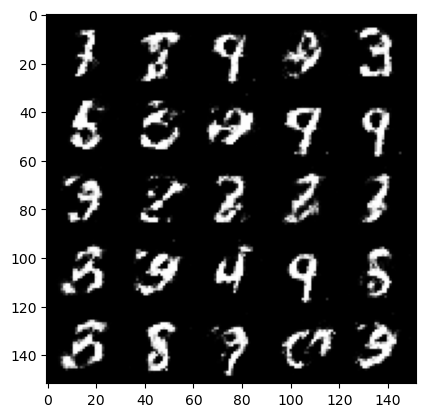

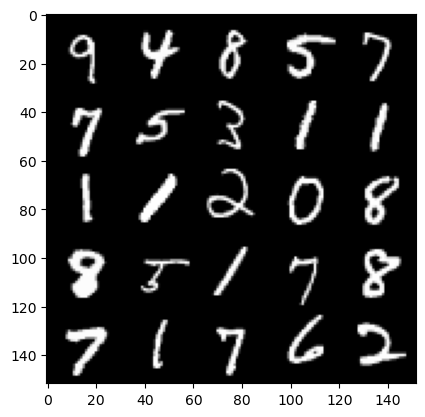

 37%|███▋      | 175/469 [00:04<00:06, 43.98it/s]

Step 78500: Generator loss: 1.7082513151168819, discriminator loss: 0.3861966465711595


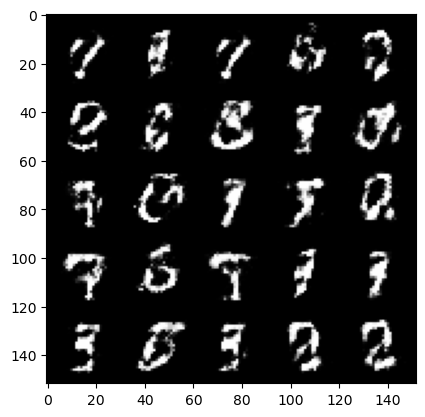

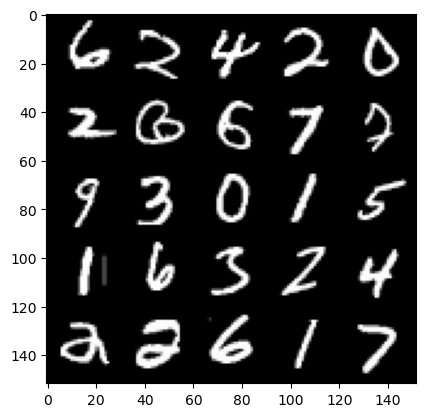

 44%|████▎     | 205/469 [00:04<00:05, 44.14it/s]

Step 79000: Generator loss: 1.7004711291790013, discriminator loss: 0.3887706495523455


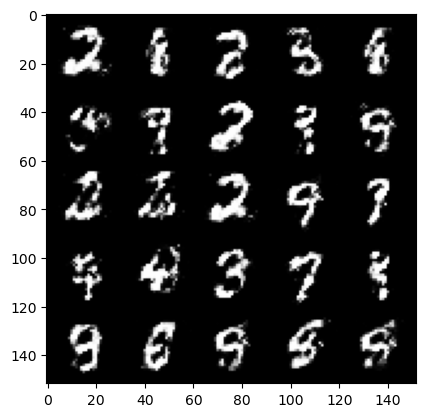

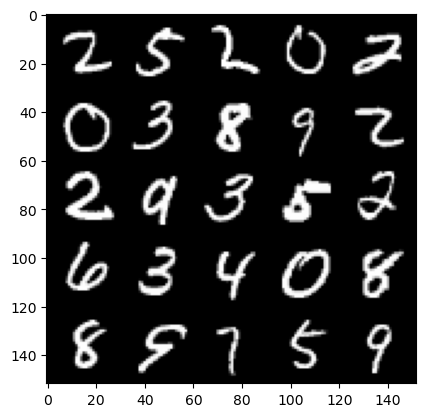

 51%|█████     | 237/469 [00:06<00:06, 36.52it/s]

Step 79500: Generator loss: 1.5879526417255407, discriminator loss: 0.43520171868801105


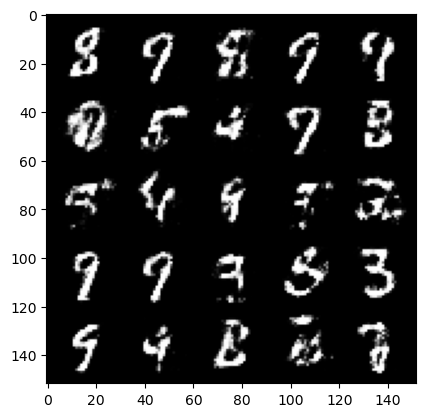

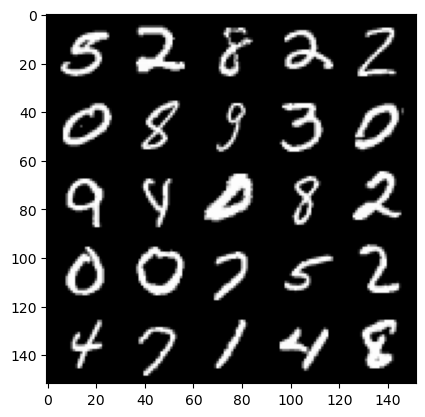

 57%|█████▋    | 268/469 [00:07<00:05, 36.96it/s]

Step 80000: Generator loss: 1.54555075955391, discriminator loss: 0.4328968452811245


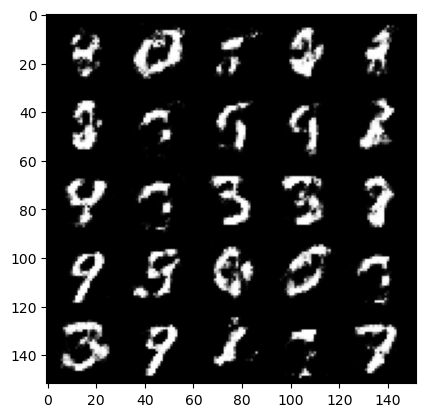

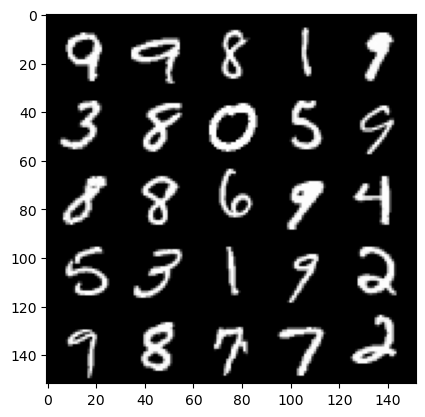

 64%|██████▍   | 300/469 [00:06<00:03, 44.10it/s]

Step 80500: Generator loss: 1.6273305242061618, discriminator loss: 0.40494802570343014


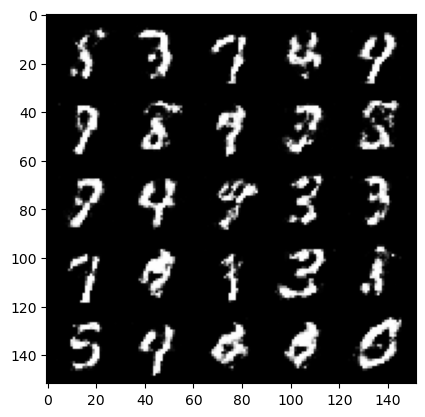

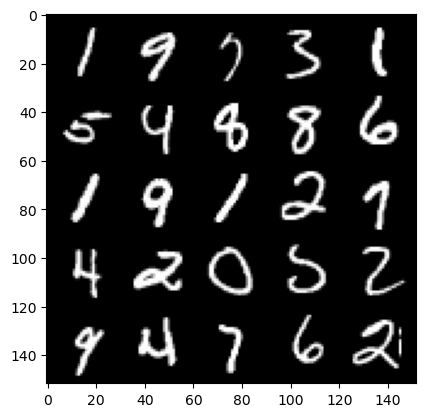

 70%|███████   | 330/469 [00:07<00:03, 43.69it/s]

Step 81000: Generator loss: 1.5518127193450943, discriminator loss: 0.421170638442039


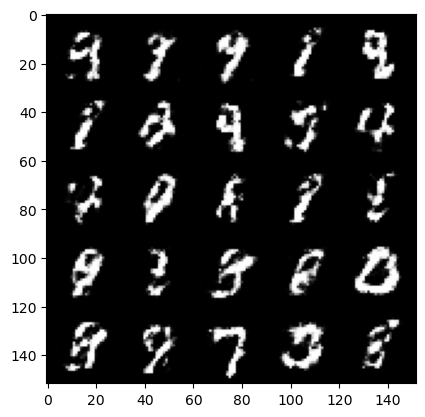

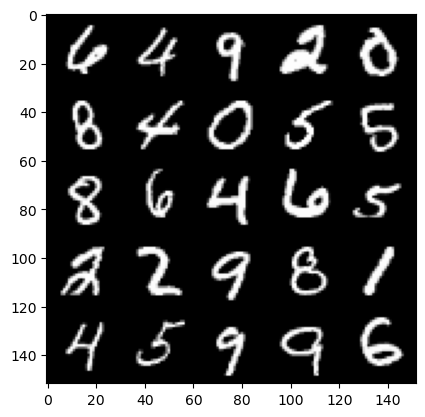

 77%|███████▋  | 360/469 [00:08<00:02, 44.27it/s]

Step 81500: Generator loss: 1.5214659006595603, discriminator loss: 0.43560006272792867


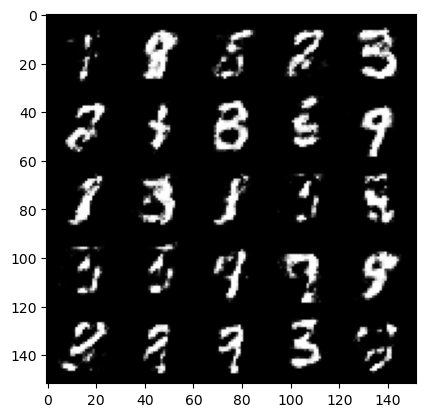

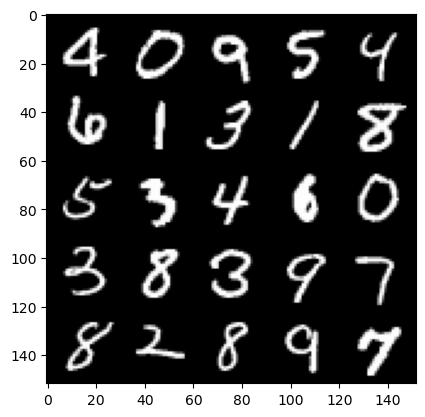

 84%|████████▍ | 394/469 [00:09<00:01, 37.88it/s]

Step 82000: Generator loss: 1.445030817270278, discriminator loss: 0.4512034252882004


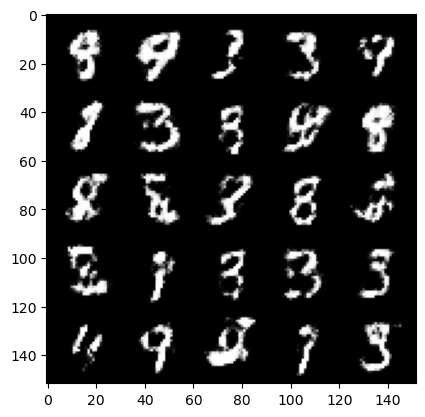

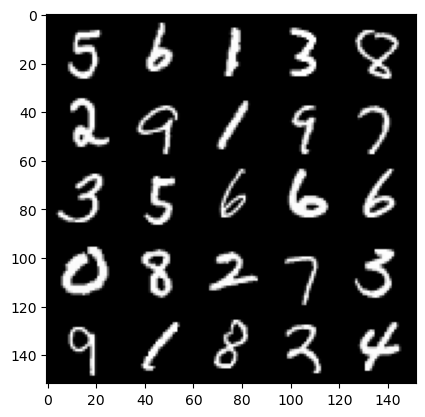

 90%|████████▉ | 422/469 [00:11<00:01, 38.01it/s]

Step 82500: Generator loss: 1.4515900878906267, discriminator loss: 0.4330996635556219


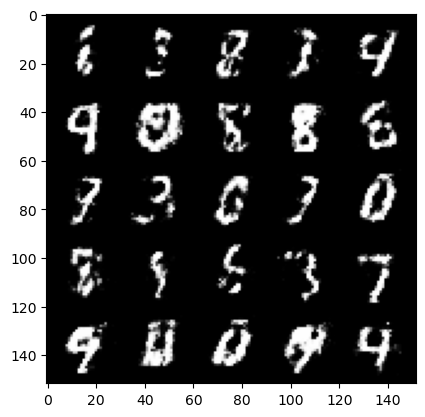

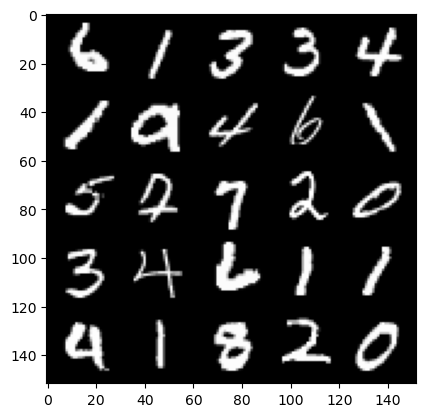

 96%|█████████▋| 452/469 [00:10<00:00, 43.02it/s]

Step 83000: Generator loss: 1.4859988279342664, discriminator loss: 0.41376073741912855


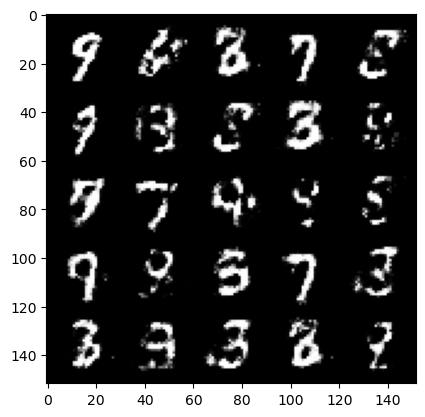

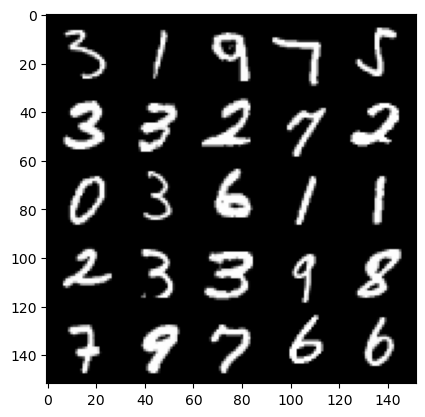

  3%|▎         | 15/469 [00:00<00:10, 41.46it/s]

Step 83500: Generator loss: 1.5295027613639829, discriminator loss: 0.4165833795070649


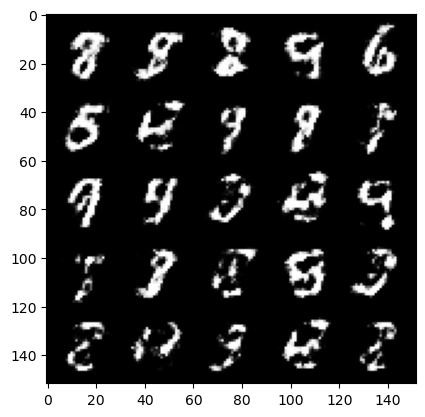

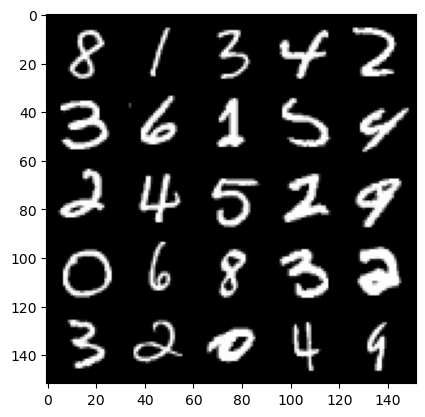

 10%|▉         | 45/469 [00:01<00:10, 41.59it/s]

Step 84000: Generator loss: 1.5327886672019966, discriminator loss: 0.41283346015214917


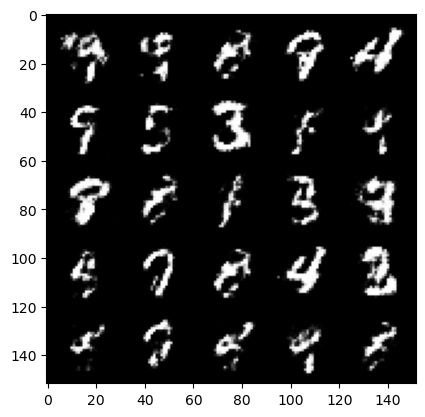

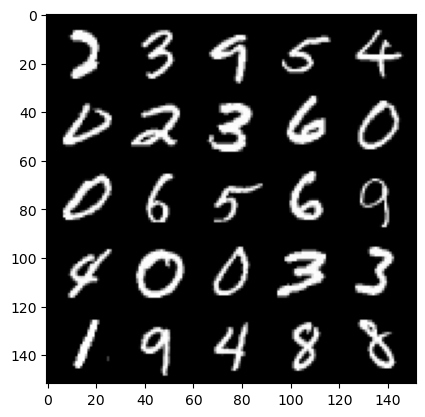

 17%|█▋        | 80/469 [00:01<00:08, 43.81it/s]

Step 84500: Generator loss: 1.5494720883369442, discriminator loss: 0.4048227947950364


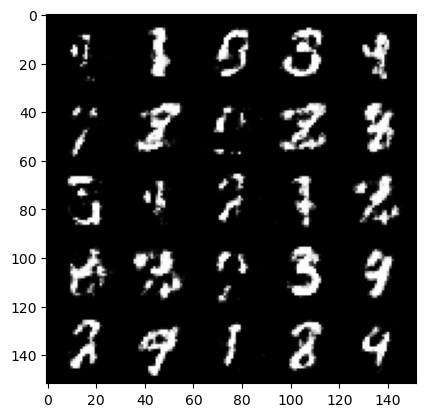

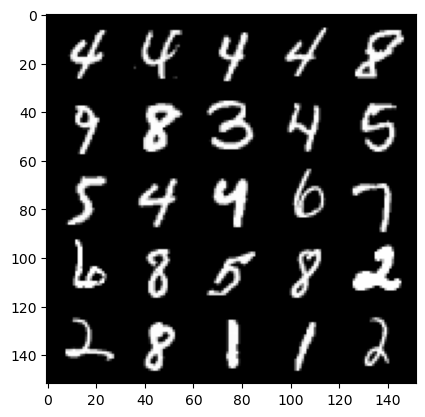

 23%|██▎       | 110/469 [00:02<00:08, 43.08it/s]

Step 85000: Generator loss: 1.5378393349647546, discriminator loss: 0.4229608051776888


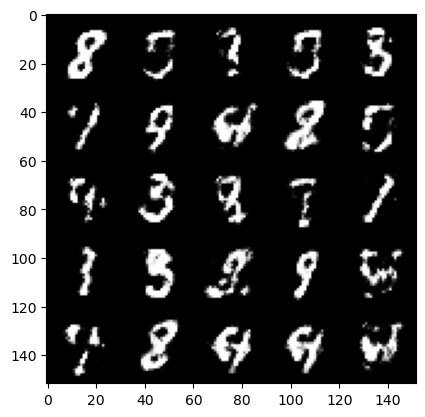

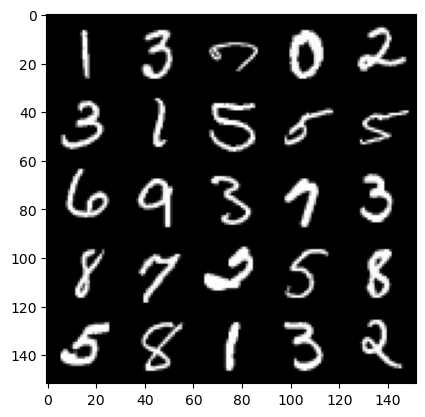

 30%|██▉       | 139/469 [00:03<00:07, 42.65it/s]

Step 85500: Generator loss: 1.4833665671348575, discriminator loss: 0.4407887044548988


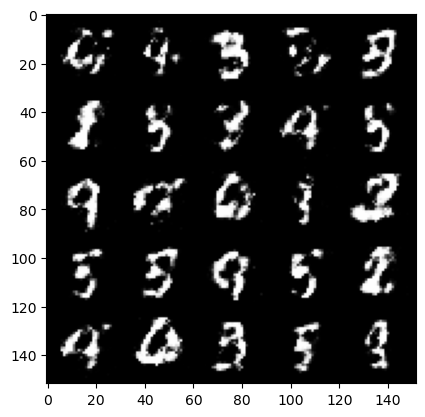

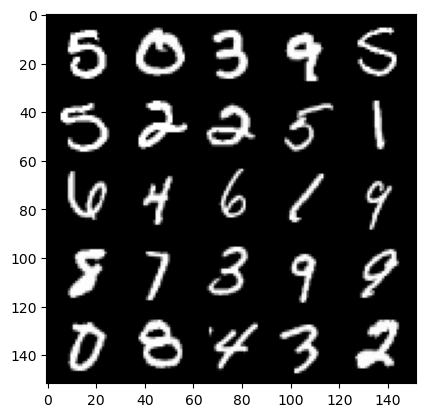

 36%|███▌      | 170/469 [00:03<00:06, 43.49it/s]

Step 86000: Generator loss: 1.4719444541931164, discriminator loss: 0.44973180598020557


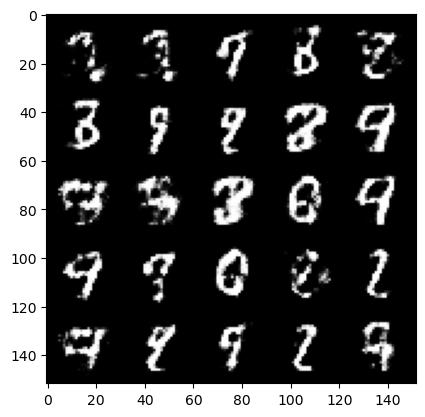

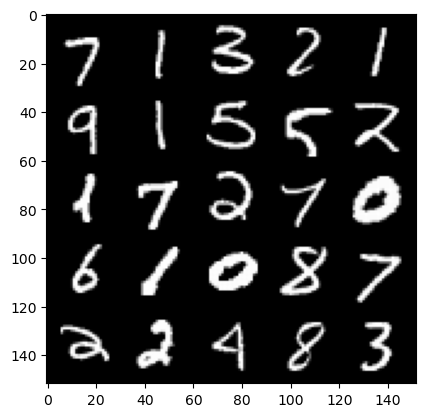

 43%|████▎     | 200/469 [00:04<00:06, 43.81it/s]

Step 86500: Generator loss: 1.473311764717103, discriminator loss: 0.44723622334003477


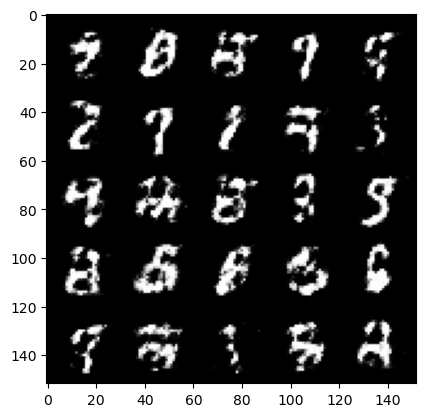

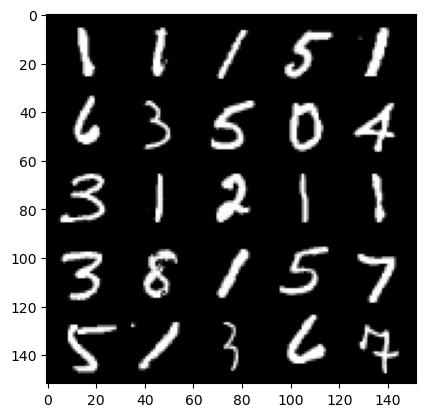

 50%|█████     | 235/469 [00:05<00:05, 44.08it/s]

Step 87000: Generator loss: 1.4735035958290117, discriminator loss: 0.4520515567064287


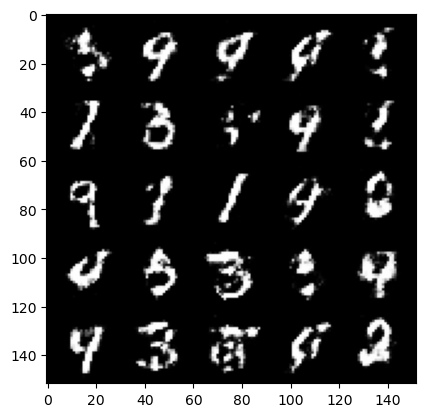

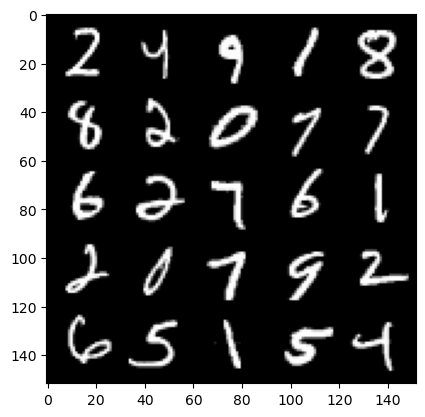

 57%|█████▋    | 265/469 [00:06<00:04, 42.66it/s]

Step 87500: Generator loss: 1.4859631516933443, discriminator loss: 0.44359536486864026


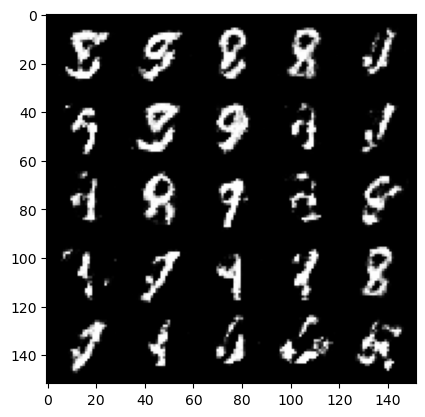

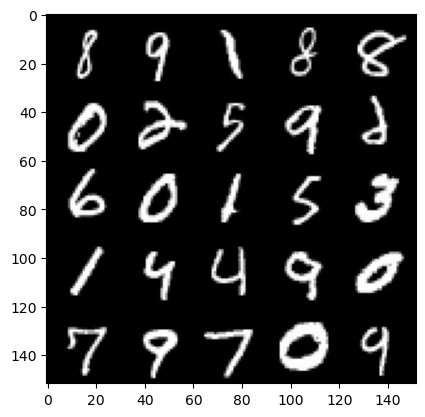

 63%|██████▎   | 295/469 [00:06<00:03, 43.97it/s]

Step 88000: Generator loss: 1.492462075471877, discriminator loss: 0.4304571691155434


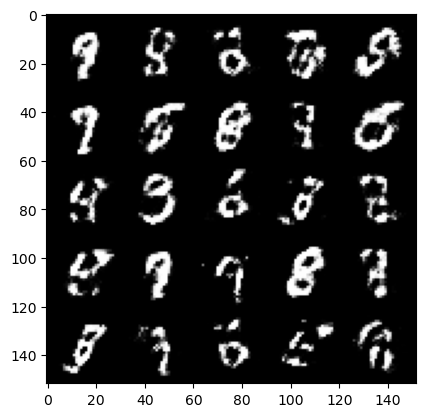

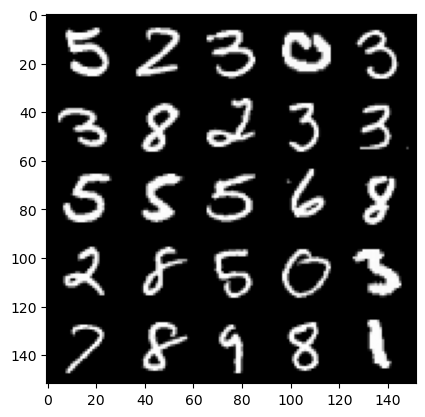

 69%|██████▉   | 325/469 [00:07<00:03, 44.04it/s]

Step 88500: Generator loss: 1.5576950323581702, discriminator loss: 0.4122651022672656


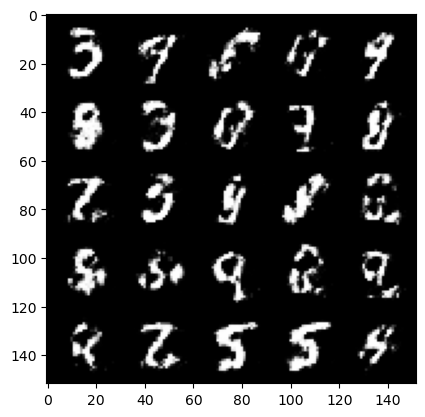

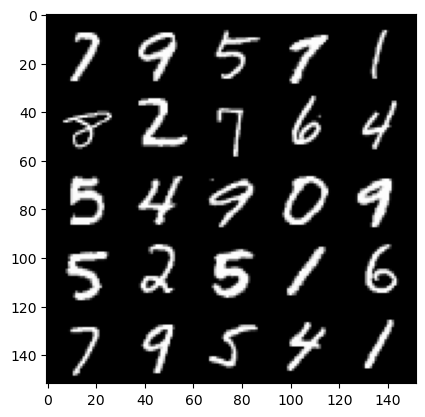

 76%|███████▌  | 355/469 [00:08<00:02, 43.64it/s]

Step 89000: Generator loss: 1.5457402448654178, discriminator loss: 0.41460679340362544


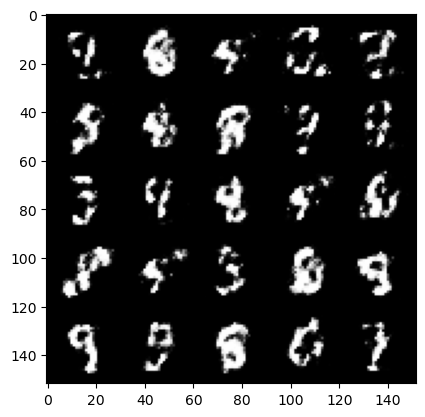

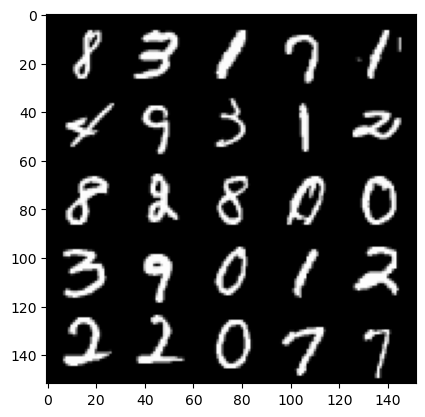

 83%|████████▎ | 390/469 [00:08<00:01, 44.39it/s]

Step 89500: Generator loss: 1.5823863611221332, discriminator loss: 0.4130042682290081


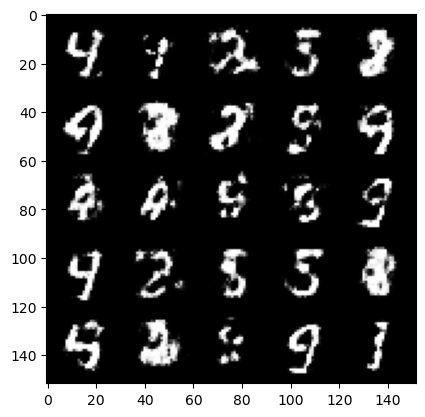

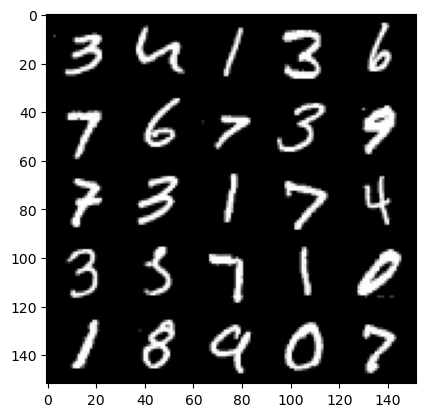

 90%|████████▉ | 420/469 [00:09<00:01, 44.84it/s]

Step 90000: Generator loss: 1.5485462422370913, discriminator loss: 0.4205399674773217


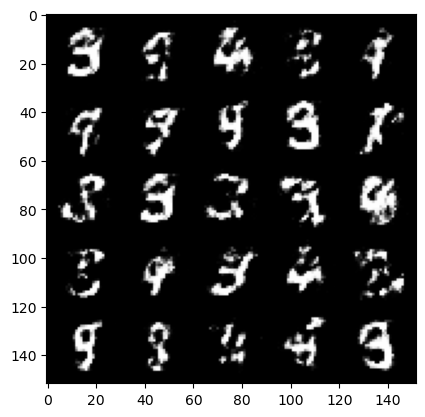

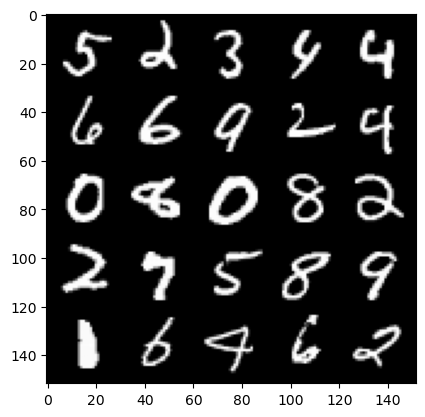

 96%|█████████▌| 450/469 [00:10<00:00, 44.26it/s]

Step 90500: Generator loss: 1.487551362037657, discriminator loss: 0.43798155182600035


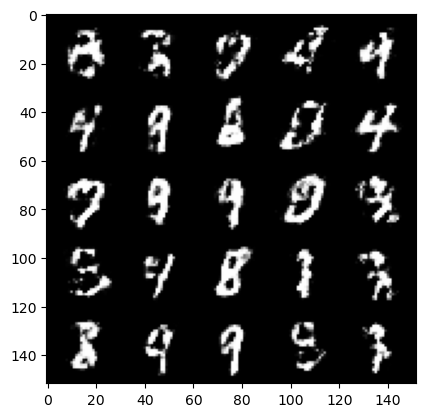

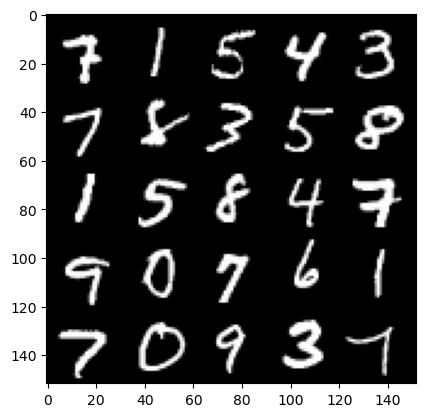

  2%|▏         | 10/469 [00:00<00:10, 43.92it/s]

Step 91000: Generator loss: 1.4545331912040715, discriminator loss: 0.4464469069242478


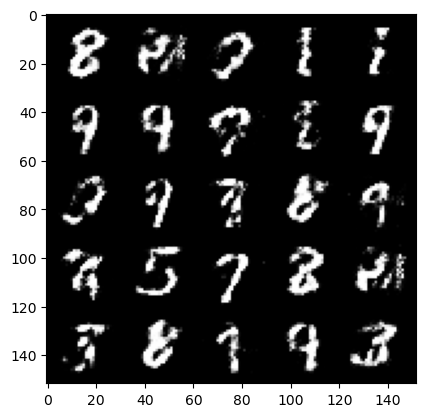

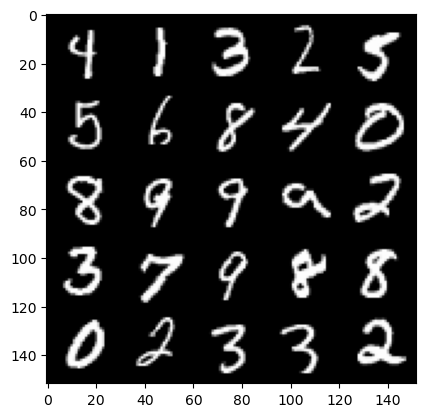

 10%|▉         | 45/469 [00:01<00:09, 44.28it/s]

Step 91500: Generator loss: 1.4252391073703758, discriminator loss: 0.44809935677051543


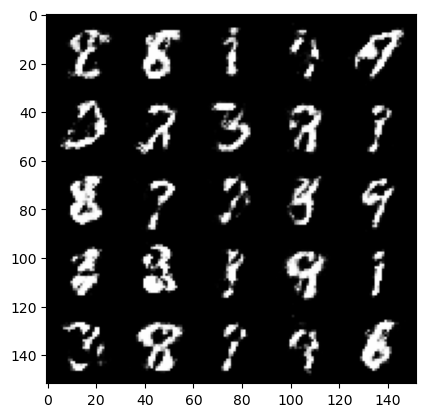

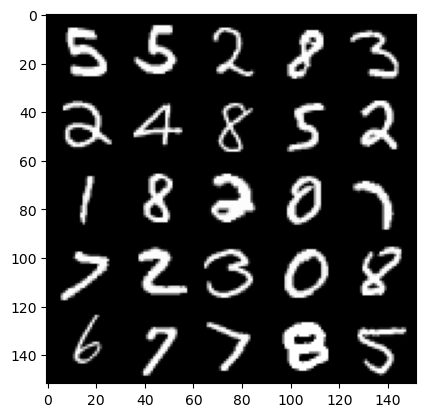

 16%|█▌        | 75/469 [00:01<00:08, 45.37it/s]

Step 92000: Generator loss: 1.4676405291557315, discriminator loss: 0.4228250827193261


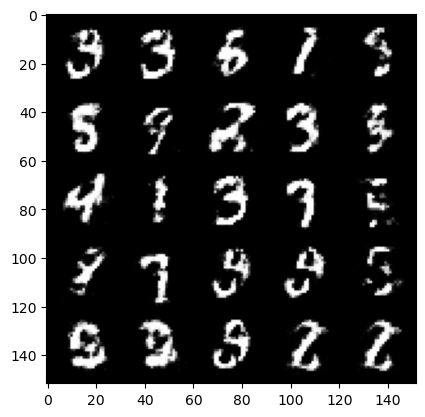

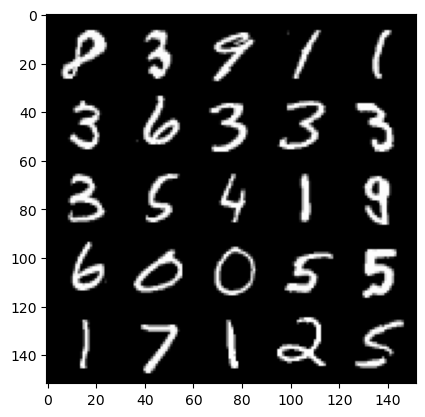

 22%|██▏       | 105/469 [00:02<00:08, 44.69it/s]

Step 92500: Generator loss: 1.5122823429107668, discriminator loss: 0.4198658021092415


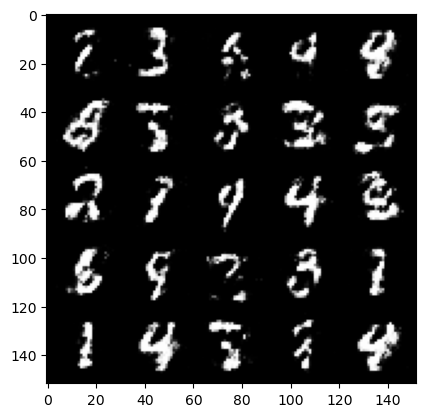

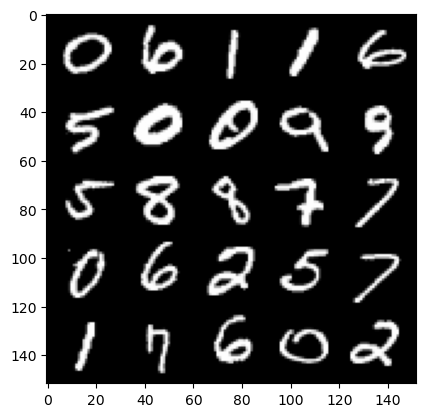

 29%|██▉       | 135/469 [00:03<00:07, 44.91it/s]

Step 93000: Generator loss: 1.4940437903404244, discriminator loss: 0.4222062786221503


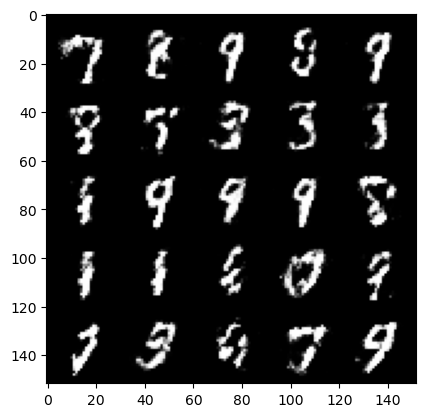

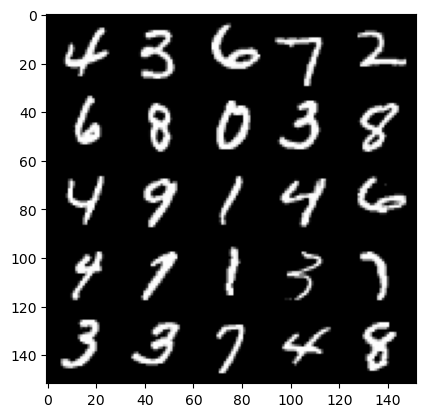

 35%|███▌      | 165/469 [00:03<00:06, 44.51it/s]

Step 93500: Generator loss: 1.3903846149444594, discriminator loss: 0.457263056099415


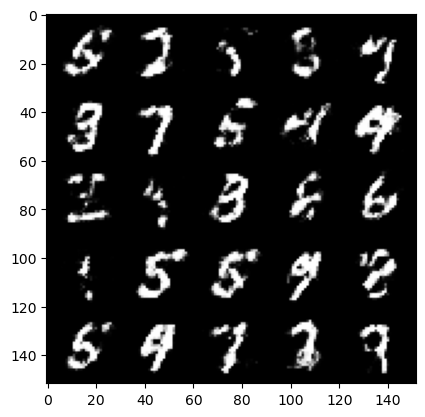

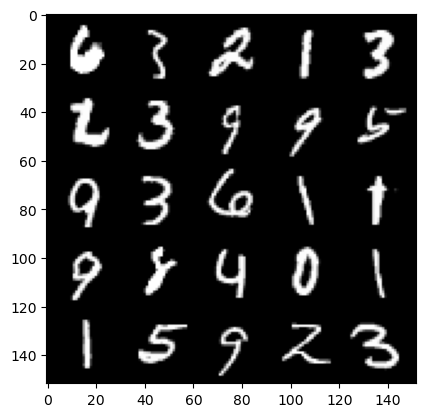

100%|██████████| 469/469 [00:11<00:00, 41.56it/s]


In [22]:
# C8: Completa el código donde corresponde:

cur_step = 0
mean_generator_loss = 0
mean_discriminator_loss = 0
test_generator = True # Whether the generator should be tested
gen_loss = False
error = False
for epoch in range(n_epochs):

    # Dataloader returns the batches
    for real, _ in tqdm(dataloader):
        cur_batch_size = len(real)

        # Flatten the batch of real images from the dataset
        real = real.view(cur_batch_size, -1).to(device)

        ### Update discriminator ###
        # Zero out the gradients before backpropagation
        disc_opt.zero_grad()

        # Calculate discriminator loss
        disc_loss = get_disc_loss(gen, disc, criterion, real, cur_batch_size, z_dim, device)

        # Update gradients
        disc_loss.backward(retain_graph=True)

        # Update optimizer
        disc_opt.step()

        # For testing purposes, to keep track of the generator weights
        if test_generator:
            old_generator_weights = gen.gen[0][0].weight.detach().clone()

        ### Update generator ###
        #     Hint: This code will look a lot like the discriminator updates!
        #     These are the steps you will need to complete:
        #       1) Zero out the gradients.
        #       2) Calculate the generator loss, assigning it to gen_loss.
        #       3) Backprop through the generator: update the gradients and optimizer.
        #### START CODE HERE ####
        gen_opt.zero_grad()
        gen_loss = get_gen_loss(gen, disc, criterion, cur_batch_size, z_dim, device)
        gen_loss.backward()
        gen_opt.step()
        #### END CODE HERE ####

        # For testing purposes, to check that your code changes the generator weights
        if test_generator:
            try:
                assert lr > 0.0000002 or (gen.gen[0][0].weight.grad.abs().max() < 0.0005 and epoch == 0)
                assert torch.any(gen.gen[0][0].weight.detach().clone() != old_generator_weights)
            except:
                error = True
                print("Runtime tests have failed")

        # Keep track of the average discriminator loss
        mean_discriminator_loss += disc_loss.item() / display_step

        # Keep track of the average generator loss
        mean_generator_loss += gen_loss.item() / display_step

        ### Visualization code ###
        if cur_step % display_step == 0 and cur_step > 0:
            print(f"Step {cur_step}: Generator loss: {mean_generator_loss}, discriminator loss: {mean_discriminator_loss}")
            fake_noise = get_noise(cur_batch_size, z_dim, device=device)
            fake = gen(fake_noise)
            show_tensor_images(fake)
            show_tensor_images(real)
            mean_generator_loss = 0
            mean_discriminator_loss = 0
        cur_step += 1


Si la red empieza a entrenar es que tu código está correcto y funciona, ya que se comprueban que los pesos vayan cambiando en cada iteración.


### Enhorabuena!

## Referencias




+ Notebook basado en ejercicios de [DeepLearning.AI](https://www.deeplearning.ai/)
+ Documentación de [PyTorch](https://pytorch.org/docs/stable/index.html)

# EOF